In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

/tmp/ipykernel_275041/3777615979.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [2]:
# IMPORT
import numpy as np
import numpy.ma as ma
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
from netCDF4 import Dataset
import cartopy.crs as ccrs
from cartopy.util import add_cyclic_point
import xarray as xr
import glob
from datetime import datetime, timedelta
from numba import jit
import seaborn as sns


@jit()
def rms(true,prediction):
    return np.sqrt(np.nanmean((prediction-true)**2))

@jit()
def mean_error(true,prediction):
    return np.nanmean((prediction-true))

@jit()
def rms_tendency(variable,hours):
    variable_tendency = np.zeros((hours))
    variable = np.exp(variable) * 1000.0
    for i in range(hours):
        variable_tendency[i] = np.sqrt(np.mean((variable[i+1] - variable[i])**2.0))
    return variable_tendency

def latituded_weighted_rmse(true,prediction,lats):
    diff = prediction-true
#     print(diff[0][0])
    weights = np.cos(np.deg2rad(lats))
#     print(weights[0])
    weights2d = np.zeros(np.shape(diff))
    diff_squared = diff**2.0
    #weights = np.ones((10,96))
    weights2d = np.tile(weights,(96,1))
    weights2d = np.transpose(weights2d)
    masked = np.ma.MaskedArray(diff_squared, mask=np.isnan(diff_squared))
    weighted_average = np.ma.average(masked,weights=weights2d)
    return np.sqrt(weighted_average)

def latituded_weighted_mean_error(true,prediction,lats):
    diff = prediction-true
#     print(diff[0])
    weights = np.cos(np.deg2rad(lats))
#     print(weights[0])
    weights2d = np.zeros(np.shape(diff))
    diff_squared = diff
    #weights = np.ones((10,96))
    weights2d = np.tile(weights,(96,1))
    weights2d = np.transpose(weights2d)
#     print(weights2d)
    masked = np.ma.MaskedArray(diff_squared, mask=np.isnan(diff_squared))
#     print(masked[0])
    weighted_average = np.ma.average(masked,weights=weights2d)
#     print(weighted_average)
    return weighted_average


In [7]:
## MAIN SCRIPT
## **** CHANGE FILES AND DATES HERE

def rmse_time_series_plot_and_maps(level_in_speedy,variable_speedy,input_point): 
    # Define: Initial FILES, dates, Variable, and Level desired

#     analysis_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/40member_speedy_covar1_3_20110101_20120901/mean.nc'
#     analysis_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/speedy_cov_1_3_40MEM_individual_ens_member_20110101_20110601/mean_output/out.nc'
#     analysis_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/40member_speedy_covar1_3_20110101_20120901/mean.nc'

    analysis_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/speedy_cov_1_3_40MEM_individual_ens_member_20110101_20110601/mean_output/out.nc'
    gues_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/speedy_cov_1_3_40MEM_individual_ens_member_20110101_20110601/mean_output_gues/out.nc'

    #/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/hybrid_1_9_1_9_1_9_2nd_inter_20110101_20110924/mean_output
    '''
    
    ANAL and GUES
    
    '''
    ### ERA5  
    analysis_file = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/ERA5_1_3_6hr_timestep_1_24_24_20110101_20120101/mean_output/out.nc'
    gues_file = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/ERA5_1_3_6hr_timestep_1_24_24_20110101_20120101/mean_output_gues/out.nc'

    
    spread_file_ERA5 = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/ERA5_1_3_6hr_timestep_1_24_24_20110101_20120101/sprd_output/out.nc'
    
    
    spread_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/speedy_cov_1_3_40MEM_individual_ens_member_20110101_20110601/sprd_output/out.nc'
#     spread_file_speedy = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/40member_speedy_covar1_3_20110101_20120901/sprd.nc' 
    
    # SPREAD FILES
    ds_spread_ERA5 = xr.open_dataset(spread_file_ERA5)
    ds_spread_speedy = xr.open_dataset(spread_file_speedy)
    

    start_year = 2011
    end_year = 2011

    startdate = datetime(2011,1,1,0)
    enddate = datetime(2011,2,1,0)
    time_slice = slice(startdate,enddate)

    #level = 0.95 #0.2#0.95#0.51
    #level_era = 7 #2#7 #4
    
    level = level_in_speedy
    if level_in_speedy == .95:
        level_in_era = 7
    if level_in_speedy == .2:
        level_in_era = 2
    level_era = level_in_era

    var_da = variable_speedy
    if variable_speedy == 'q':
        variable_era = 'Specific_Humidity'
    if variable_speedy == 't':
        variable_era = 'Temperature'
    if variable_speedy == 'v':
        variable_era = 'V-wind'
    if variable_speedy == 'u':
        variable_era = 'U-wind'
#     var_era = variable_era
    print(variable_era)
    var_era = variable_era

    #### points = ['ocean_west_of_mexico','land_mexico','ocean_west_of_africa','land_africa','persian_gulf']

    points_on_speedy_grid = {
    'ocean_west_of_mexico': (66, 27),  #66 , 27 (it was 65,29)
    'land_mexico': (71, 27), # 71, 27 (it was 71,29)
    'ocean_west_of_africa': (0, 20), # 0, 20 
    'land_africa': (5, 20), # 5,20 (it was 4,20 i think)
    'persian_gulf': (13, 30),# 13, 30 it was (14,31)
    'gulf_of_alaska': (55,37)} 

    point = input_point  
    
    if input_point in points_on_speedy_grid:
        i_point, j_point = points_on_speedy_grid[point]
        print('point selected was: ',input_point)
        print("Coordinates:", i_point, j_point)
    else:
        print("Point not found")


    #var_era = 'V-wind'#'Specific_Humidity'#'Temperature' #'V-wind'
    #var_da =  'v'#'q'#'t'#'v'
    print('you selected for variable =',var_era)
    print('at level =',level)
    timestep_6hrly = 6
    
    # Calculate the number of timesteps for the enddate because stupid ERA5 dataset cannot use length
    
    num_timesteps = int((enddate - startdate).days * 24 / 6) + 1 # 6-hour timestep
    print('number of timesteps i found.. ',num_timesteps)
    # create empty list to store indiviudal datasets
    era5sets = []
    print('made it to the for loop...')

    # LOAD DATA HERE 
    print('LOADING DATA...')

    # loop over the range of years and open each ds
    for year in range(start_year, end_year + 1):
        nature_file = f'/skydata2/troyarcomano/ERA_5/{year}/era_5_y{year}_regridded_mpi_fixed_var.nc'
        # only load var_era selected and only load level_era selected from above
        ds_nature = xr.open_dataset(nature_file)[var_era].sel(Sigma_Level=level_era)
        # Read in every 6th timestep
        ds_nature = ds_nature.isel(Timestep=slice(None, None, timestep_6hrly))
        era5sets.append(ds_nature)
    
    print('Now its concatinating them all together...')

    ds_nature = xr.concat(era5sets, dim = 'Timestep')
    ds_nature = ds_nature.sortby('Timestep')
    print('Done concat and sortby Timestep...')
    
    ds_nature = ds_nature.isel(Timestep = slice(0,num_timesteps))


    ds_analysis_mean = xr.open_dataset(analysis_file)[var_da].sel(lev=level,time=time_slice)
    ds_analysis_mean_speedy = xr.open_dataset(analysis_file_speedy)[var_da].sel(lev=level,time=time_slice)
    
    
    #### GUESS FILES HERE
    ds_gues_mean = xr.open_dataset(gues_file)[var_da].sel(lev=level,time=time_slice)
    ds_gues_mean_speedy = xr.open_dataset(gues_file_speedy)[var_da].sel(lev=level,time=time_slice)
    
    #####
    

    temp_500_analysis = ds_analysis_mean
    # temp_500_analysis = ds_analysis_mean[var_da].sel(lev=level).values
    temp_500_analysis_speedy = ds_analysis_mean_speedy
    # temp_500_analysis_speedy = ds_analysis_mean_speedy[var_da].sel(lev=level,time=time_slice).values
    
    temp_500_nature = ds_nature.values
    temp_500_spread_era5 = ds_spread_ERA5[var_da].sel(lev=level).values
    temp_500_spread_speedy = ds_spread_speedy[var_da].sel(lev=level).values

    print('era5 shape = ',np.shape(ds_nature))
    print('speedy shape = ',np.shape(temp_500_analysis_speedy))
    print('hybrid shape = ',np.shape(temp_500_analysis))

    #find smallest index value to set that as the "length"
    speedy_index = temp_500_analysis_speedy.shape[0]
    print('speedy_index ', speedy_index)
    nature_index = temp_500_nature.shape[0]
    print('nature_index ', nature_index)
    hybrid_index = temp_500_analysis.shape[0]
    print('hybrid_index ', hybrid_index)
    
    smallest_index = min(speedy_index,nature_index,hybrid_index)

    if smallest_index == speedy_index:
        length = speedy_index #- 1
    elif smallest_index == nature_index:
        length = nature_index
    else:
        length = hybrid_index
    print('the smallest length is',length)

    #ps_nature = ds_nature['logp'].values
    #ps_nature = 1000.0 * np.exp(ps_nature)
    #ps_analysis = ds_analysis_mean['ps'].values/100.0

    
    xgrid = 96
    ygrid = 48
    #length = 365*4*2 #1952-7 # 240 for 3 months  #1450 ##338 #160#64#177#1400#455

    analysis_rmse = np.zeros((length))
    analysis_rmse_speedy = np.zeros((length))
    global_average_ensemble_spread_era5 = np.zeros((length))
    global_average_ensemble_spread_speedy = np.zeros((length))
    #ps_rmse = np.zeros((length))
    
    gues_rmse = np.zeros((length))
    gues_rmse_speedy = np.zeros((length))

    analysis_error = np.zeros((length,ygrid,xgrid))
    analysis_error_speedy = np.zeros((length,ygrid,xgrid))
    
    #point
    analysis_rmse_point = np.zeros((length))
    analysis_rmse_speedy_point = np.zeros((length))
    gues_rmse_point = np.zeros((length))
    gues_rmse_speedy_point = np.zeros((length))
    
    
    print(np.shape(analysis_error))
    print(np.shape(analysis_error_speedy))

    print('Now its calculating analysis RMSE...')
    lats = ds_nature.Lat
    
    # need j_point and i_point defined
    # i is timestep index
    
    for i in range(length):
        
        #global average
        analysis_rmse[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],temp_500_analysis[i,:,:],lats)
        analysis_rmse_speedy[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],temp_500_analysis_speedy[i,:,:],lats)
        gues_rmse[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],ds_gues_mean[i,:,:],lats)
        gues_rmse_speedy[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],ds_gues_mean_speedy[i,:,:],lats)
        
        # point rms
        analysis_rmse_point[i] = mean_error(temp_500_nature[i,j_point,i_point],temp_500_analysis[i,j_point,i_point])
        analysis_rmse_speedy_point[i] = mean_error(temp_500_nature[i,j_point,i_point],temp_500_analysis_speedy[i,j_point,i_point])
        gues_rmse_point[i] = mean_error(temp_500_nature[i,j_point,i_point],ds_gues_mean[i,j_point,i_point])
        gues_rmse_speedy_point[i] = mean_error(temp_500_nature[i,j_point,i_point],ds_gues_mean_speedy[i,j_point,i_point])
        
        
        #ps_rmse[i] = rms(ps_nature[i*6,:,:],ps_analysis[i,:,:])
#         analysis_error[i,:,:] = temp_500_analysis[i,:,:] - temp_500_nature[i,:,:]
#         analysis_error_speedy[i,:,:] = temp_500_analysis_speedy[i,:,:] - temp_500_nature[i,:,:]
        
#         global_average_ensemble_spread_era5[i] = np.average(temp_500_spread_era5[i,:,:])
#         global_average_ensemble_spread_speedy[i] = np.average(temp_500_spread_speedy[i,:,:])

    # print('mean analysis_rmse = ',analysis_rmse)

    print('DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..')

    
    #### HYBRID NEW 1_9_1_9_1_9
    hybrid_base_path = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/hybrid_1_9_1_9_1_9_2nd_inter_20110101_20110924/'#/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/hybrid_1_3_1_3_original_weights_20110101_20120101/'
    
    #/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/hybrid_1_9_1_9_1_9_2nd_inter_20110101_20110924/mean_output
    
    ### HYBRID 1_9_1_9
    
    hybrid_base_path_1_9_1_9 = '/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/hybrid_1_9_1_9_test_128_procs_from_grace_20110101_20110402/'
    
    #/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/uniform_letkf_anal/hybrid_1_9_1_9_1_9_2nd_inter_20110101_20110924/mean_output
    # Define the variable name, level, and time slice
    start_year = 2011
    end_year = 2011

    # startdate = datetime(2011,1,1,0)
    # enddate = datetime(2011,6,1,0)
    time_slice = slice(startdate,enddate)

    # level = 0.95 #0.2#0.95#0.51
    # level_era = 7 #2#7 #4

    # var_era = 'Temperature'#'Specific_Humidity'#'Temperature' #'V-wind'
    # var_da =  't'#'q'#'t'#'v'
    print('you selected for variable =',var_era)
    print('at level =',level)
    
    ## ADDING MEAN of Hybrid
    path_mean_anal_hybrid_retest = hybrid_base_path + 'mean_output/out.nc'
    ds_mean_anal_hybrid_1_9_1_9_1_9 = xr.open_dataset(path_mean_anal_hybrid_retest)[var_da].sel(lev=level, time=time_slice)
    ## ADD GUES
    path_mean_gues_hybrid_retest = hybrid_base_path + 'mean_output_gues/out.nc'
    ds_mean_gues_hybrid_1_9_1_9_1_9 = xr.open_dataset(path_mean_gues_hybrid_retest)[var_da].sel(lev=level, time=time_slice)
    
    
    ## ADD MEAN AND GUES OF 1.5 Hybrid
    path_mean_anal_hybrid_1_9_1_9 = hybrid_base_path_1_9_1_9 + 'mean_output/out.nc'
    ds_mean_anal_hybrid_1_9_1_9 = xr.open_dataset(path_mean_anal_hybrid_1_9_1_9)[var_da].sel(lev=level, time=time_slice)
    path_mean_gues_hybrid_1_9_1_9 = hybrid_base_path_1_9_1_9 + 'mean_output_gues/out.nc'
    ds_mean_gues_hybrid_1_9_1_9 = xr.open_dataset(path_mean_gues_hybrid_1_9_1_9)[var_da].sel(lev=level, time=time_slice)
    
    


    lats = ds_nature.Lat

    # analysis_error is for maps, see its a 3d array, 
    # MAKING analysis_rmse now

    print('MAKING zeros arrays..')
#     quantity_of_ens_members = 40
#     analysis_rmse_object = np.zeros((quantity_of_ens_members, length))
    
#     anal_rmse_troy = np.zeros((length))
#     anal_error_troy = np.zeros((length,ygrid,xgrid))
    # THIS IS 1_9_1_9_1_9
    anal_mean_error_hybrid_1_3_1_3 = np.zeros((length,ygrid,xgrid))
    anal_mean_rmse_hybrid_1_3_1_3 = np.zeros((length))
    gues_mean_rmse_hybrid_1_3_1_3 = np.zeros((length))
    anal_mean_rmse_hybrid_1_3_1_3_point = np.zeros((length))
    gues_mean_rmse_hybrid_1_3_1_3_point = np.zeros((length))
    #add 1.9,1.9
    
    anal_mean_rmse_hybrid_1_9_1_9 = np.zeros((length))
    gues_mean_rmse_hybrid_1_9_1_9 = np.zeros((length))
    anal_mean_rmse_hybrid_1_9_1_9_point = np.zeros((length))
    gues_mean_rmse_hybrid_1_9_1_9_point = np.zeros((length))
    


    print('Done with ensemble analysis (if any).')
    
    #########################################################
    # MAKE MAP FROM ABOVE 

    ''' 24(below) instead of 28 to cut transient event (ML spin up) out in first few weeks '''


#     ''' Multiply averaged_error by 1000 for spec_humid only'''

    if var_era == 'Temperature':
        units='(K)'
    if var_era == 'Specific_Humidity':
        units='(g/kg)'
    if var_era == 'V-wind':
        units='(m/s)'
    if var_era == 'U-wind':
        units='(m/s)'
    print(units)
    if level == .95:
        title_level = 'Low Level '
    if level == .2:
        title_level = '200 hPa '

    if var_era == 'Specific_Humidity':
        title_var_era = 'Specific Humidity'
    if var_era == 'V-wind':
        title_var_era = "Meridional Wind"
    if var_era == 'Temperature':
        title_var_era = 'Temperature'
    if var_era == 'U-wind':
        title_var_era = 'Zonal Wind'
    print(title_var_era)


    fs = 16
    

    
#     #####################################
    print('looping through hybrid 1.3,1.3 ..')
    for i in range(length):
#         anal_error_troy[i,:,:] = ds_anal_troy[i,:,:] - temp_500_nature[i,:,:]
#         anal_rmse_troy[i] = latituded_weighted_rmse(temp_500_nature[i,:,:],ds_anal_troy[i,:,:],lats)

#         anal_mean_error_hybrid_1_3_1_3[i,:,:] = ds_mean_anal_hybrid_1_9_1_9_1_9[i,:,:] - temp_500_nature[i,:,:]
        anal_mean_rmse_hybrid_1_3_1_3[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],ds_mean_anal_hybrid_1_9_1_9_1_9[i,:,:],lats)
        gues_mean_rmse_hybrid_1_3_1_3[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],ds_mean_gues_hybrid_1_9_1_9_1_9[i,:,:],lats)
        
        anal_mean_rmse_hybrid_1_3_1_3_point[i] = mean_error(temp_500_nature[i,j_point,i_point],ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point])
        gues_mean_rmse_hybrid_1_3_1_3_point[i] = mean_error(temp_500_nature[i,j_point,i_point],ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point])
        
        # Add hybrid 1.9,1.9
        anal_mean_rmse_hybrid_1_9_1_9[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],ds_mean_anal_hybrid_1_9_1_9[i,:,:],lats)
        gues_mean_rmse_hybrid_1_9_1_9[i] = latituded_weighted_mean_error(temp_500_nature[i,:,:],ds_mean_gues_hybrid_1_9_1_9[i,:,:],lats)
        
        anal_mean_rmse_hybrid_1_9_1_9_point[i] = mean_error(temp_500_nature[i,j_point,i_point],ds_mean_anal_hybrid_1_9_1_9[i,j_point,i_point])
        gues_mean_rmse_hybrid_1_9_1_9_point[i] = mean_error(temp_500_nature[i,j_point,i_point],ds_mean_gues_hybrid_1_9_1_9[i,j_point,i_point])
        

    
    # code for plot every ensemble member

    # MAKE TIME SERIES for each ensemble member
    
    x = np.arange(0,length)
    base = datetime(2011,1,1,0)

    plt.figure(figsize=(12,6))
    date_list = [base + timedelta(days=x/4) for x in range(length)]
    
    width = 1
    

    if var_era == 'Specific_Humidity':
        # convert (kg/kg) to (g/kg) 
        variables_to_multiply = [analysis_rmse, analysis_rmse_speedy,
                                 gues_rmse, gues_rmse_speedy, 
                                 analysis_rmse_point, analysis_rmse_speedy_point,
                                 gues_rmse_point, gues_rmse_speedy_point,
                                 anal_mean_rmse_hybrid_1_3_1_3, gues_mean_rmse_hybrid_1_3_1_3,
                                 anal_mean_rmse_hybrid_1_3_1_3_point, gues_mean_rmse_hybrid_1_3_1_3_point,
                                 anal_mean_rmse_hybrid_1_9_1_9, gues_mean_rmse_hybrid_1_9_1_9,
                                 anal_mean_rmse_hybrid_1_9_1_9_point, gues_mean_rmse_hybrid_1_9_1_9_point]
        
        variables_to_multiply = [variable * 1000 for variable in variables_to_multiply]
        (analysis_rmse, analysis_rmse_speedy,
         gues_rmse, gues_rmse_speedy, 
         analysis_rmse_point, analysis_rmse_speedy_point,
         gues_rmse_point, gues_rmse_speedy_point,
         anal_mean_rmse_hybrid_1_3_1_3, gues_mean_rmse_hybrid_1_3_1_3,
         anal_mean_rmse_hybrid_1_3_1_3_point, gues_mean_rmse_hybrid_1_3_1_3_point,
         anal_mean_rmse_hybrid_1_9_1_9, gues_mean_rmse_hybrid_1_9_1_9,
         anal_mean_rmse_hybrid_1_9_1_9_point, gues_mean_rmse_hybrid_1_9_1_9_point) = variables_to_multiply
        

    
    # HYBRID + truth ONLY -> plot of guess to analysis (Shows DA)
    plt.figure(figsize=(12,6))
    if var_era == 'Specific_Humidity':
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]*1000],color='red', label='Speedy trained Hybrid 6-hr Prediction' if i == 0 else None)
        plt.plot(date_list, ds_nature[:,j_point,i_point]*1000, label = 'Truth', color = 'maroon')
    
    # 606 and 1457
    else: 
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]],color='red', label='Speedy trained Hybrid 6-hr Prediction 1.9,1.9,1.9' if i == 0 else None)
        plt.plot(date_list, ds_nature[:,j_point,i_point], label = 'Truth', color = 'maroon')
        
#     plt.ylim(9, 15)
    plt.ylabel('Specific Humidity (g/kg)', fontsize = fs)
    
    plt.xlim([startdate,enddate])
    plt.xlabel('Date',fontsize = fs)
    
    plt.title('LETKF Background and Analysis Values\n'+ title_level + title_var_era +' at gridpoint: '+ input_point,fontsize = fs)
    plt.grid(color='grey', linestyle='--', linewidth=.5)
    plt.legend()
    plt.show()
    
    # HYBRID + Friends -> plot of guess to analysis (SHOWS DA)
    plt.figure(figsize=(12,6))
    if var_era == 'Specific_Humidity':
        # speedy Hybrid
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]*1000],color='red', label='Speedy trained Hybrid 6-hr Prediction 1.9,1.9,1.9' if i == 0 else None)
        # SPeedy
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_analysis_mean_speedy[i,j_point,i_point]*1000, ds_gues_mean_speedy[i,j_point,i_point]*1000],color='black') # No label
        for i in range(length-1): 
            plt.plot([date_list[i],date_list[i+1]],[ds_analysis_mean_speedy[i,j_point,i_point]*1000, ds_gues_mean_speedy[i+1,j_point,i_point]*1000],color='blue', label='Speedy 6-hr Prediction' if i == 0 else None)
        #ERA5 hybrid
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_analysis_mean[i,j_point,i_point]*1000, ds_gues_mean[i,j_point,i_point]*1000],color='black') # No label
        for i in range(length-1): 
            plt.plot([date_list[i],date_list[i+1]],[ds_analysis_mean[i,j_point,i_point]*1000, ds_gues_mean[i+1,j_point,i_point]*1000],color='purple', label='ERA5 trained Hybrid 6-hr Prediction' if i == 0 else None)
        # Truth
        plt.plot(date_list, ds_nature[:,j_point,i_point]*1000, label = 'Truth', color = 'maroon')
#         plt.axhspan((ds_nature[:,j_point,i_point]*1000) - 1, (ds_nature[:,j_point,i_point]*1000) + 1, alpha=0.3, color='gray')

    else: 
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]],color='red', label='Hybrid 1.9,1.9,1.9 6 hr Prediction' if i == 0 else None)
        plt.plot(date_list, ds_nature[:,j_point,i_point], label = 'Truth', color = 'maroon')
        
#     plt.ylim(9, 15)
    plt.ylabel('Specific Humidity (g/kg)', fontsize = fs)
    plt.yticks(fontsize=12)
    
#     plt.xlim([datetime(2011,3,1,0),datetime(2011,3,12,0)])
    plt.xlabel('Date',fontsize = fs)
    plt.xticks(fontsize=10)
    plt.grid(color='grey', linestyle='--', linewidth=.5)
    plt.title('LETKF Background and Analysis Values\n'+ title_level + title_var_era +' at gridpoint: '+ input_point,fontsize = fs)
    plt.legend()
    plt.show()
    
    
    
    # all script for run in another script
    #packages
    from glob import glob
    import cartopy.crs as ccrs

    # Glob observation files
    files = sorted(glob('/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/*.dat'))

    # LOOP THROUGH ALL FILES in obs_netcdftest


    # Define model state dimensions
    ntime, nlat, nlon, nlev = len(files), 48, 96, 8

    # Define fields
    fields = [
        {'id': 14593, 'name': 'Surface Pressure [Pa]', 'short': 'ps'},
        {'id': 2819, 'name': 'U-wind [m/s]', 'short': 'u'},
        {'id': 2820, 'name': 'V-wind [m/s]', 'short': 'v'},
        {'id': 3073, 'name': 'Temperature [K]', 'short': 't'},
        {'id': 3330, 'name': 'Specific Humidity [kg/kg]', 'short': 'q'}
    ]

    # Get Gaussian latitudes from GrADS control file
    with open('/skydata2/dylanelliott/letkf-hybrid-speedy/common/t30.ctl') as f:
        content = f.readlines()[5]
        lats = [np.float32(lat) for lat in content.split()[3:]]
        lats_py = [float(lat) for lat in content.split()[3:]]

    # Define longitudes
    lons = np.arange(0, 360, 3.75)

    # Define sigma coordinates
    sigmas = [0.95, 0.835, 0.685, 0.51, 0.34, 0.2, 0.095, 0.025]

    # define empty array to save each timestep's array in there for below loop
    obs_all_timesteps = []

    # Loop over all observation files (each one represents one set of 6 hourly observations)
    for t, file in enumerate(files):
        print(file)
        print(f'Processing {t+1} of {ntime} timesteps')
        # Read data from file
    #     data = np.reshape(np.fromfile(file, dtype=np.float32).byteswap(), (12064,8))

        data = np.fromfile(file, dtype=np.float32).byteswap()
    #     print(data)
        # Select obs network to read in file
        sparse_network = 12064
        uniform_network = 7250*2

        data = np.reshape(data, (uniform_network,8)) 

        # Delete first and last columns - these are used by FORTRAN to give the number of bytes
        # in between, i.e. the length of a row
        data = np.delete(data, [0,7], axis=1)

        # First process surface pressure
        ps_obs = data[data[:,0] == fields[0]['id']]

        for ob in ps_obs:
            lat_i = np.where(lats == ob[2])[0][0]
            lon_i = np.where(lons == ob[1])[0][0]
            # Convert pressure from hPa to Pa
    #         print(lat_i, lon_i, ob[4] ) # hPa 
    #         cubes[0].data[t, lat_i, lon_i] = 100.0*ob[4]

        # make array to store all 3-d obs
        obs_full = np.zeros((4, 48,96,8))

        # Now process the other fields
        for i, field in enumerate(fields[1:],1):
            # Get all observations of this field
            obs = data[data[:,0] == field['id']]
            counter = 0 

            for ob in obs:
                lat_i = np.where(lats == ob[2])[0][0]
                lon_i = np.where(lons == ob[1])[0][0]
                obs_full[i-1,lat_i,lon_i,counter%8] = ob[4]

    #             print(field, lat_i, lon_i, 100.0*ob[3], ob[4], counter%8)
                counter = counter + 1
        # save newly created local array called obs_full to new array containing length of 1460
        # Append the obs_full array of each timestep to the list
        obs_all_timesteps.append(obs_full)
            # Check if we've reached the desired length
        if t + 1 == length:
            break
                
                
    #             sigma = np.around(100.0*ob[3]/nature_ps.data[t, lat_i, lon_i], decimals=3)
    #             lev_i = np.where(sigmas == sigma)[0][0]

    print(obs_all_timesteps[0][1,:,:,7])
    print(len(obs_all_timesteps))
    print(np.shape(obs_all_timesteps))

    print('correct for 0s in array by adding nans') 
    # Iterate through each element of obs_all_timesteps
    for i in range(len(obs_all_timesteps)):
        obs_all_timesteps[i][obs_all_timesteps[i]==0] = np.nan        
    print(len(obs_all_timesteps))
    print(np.shape(obs_all_timesteps))
    print('Bingo.')
    # make numpy array 
    type(obs_all_timesteps)
    obs_all_timesteps_array = np.array(obs_all_timesteps)
    obs_all_timesteps_array[0]
    print('Done.')


    # OBS + HYBRID + Friends -> plot of guess to analysis (SHOWS DA) - 6 months
    plt.figure(figsize=(12,6))
    if var_era == 'Specific_Humidity':
        # speedy Hybrid 2nd iter
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]*1000],color='red', label='Speedy trained Hybrid 6-hr Prediction 1.9,1.9,1.9' if i == 0 else None)
        # SPeedy
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_analysis_mean_speedy[i,j_point,i_point]*1000, ds_gues_mean_speedy[i,j_point,i_point]*1000],color='black') # No label
        for i in range(length-1): 
            plt.plot([date_list[i],date_list[i+1]],[ds_analysis_mean_speedy[i,j_point,i_point]*1000, ds_gues_mean_speedy[i+1,j_point,i_point]*1000],color='blue', label='Speedy 6-hr Prediction' if i == 0 else None)
        #ERA5 hybrid
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_analysis_mean[i,j_point,i_point]*1000, ds_gues_mean[i,j_point,i_point]*1000],color='black') # No label
        for i in range(length-1): 
            plt.plot([date_list[i],date_list[i+1]],[ds_analysis_mean[i,j_point,i_point]*1000, ds_gues_mean[i+1,j_point,i_point]*1000],color='purple', label='ERA5 trained Hybrid 6-hr Prediction' if i == 0 else None)
        # Truth
        plt.plot(date_list, ds_nature[:,j_point,i_point]*1000, label = 'Truth', color = 'maroon')
#         plt.axhspan((ds_nature[:,j_point,i_point]*1000) - 1, (ds_nature[:,j_point,i_point]*1000) + 1, alpha=0.3, color='gray')

        # speedy Hybrid 1st iter
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9[i,j_point,i_point]*1000],color='black') # no label
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9[i+1,j_point,i_point]*1000],color='green', label='Speedy trained Hybrid 6-hr Prediction 1.9,1.9' if i == 0 else None)
    else: 
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]],color='red', label='Hybrid 1.9,1.9,1.9 6 hr Prediction' if i == 0 else None)
        plt.plot(date_list, ds_nature[:,j_point,i_point], label = 'Truth', color = 'maroon')
    
    #### OBSERVATIONS ####
    for i in range(len(obs_all_timesteps_array)):
        plt.scatter(date_list[i],obs_all_timesteps_array[i][3,j_point,i_point,0]*1000,color='black', s=7, label='Observation' if i == 0 else None)

        #     plt.ylim(9, 15)
    plt.ylabel('Specific Humidity (g/kg)', fontsize = fs)
    plt.yticks(fontsize=12)
    
#     plt.xlim([datetime(2011,3,1,0),datetime(2011,3,12,0)])
    plt.xlabel('Date',fontsize = fs)
    plt.xticks(fontsize=10)
    plt.grid(which='both', color='grey', linestyle='--', linewidth=.5)
    plt.title('LETKF Background and Analysis Values\n'+ title_level + title_var_era +' at gridpoint: '+ input_point,fontsize = fs)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()
    
    
    # OBS + HYBRID + Friends -> plot of guess to analysis (SHOWS DA)
    
    ## # SHORTER TIME WINDOW # ##
    plt.figure(figsize=(12,6))
    if var_era == 'Specific_Humidity':
        # speedy Hybrid 2nd iter
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]*1000],color='red', label='Speedy trained Hybrid 6-hr Prediction 1.9,1.9,1.9' if i == 0 else None)
        # SPeedy
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_analysis_mean_speedy[i,j_point,i_point]*1000, ds_gues_mean_speedy[i,j_point,i_point]*1000],color='black') # No label
        for i in range(length-1): 
            plt.plot([date_list[i],date_list[i+1]],[ds_analysis_mean_speedy[i,j_point,i_point]*1000, ds_gues_mean_speedy[i+1,j_point,i_point]*1000],color='blue', label='Speedy 6-hr Prediction' if i == 0 else None)
        #ERA5 hybrid
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_analysis_mean[i,j_point,i_point]*1000, ds_gues_mean[i,j_point,i_point]*1000],color='black') # No label
        for i in range(length-1): 
            plt.plot([date_list[i],date_list[i+1]],[ds_analysis_mean[i,j_point,i_point]*1000, ds_gues_mean[i+1,j_point,i_point]*1000],color='purple', label='ERA5 trained Hybrid 6-hr Prediction' if i == 0 else None)
        # Truth
        plt.plot(date_list, ds_nature[:,j_point,i_point]*1000, label = 'Truth', color = 'maroon')
#         plt.axhspan((ds_nature[:,j_point,i_point]*1000) - 1, (ds_nature[:,j_point,i_point]*1000) + 1, alpha=0.3, color='gray')
        
        # speedy Hybrid 1st iter
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9[i,j_point,i_point]*1000],color='black') # no label
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9[i,j_point,i_point]*1000, ds_mean_gues_hybrid_1_9_1_9[i+1,j_point,i_point]*1000],color='green', label='Speedy trained Hybrid 6-hr Prediction 1.9,1.9' if i == 0 else None)
    else: 
        for i in range(length):
            plt.plot([date_list[i],date_list[i]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i,j_point,i_point]],color='black', label='Data Assimilation' if i == 0 else None)
        for i in range(length-1):
            plt.plot([date_list[i],date_list[i+1]],[ds_mean_anal_hybrid_1_9_1_9_1_9[i,j_point,i_point], ds_mean_gues_hybrid_1_9_1_9_1_9[i+1,j_point,i_point]],color='red', label='Hybrid 1.9,1.9,1.9 6 hr Prediction' if i == 0 else None)
        plt.plot(date_list, ds_nature[:,j_point,i_point], label = 'Truth', color = 'maroon')
    
    #### OBSERVATIONS ####
    for i in range(len(obs_all_timesteps_array)):
        plt.scatter(date_list[i],obs_all_timesteps_array[i][3,j_point,i_point,0]*1000,color='black', s=7, label='Observation' if i == 0 else None)

        #     plt.ylim(9, 15)
    plt.ylabel('Specific Humidity (g/kg)', fontsize = fs)
    plt.yticks(fontsize=12)
    
    plt.xlim([datetime(2011,1,1,0),datetime(2011,1,15,0)])
    plt.xlabel('Date',fontsize = fs)
    plt.xticks(fontsize=10)
    plt.grid(which='both', color='grey', linestyle='--', linewidth=.5)
    plt.title('LETKF Background and Analysis Values\n'+ title_level + title_var_era +' at gridpoint: '+ input_point,fontsize = fs)
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.show()

Specific_Humidity
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

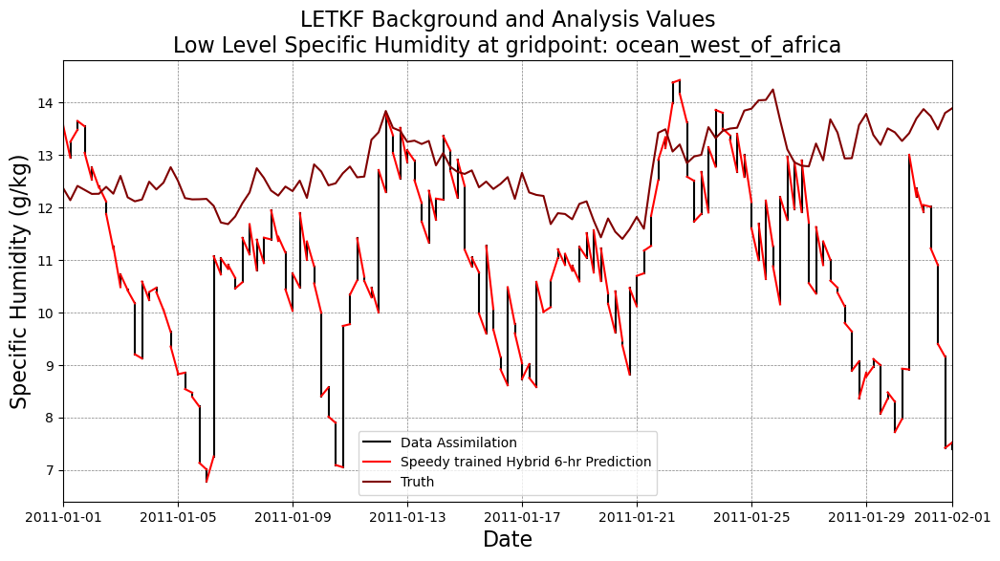

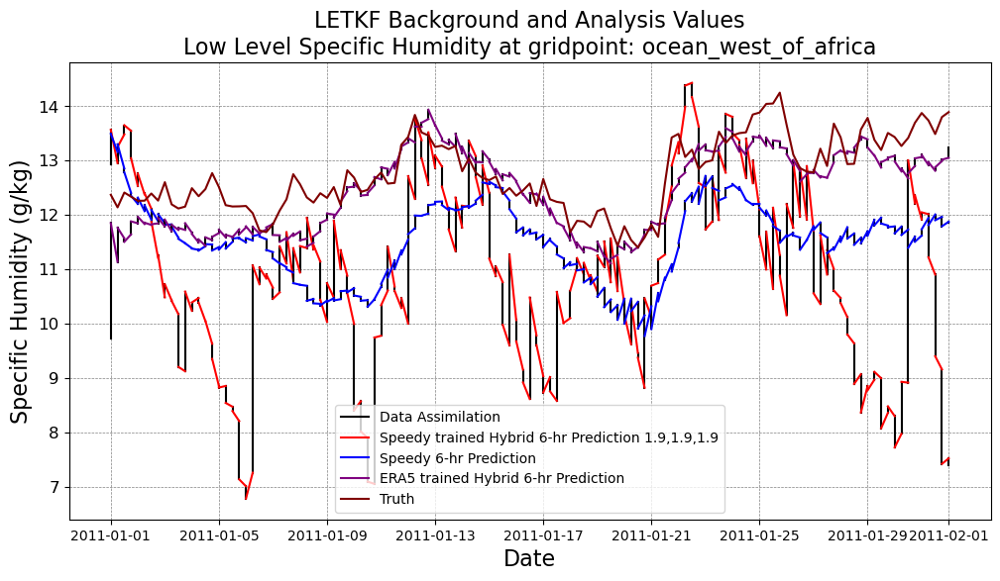

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012206.dat
Processing 86 of 1460 timesteps
/skydata2/

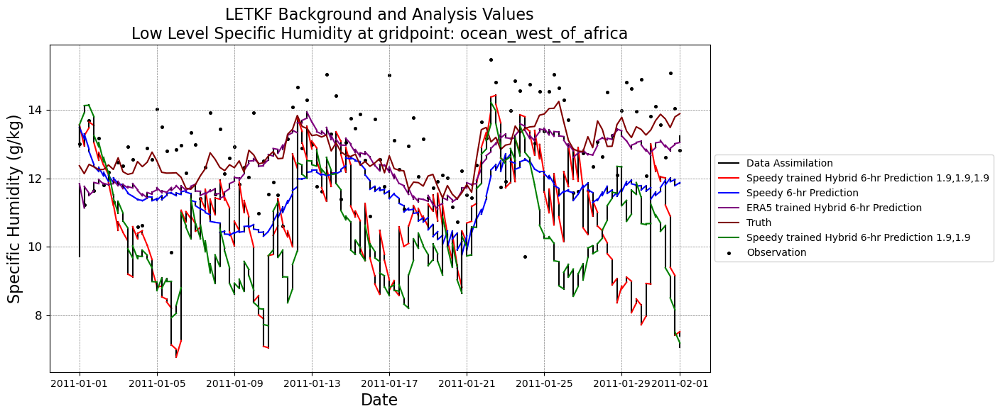

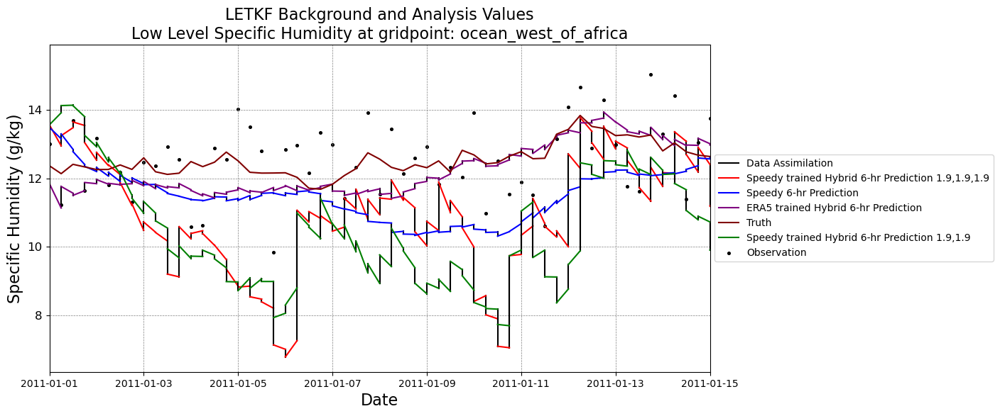

In [8]:
# TEST CELL an individual variable/level combination
# points = ['ocean_west_of_mexico','land_mexico','ocean_west_of_africa','land_africa','persian_gulf']
rmse_time_series_plot_and_maps(.95,'q','ocean_west_of_africa')

Specific_Humidity
point selected was:  gulf_of_alaska
Coordinates: 55 37
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

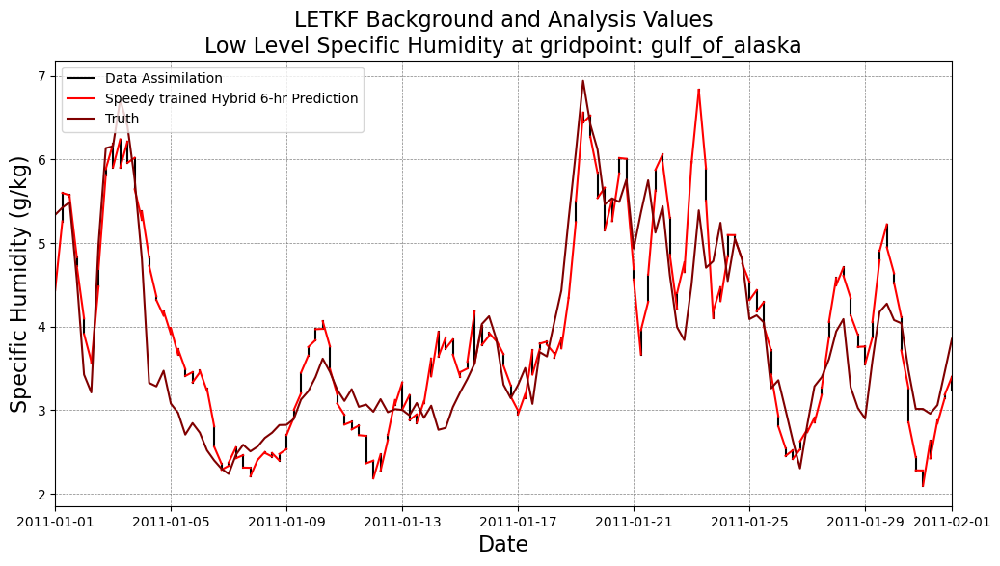

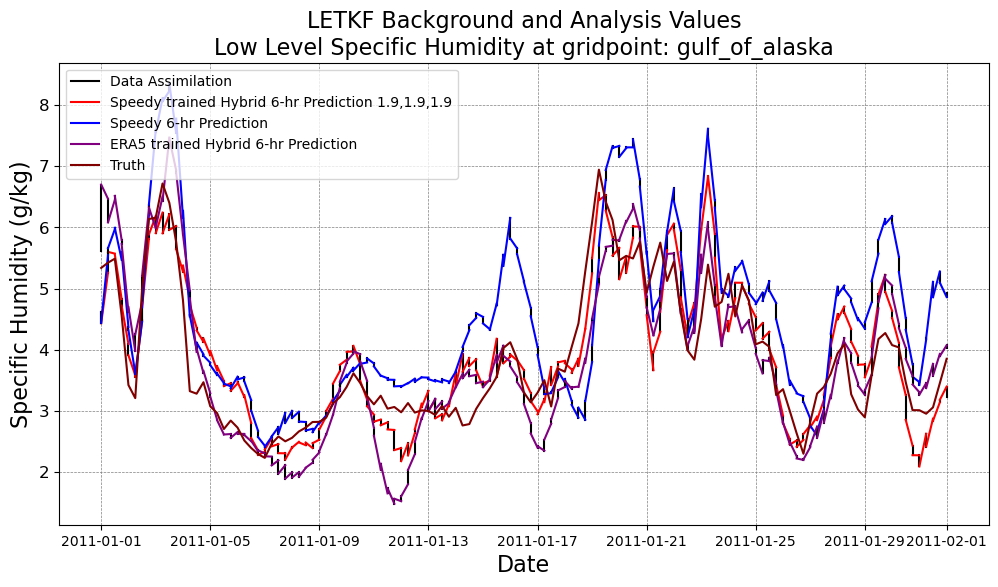

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

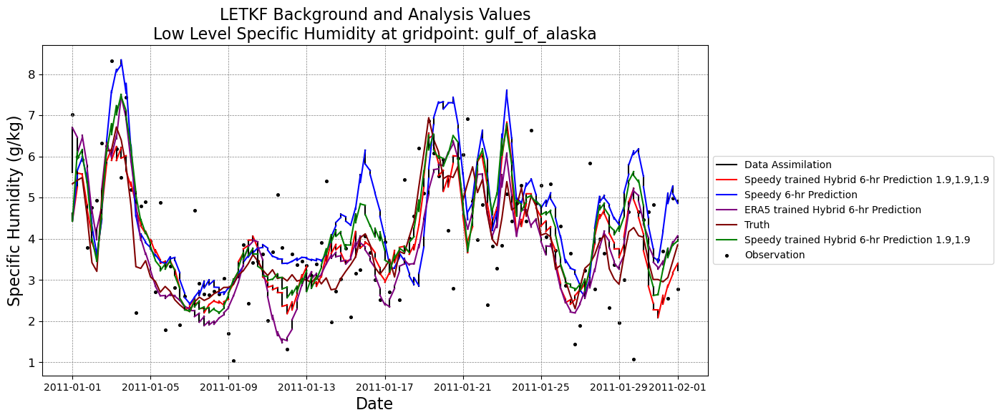

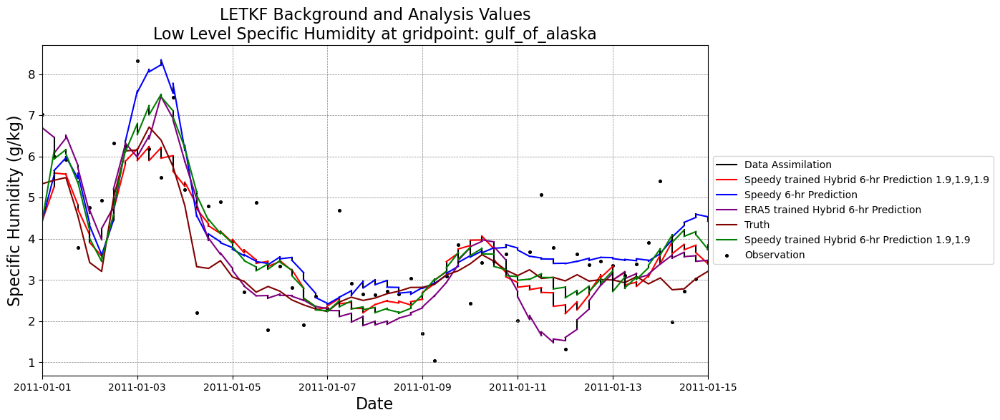

In [10]:
rmse_time_series_plot_and_maps(.95,'q','gulf_of_alaska')

Specific_Humidity
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

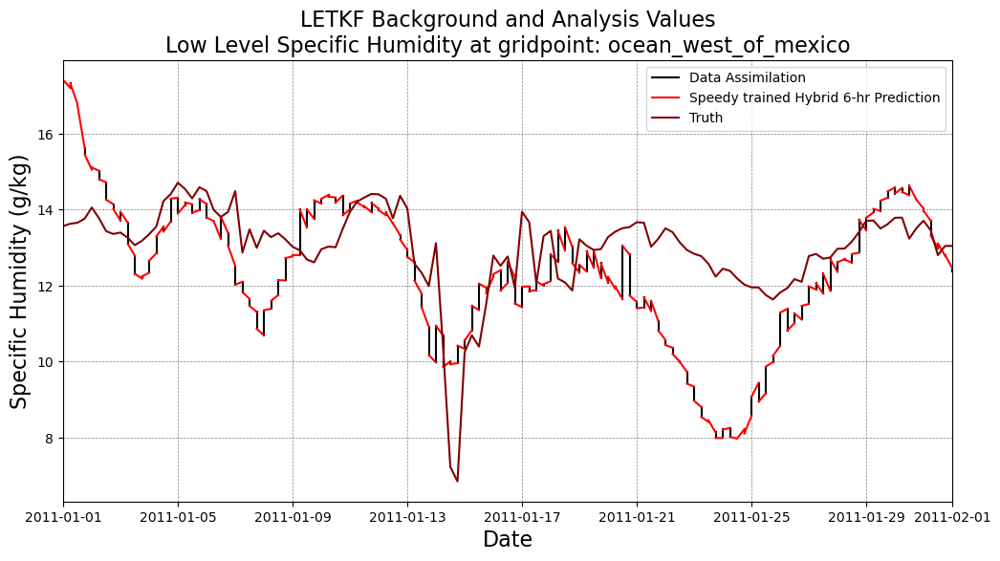

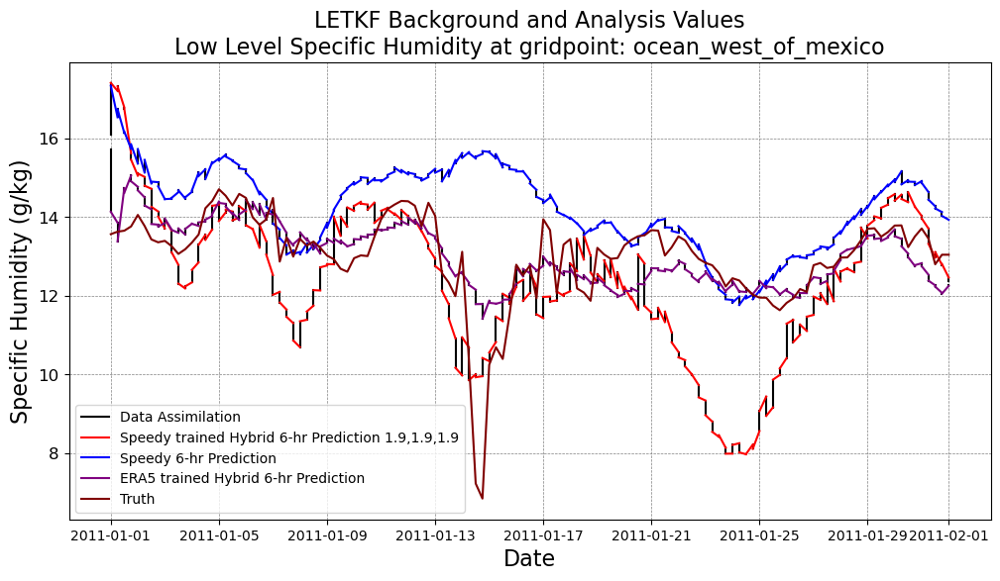

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

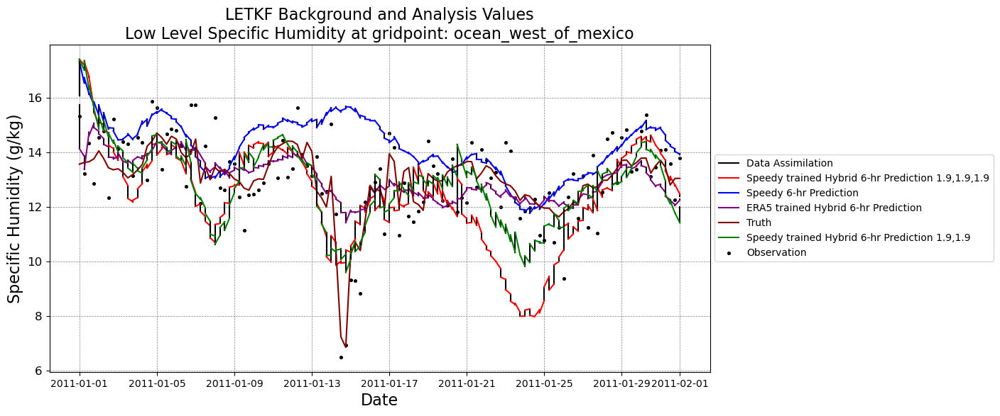

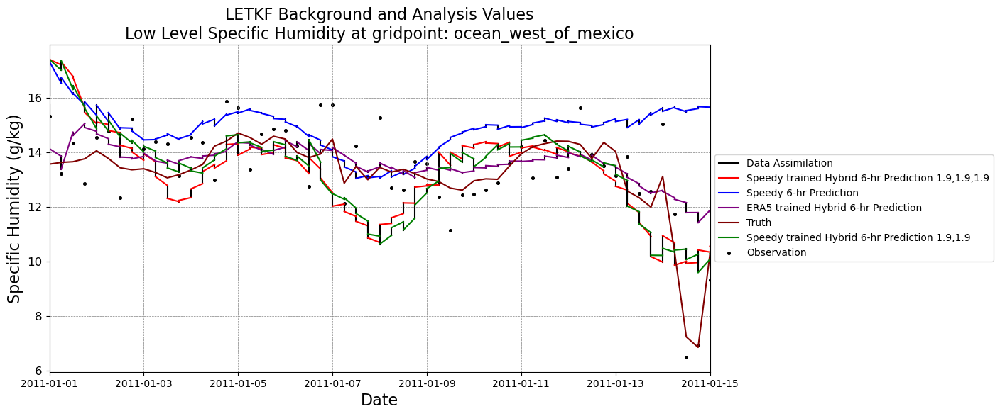

Specific_Humidity
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

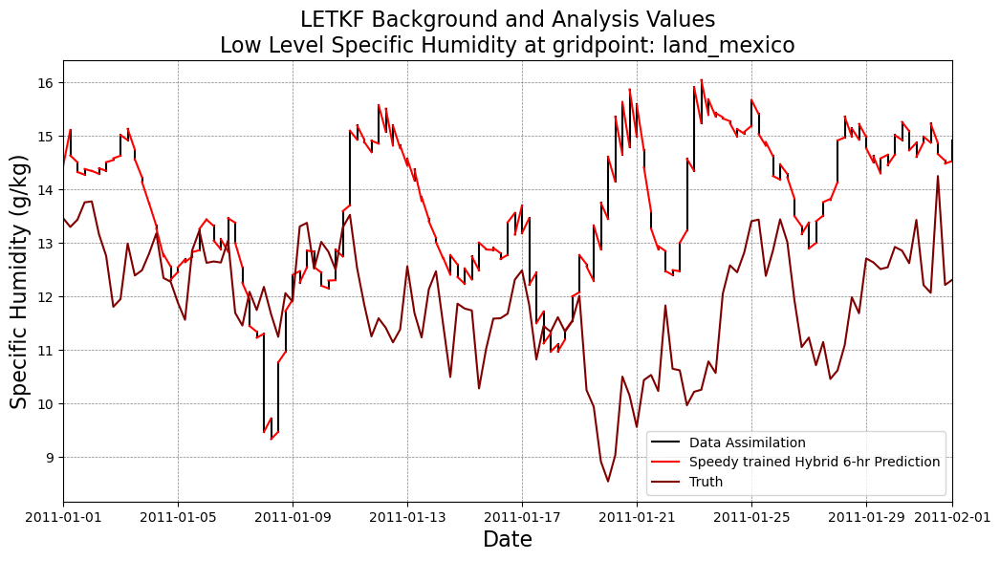

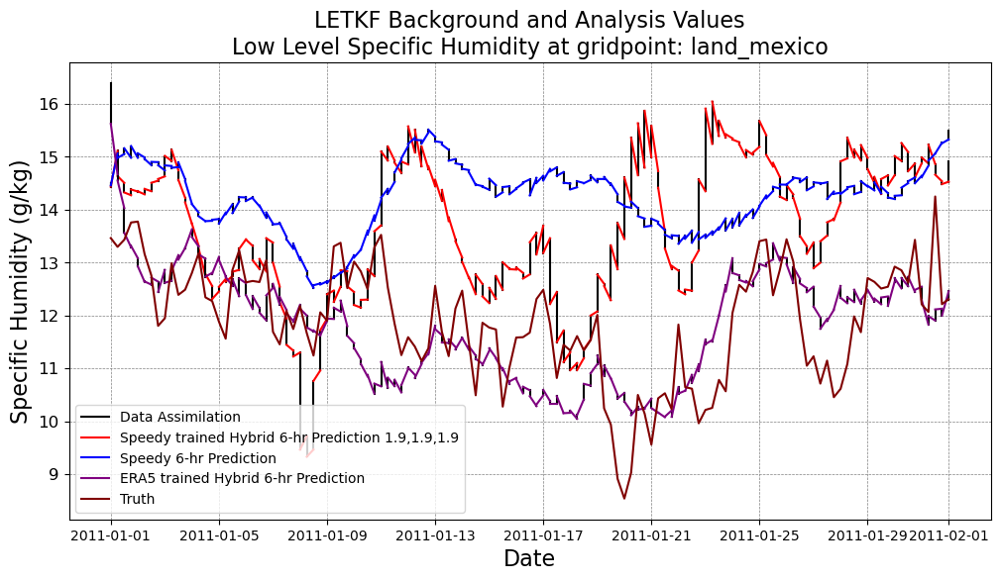

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

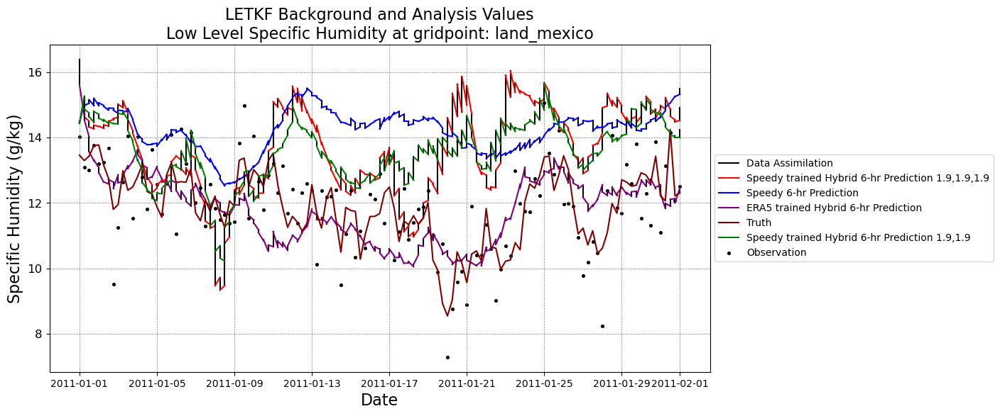

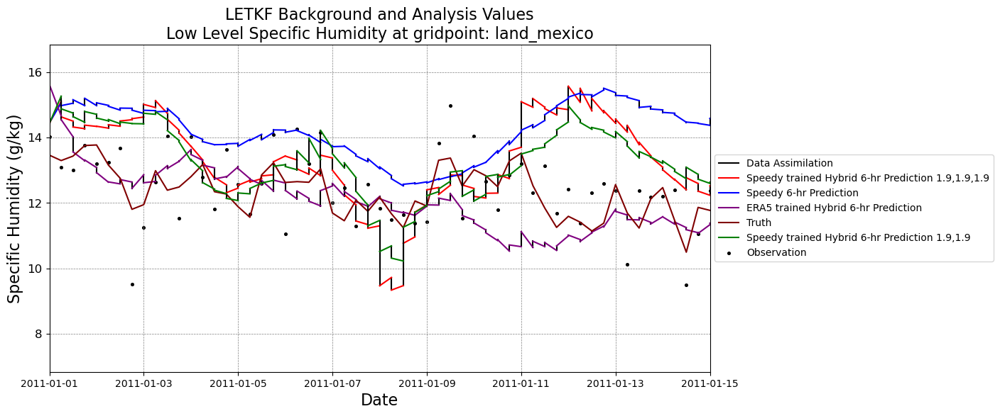

Specific_Humidity
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

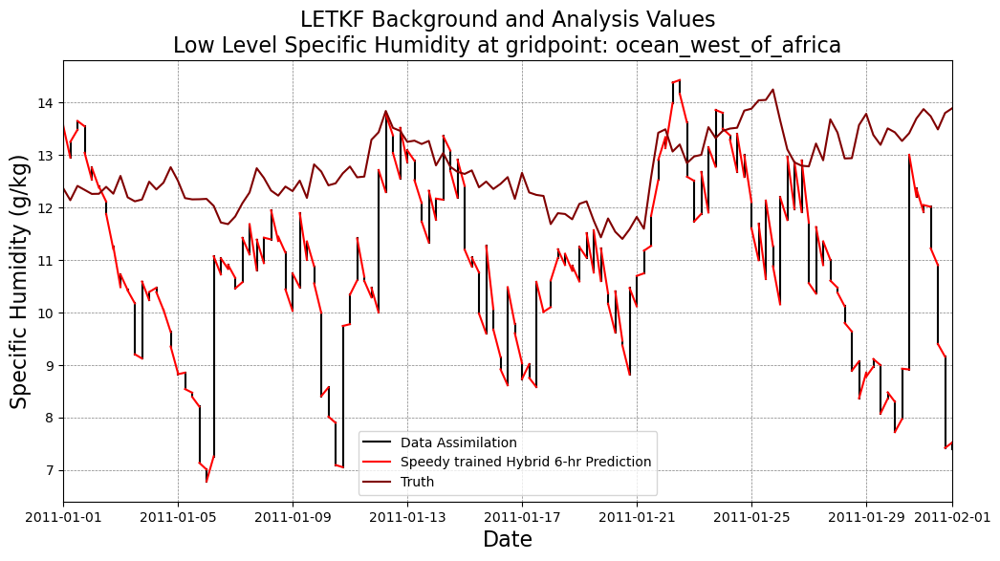

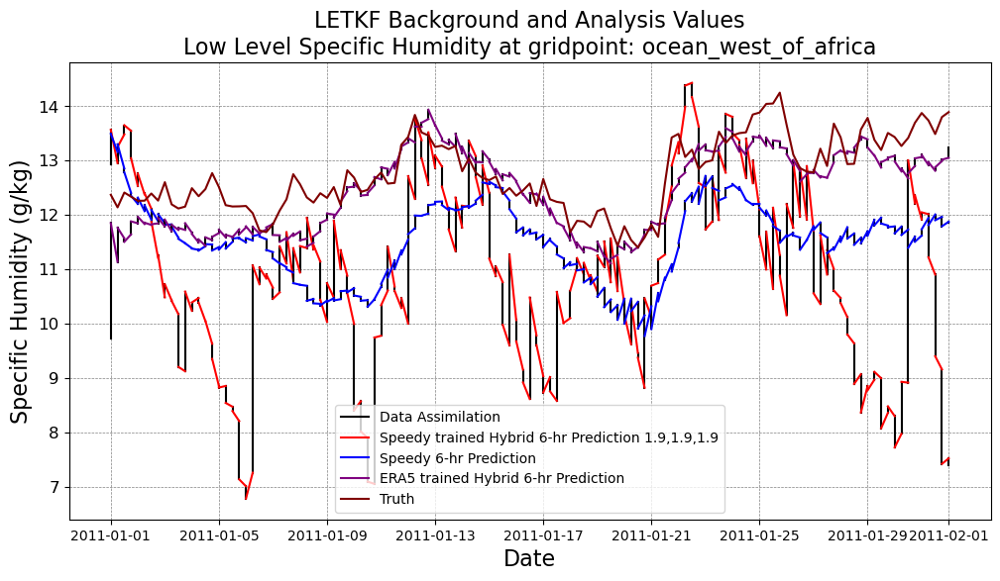

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

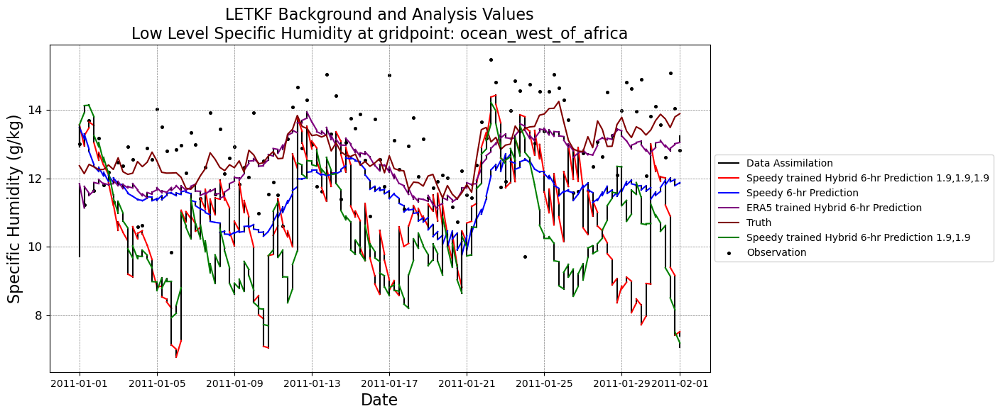

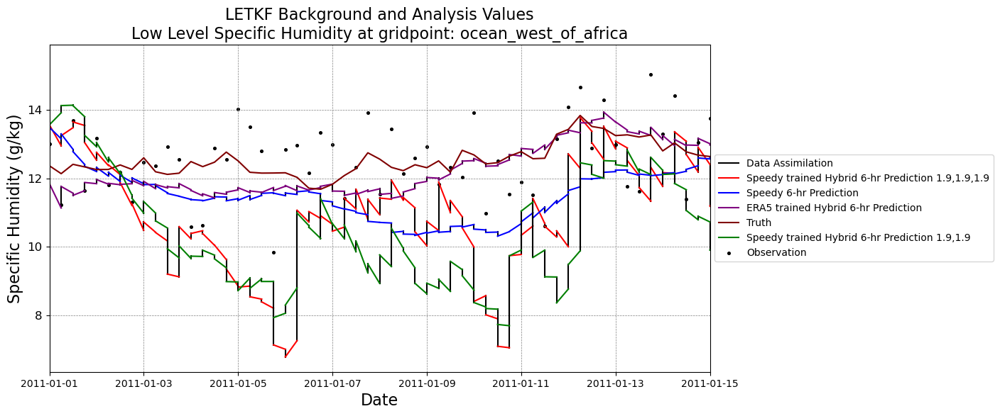

Specific_Humidity
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

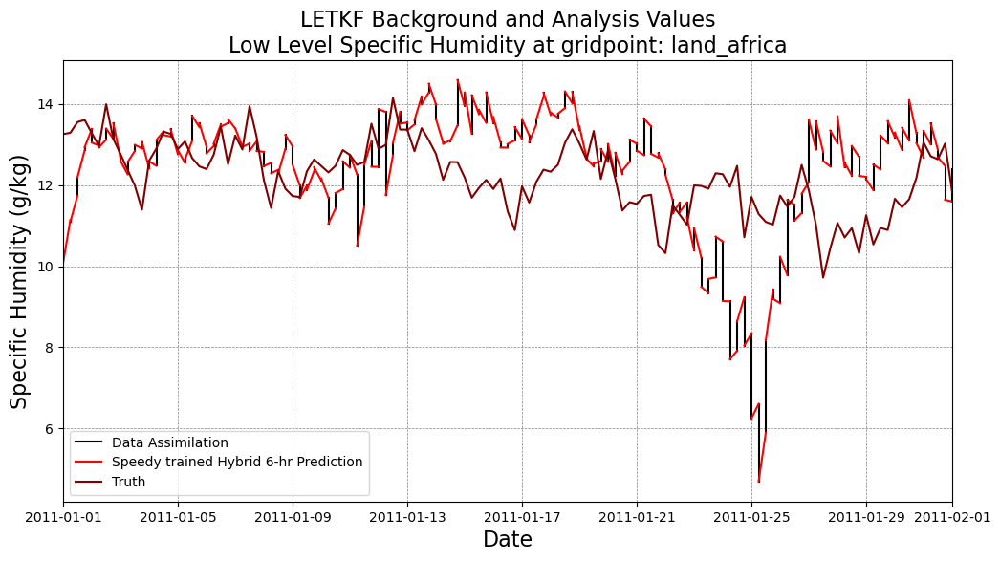

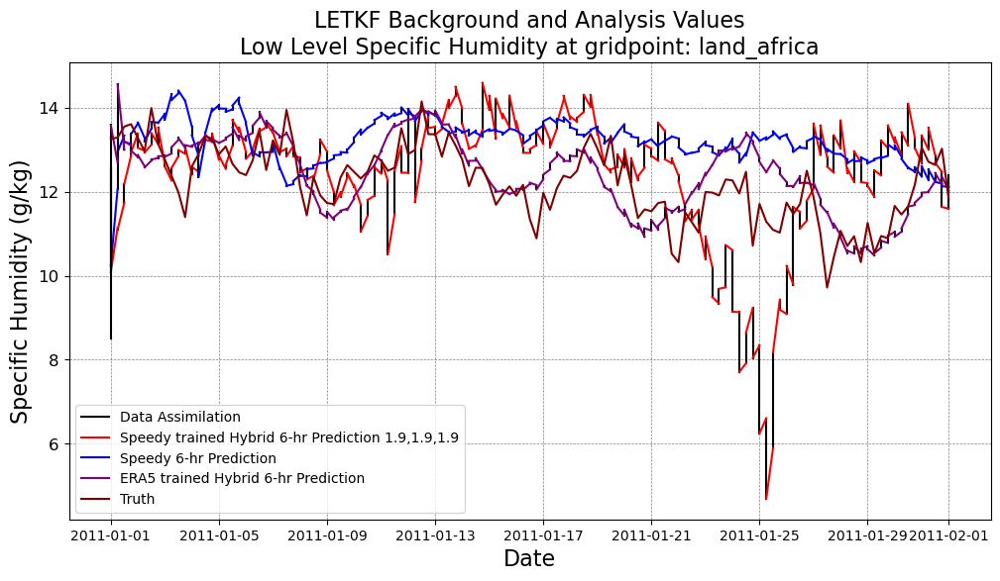

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

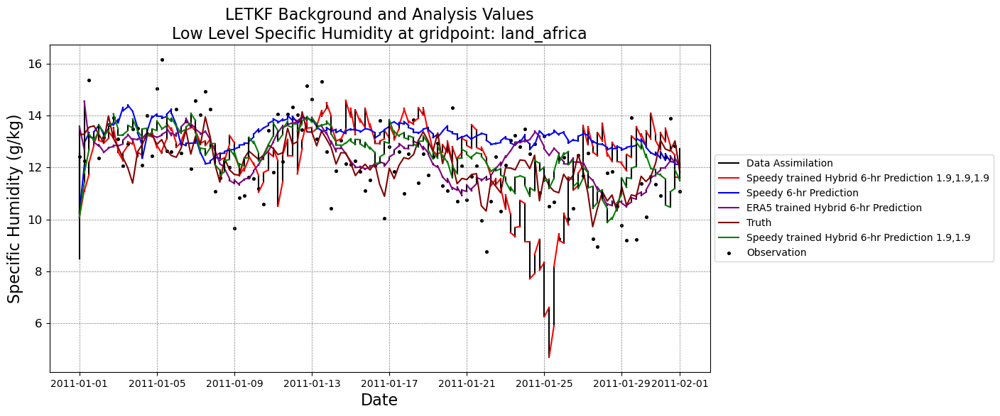

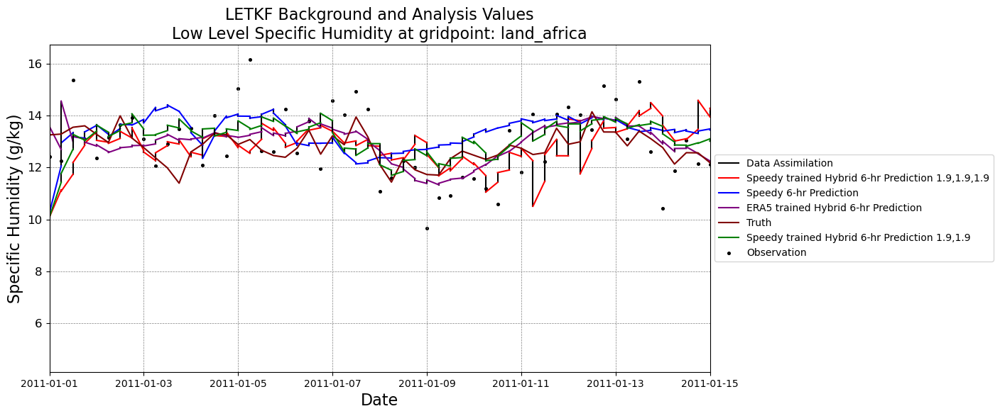

Specific_Humidity
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

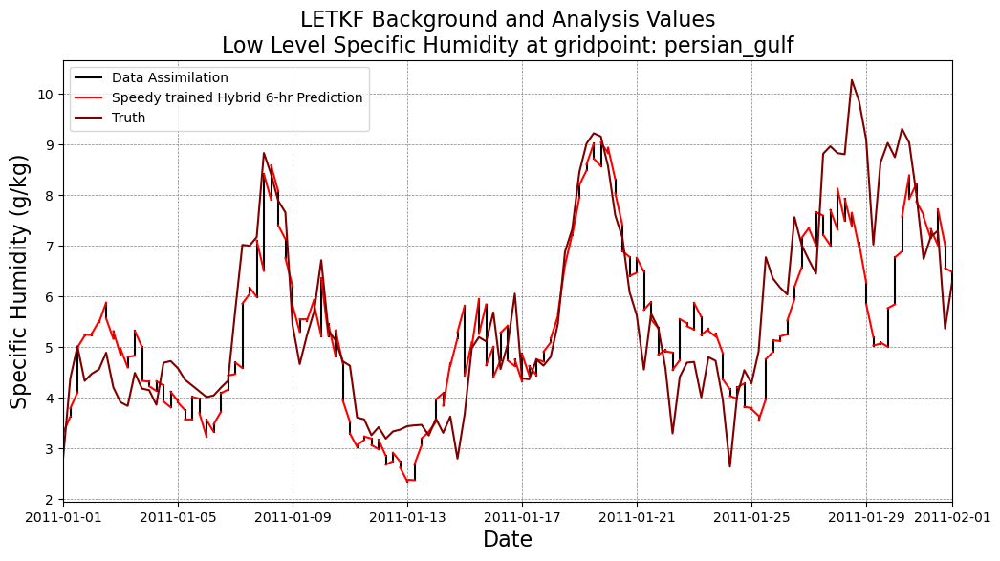

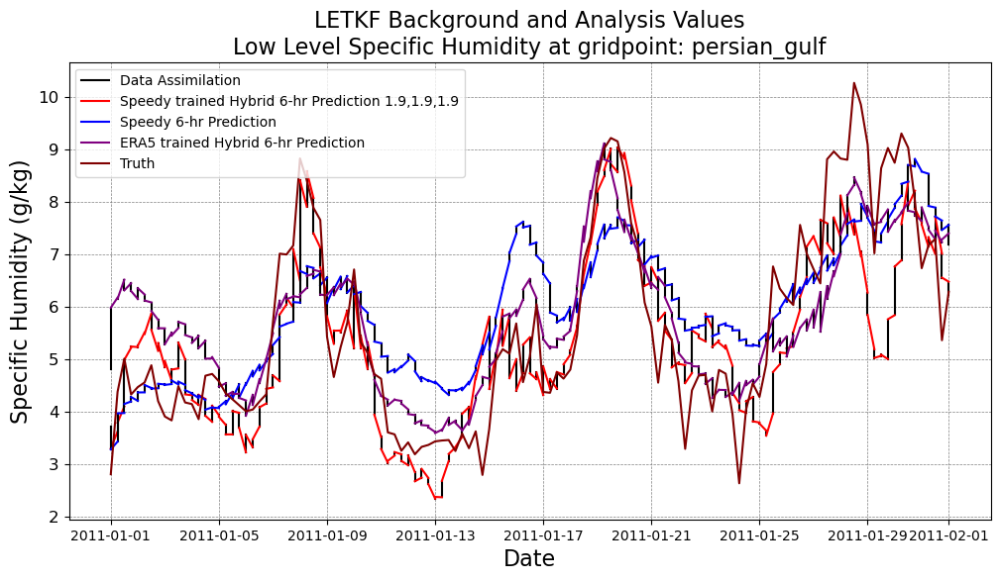

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

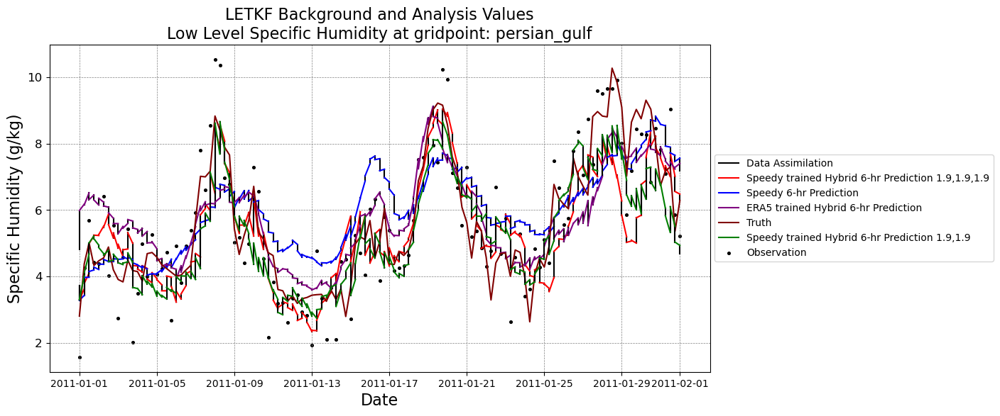

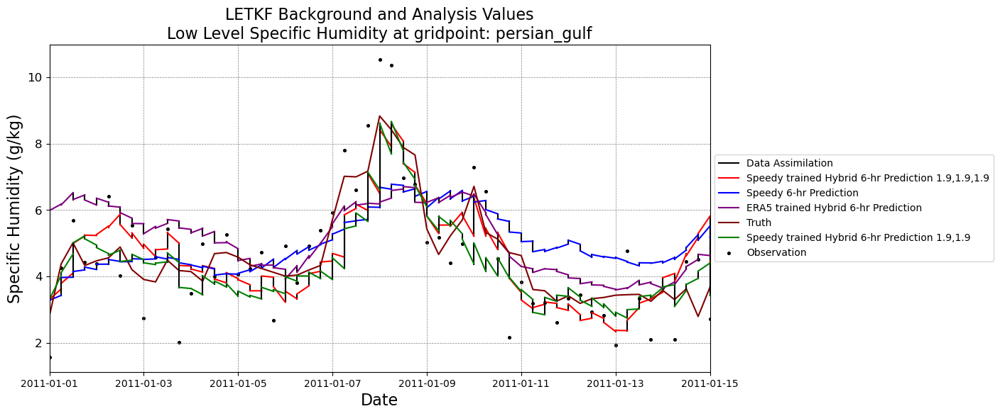

In [9]:
# Cycle through just points list
points = ['ocean_west_of_mexico','land_mexico','ocean_west_of_africa','land_africa','persian_gulf']

level = .95
variable = 'q'
# variable_list = ['q','t','v']
# for selected_variable in variable_list:
    
for selected_point in points:
    rmse_time_series_plot_and_maps(level,variable,selected_point)

U-wind
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = U-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

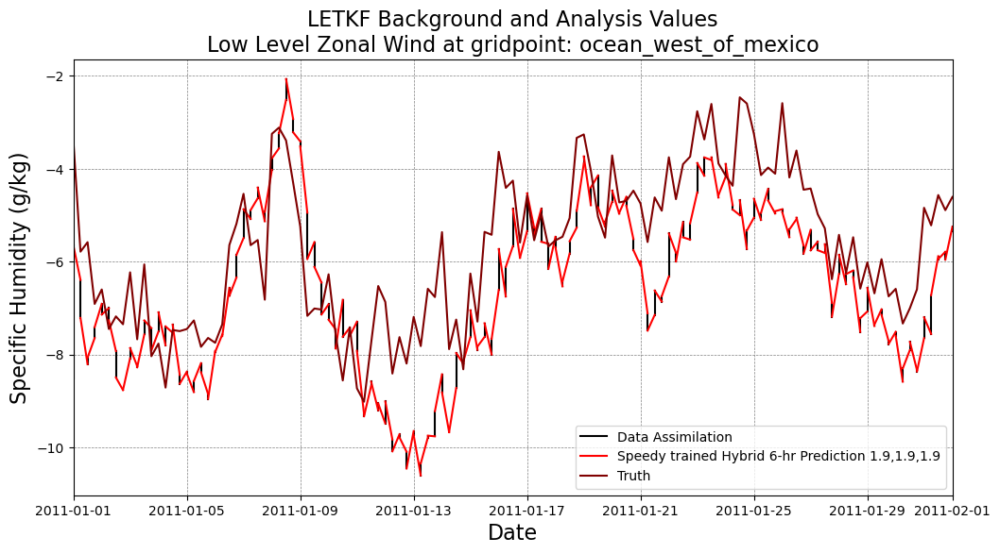

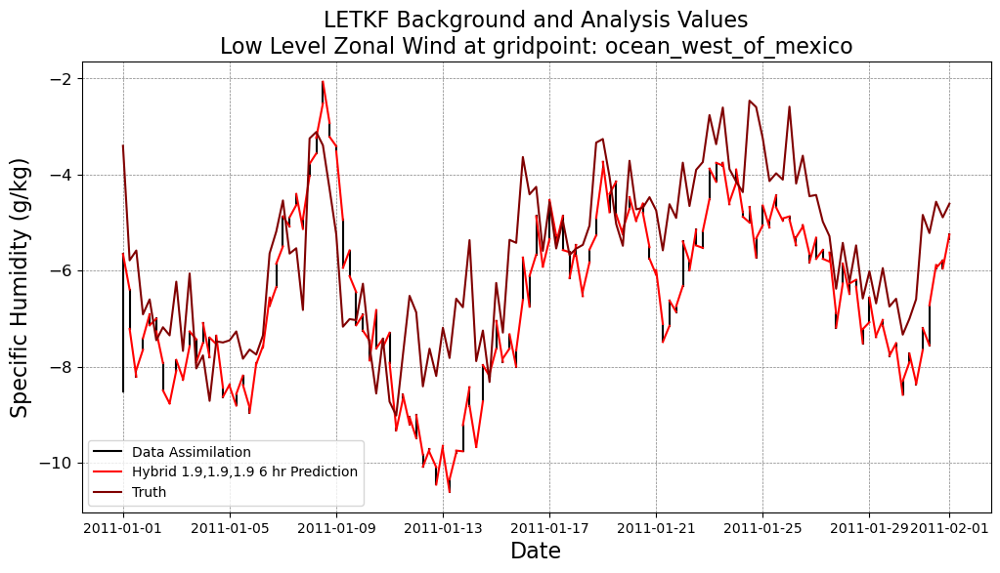

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

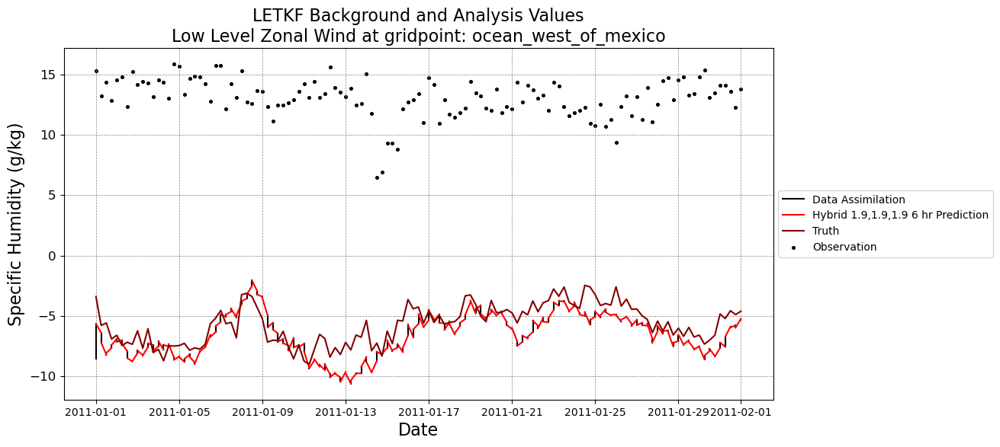

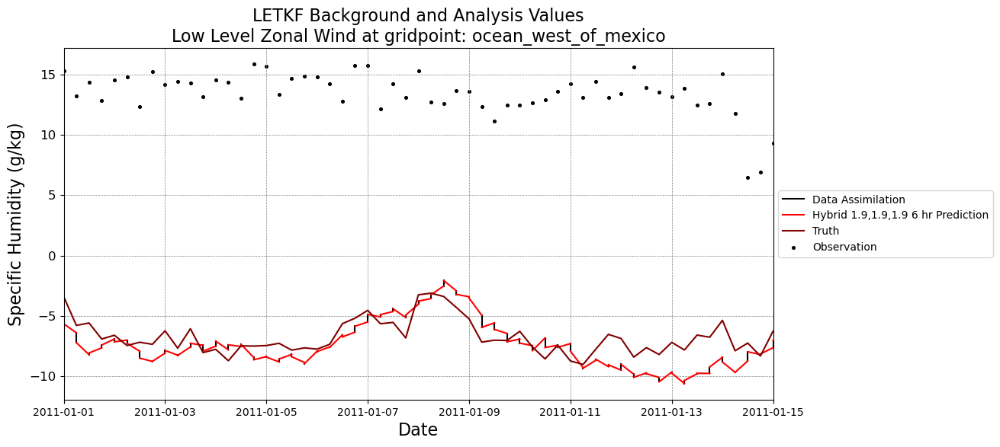

U-wind
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = U-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

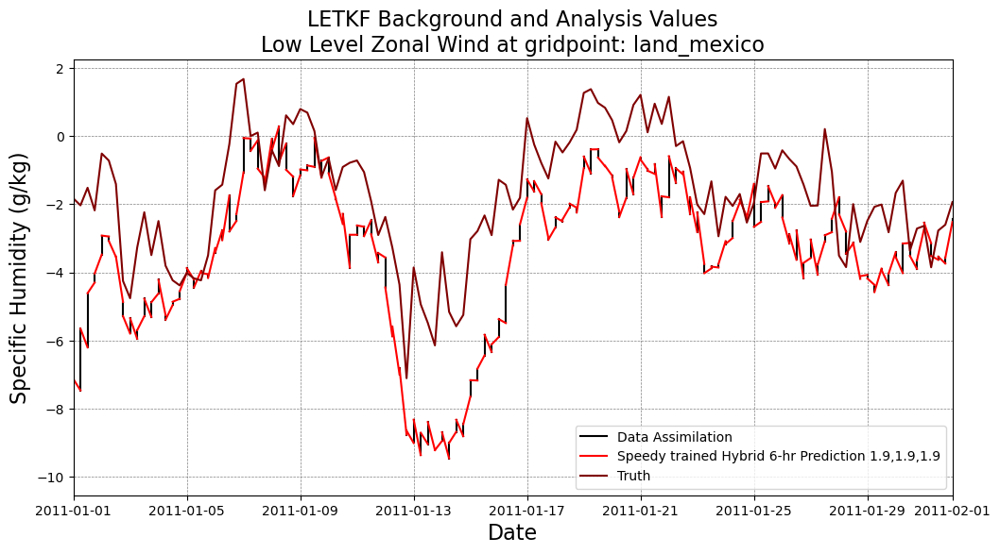

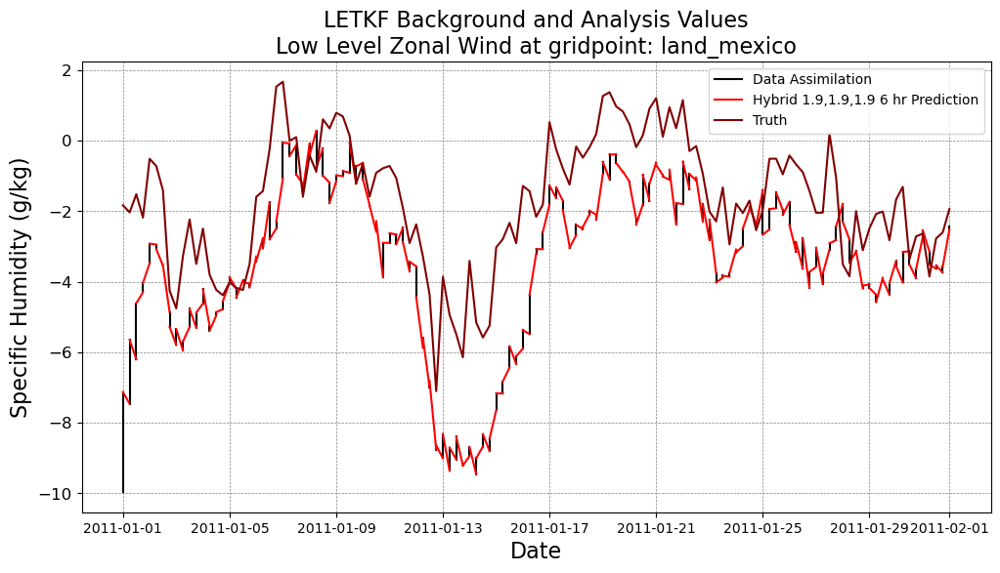

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

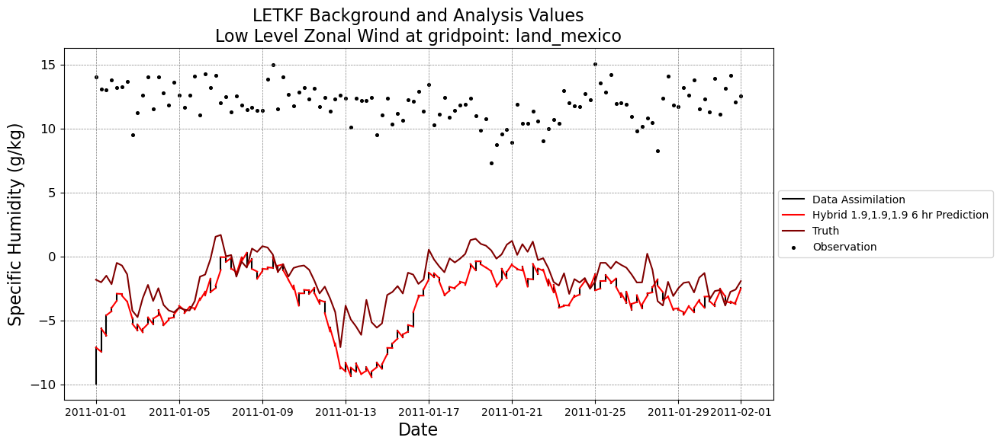

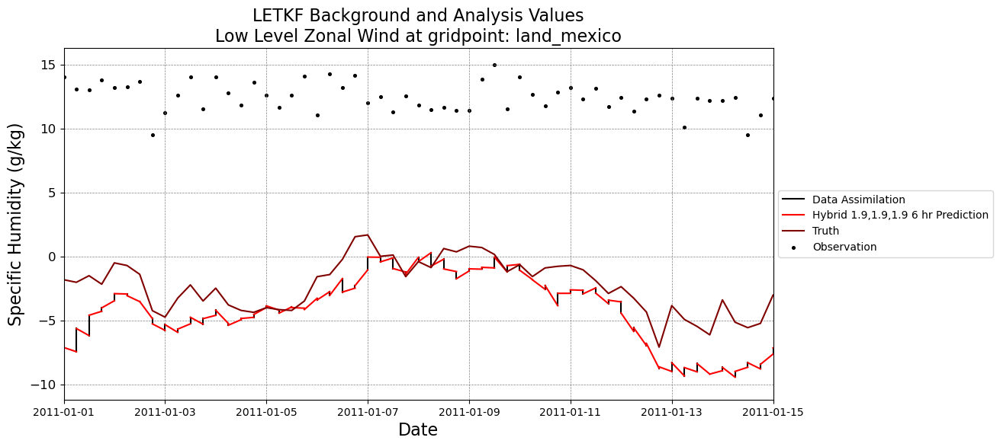

U-wind
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = U-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

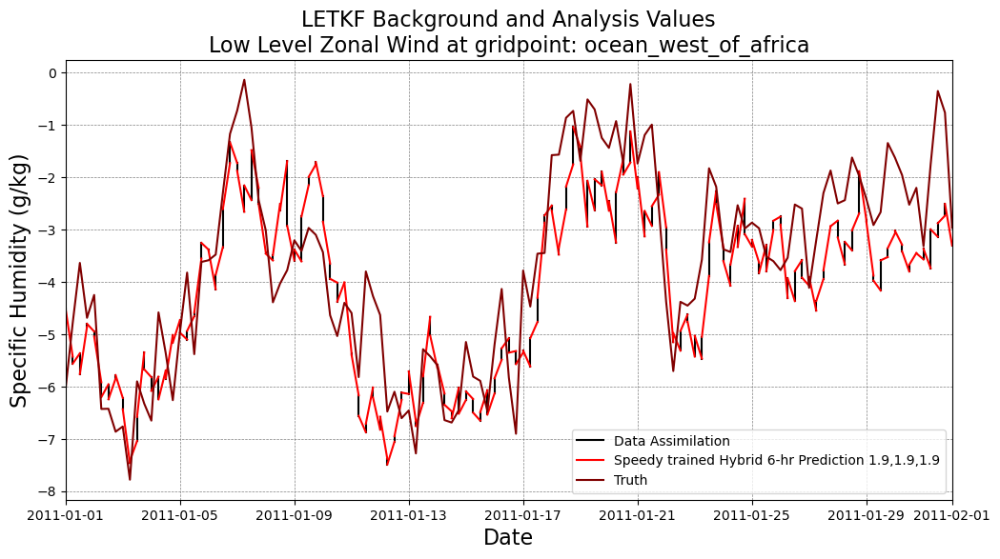

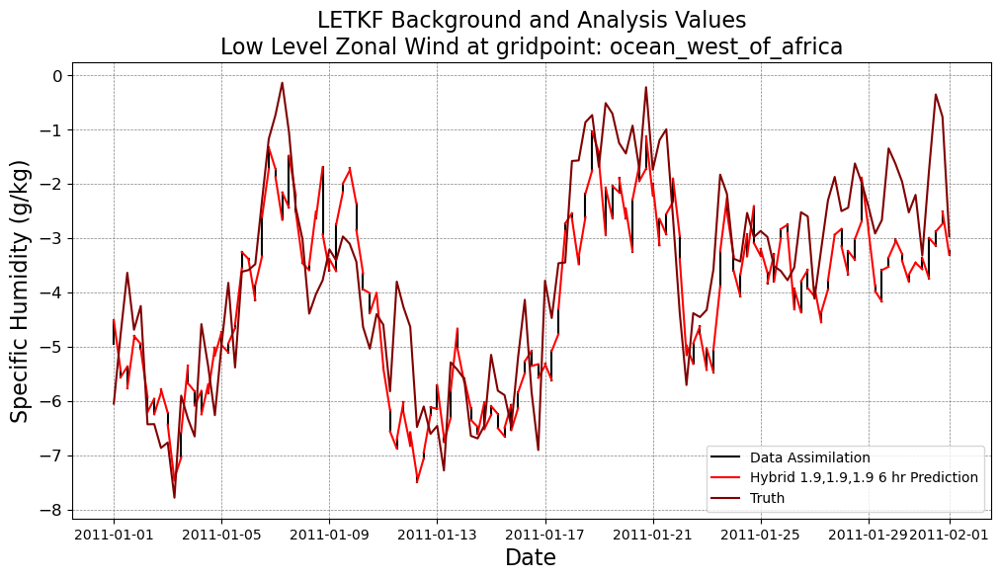

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

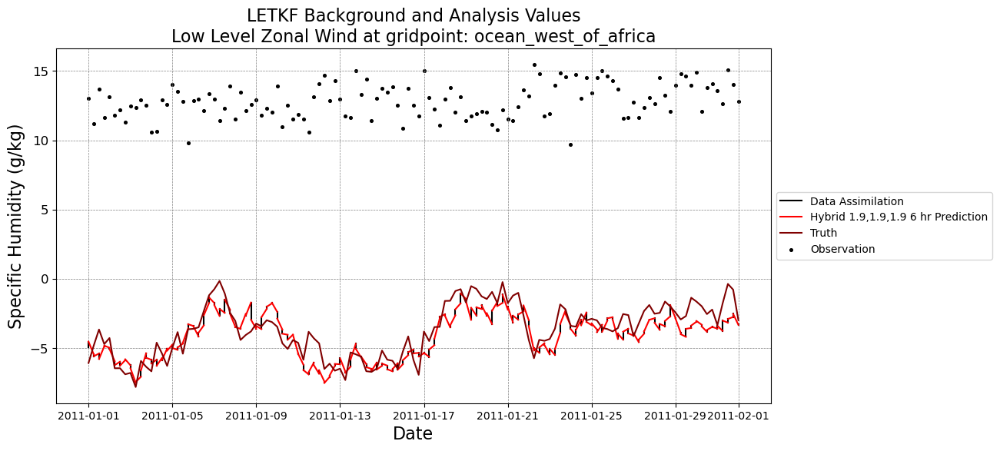

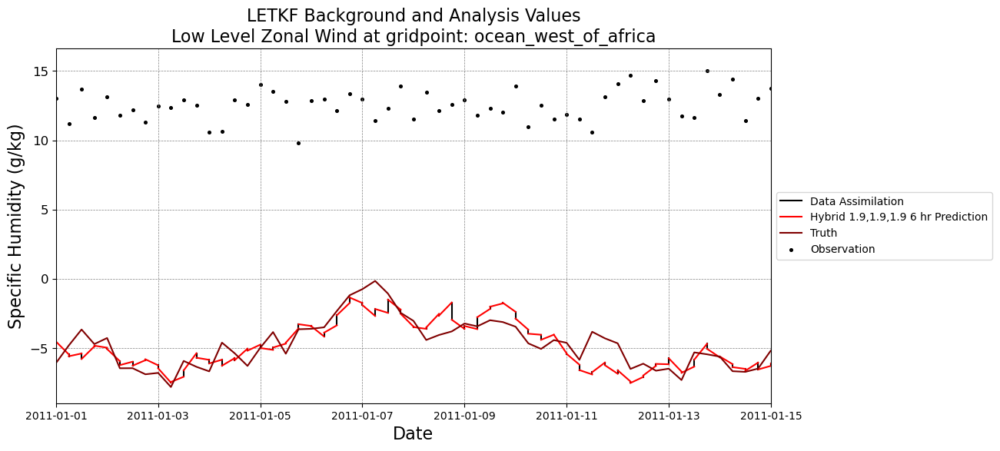

U-wind
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = U-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

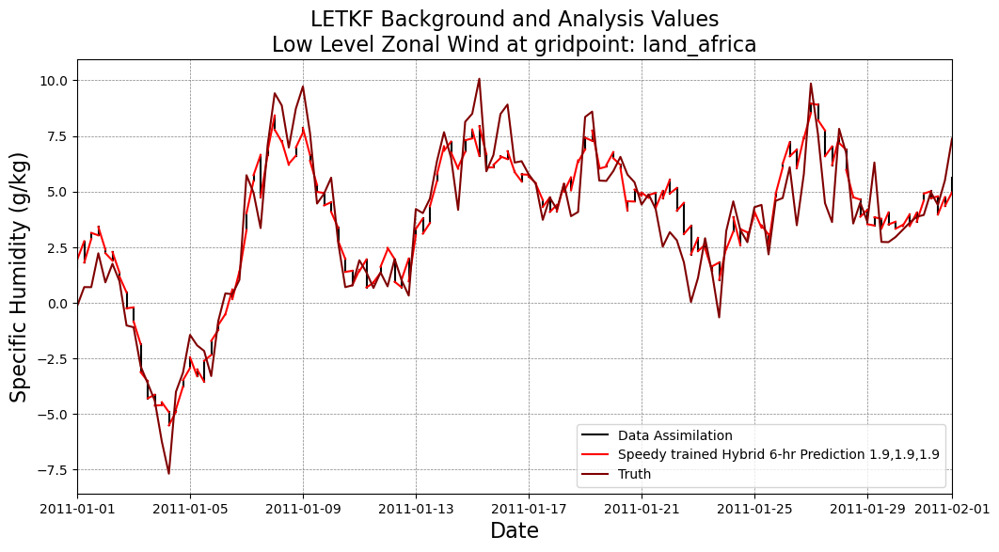

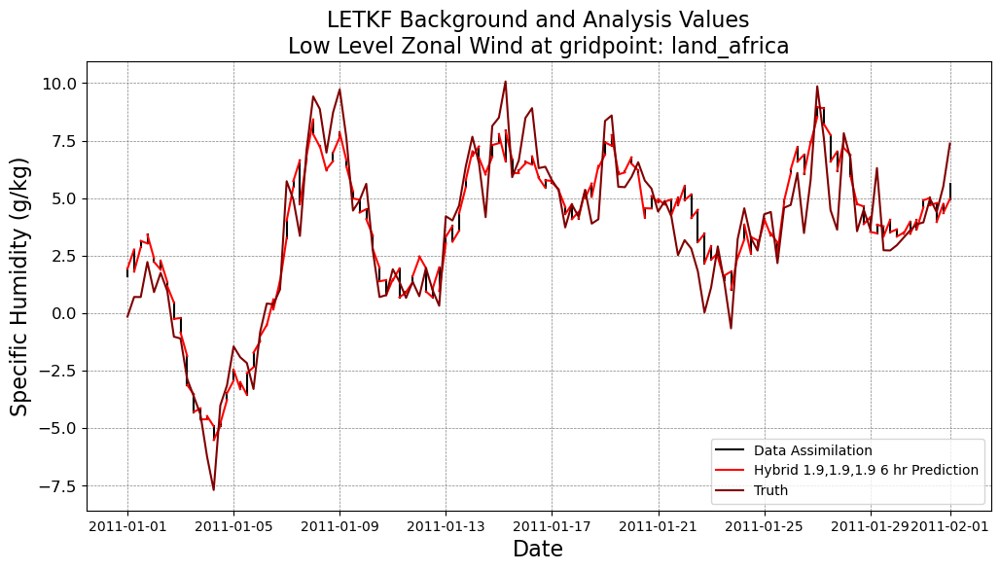

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

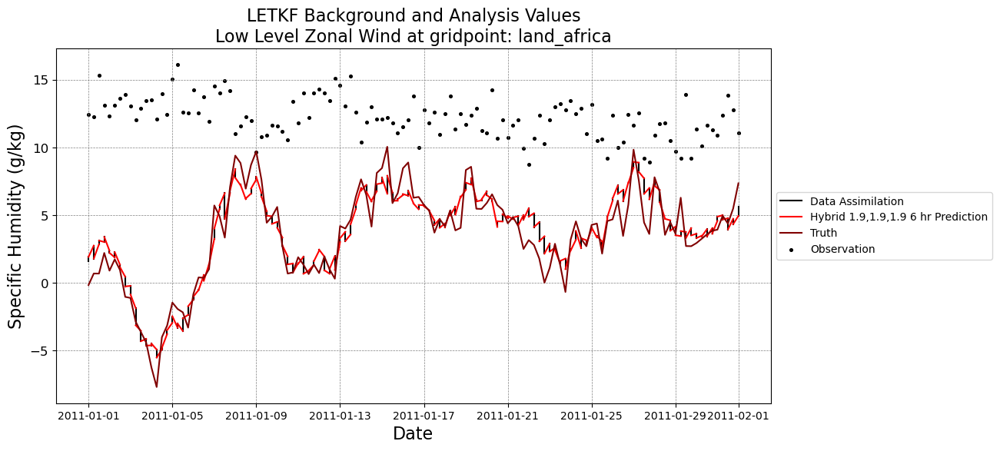

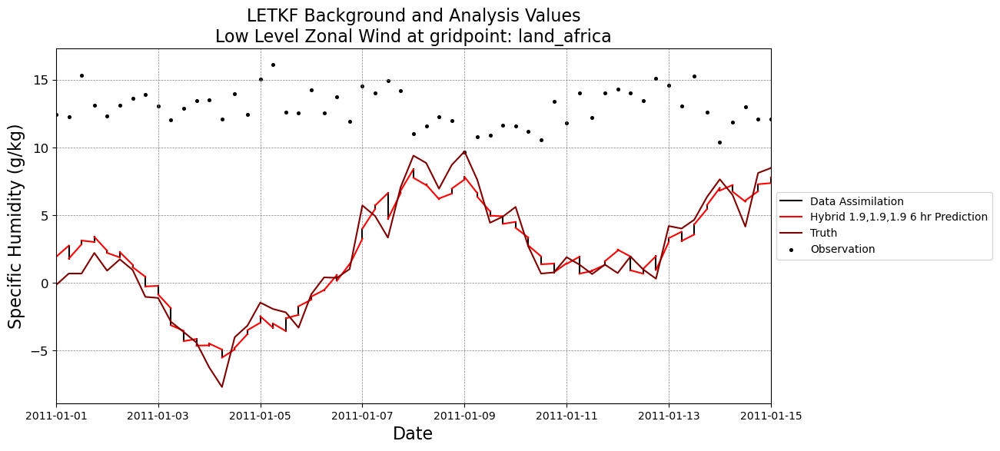

U-wind
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = U-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

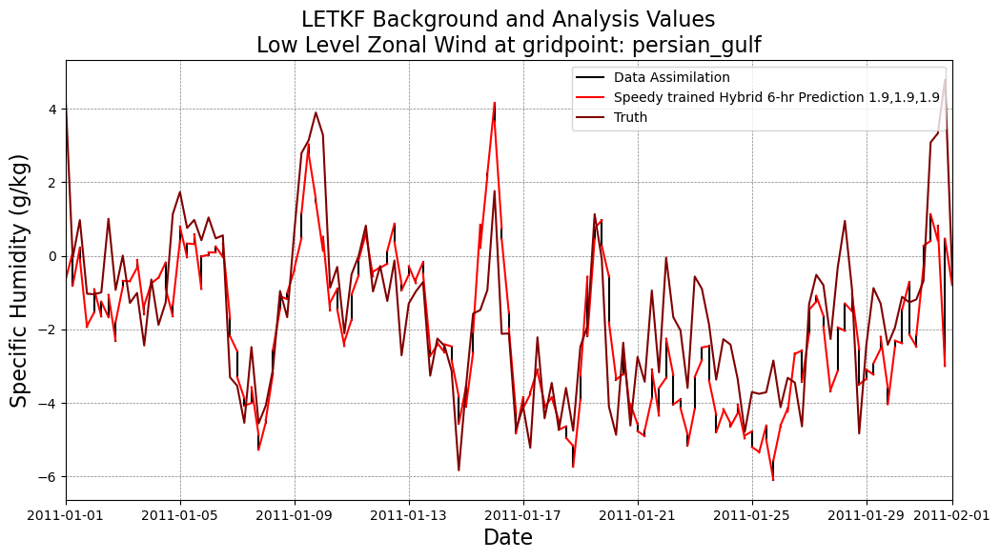

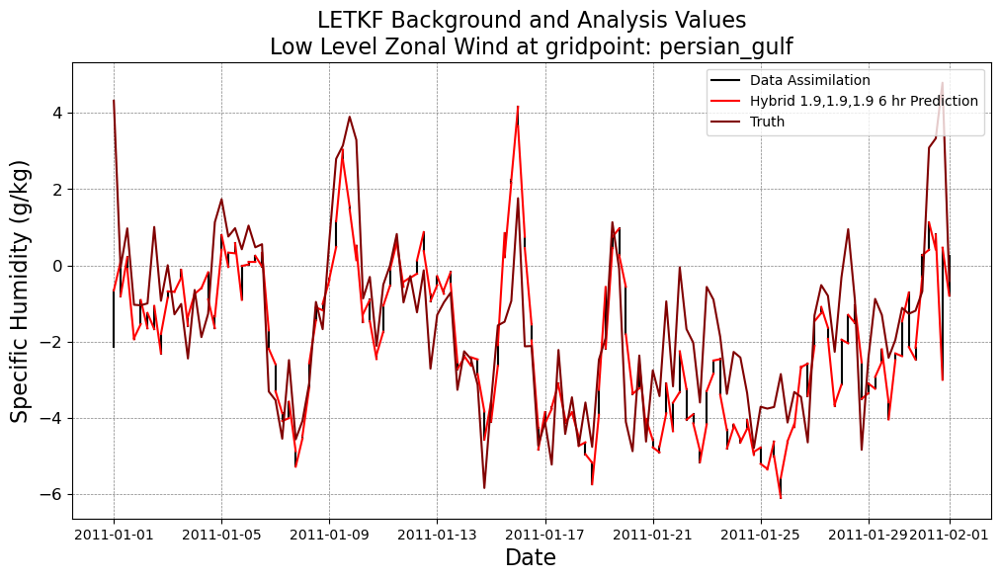

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

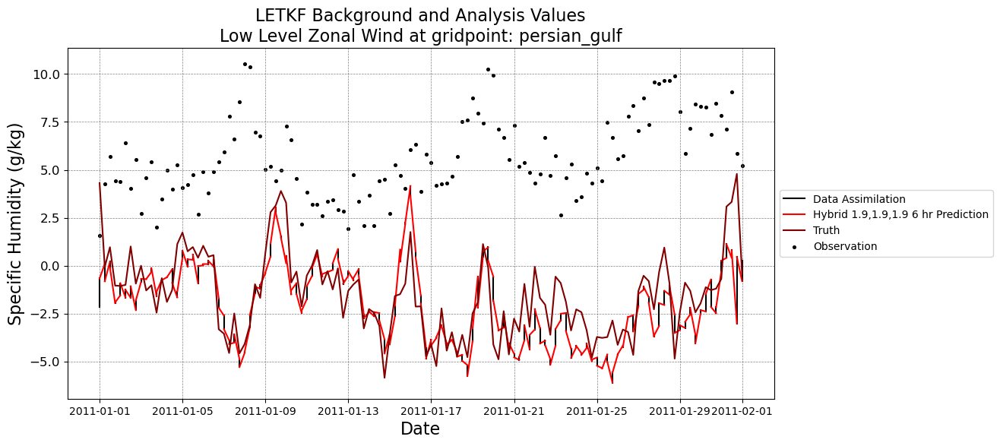

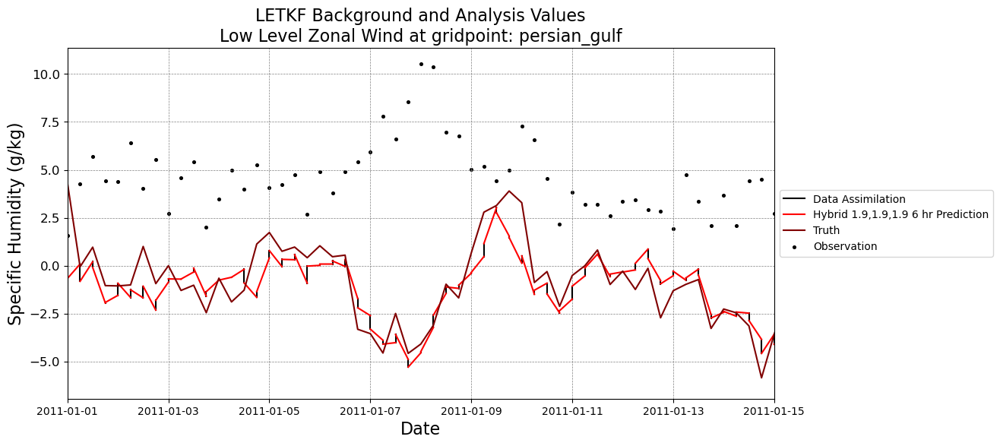

Temperature
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = Temperature
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

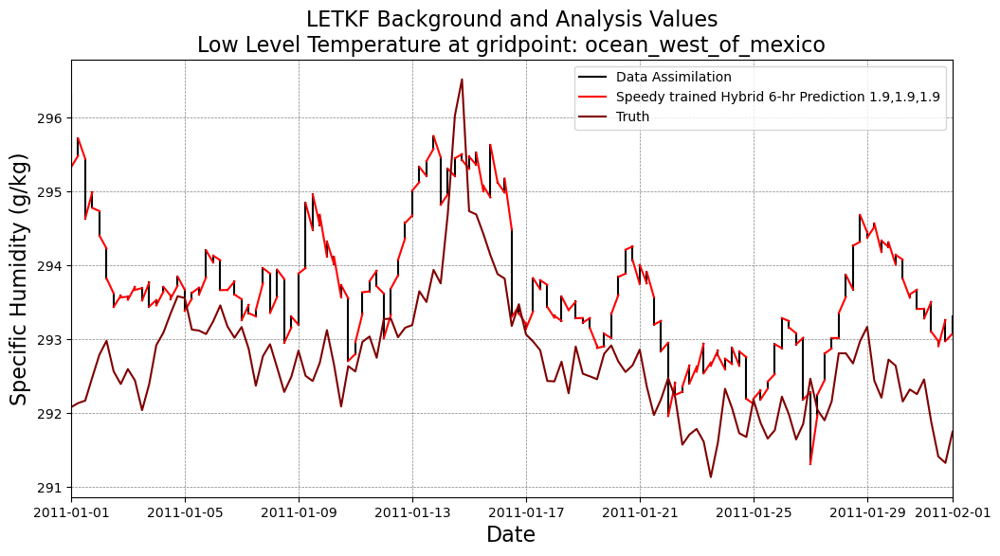

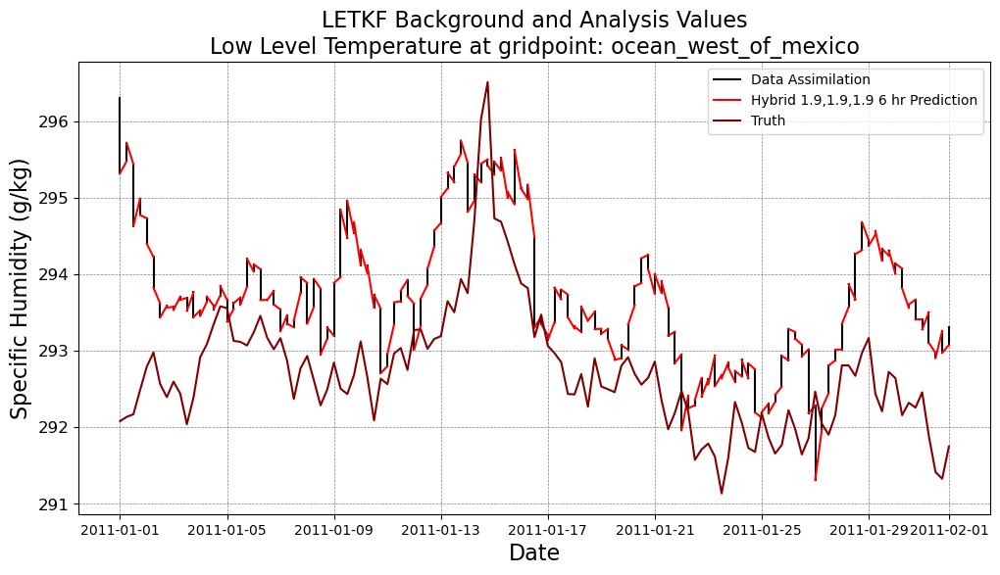

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

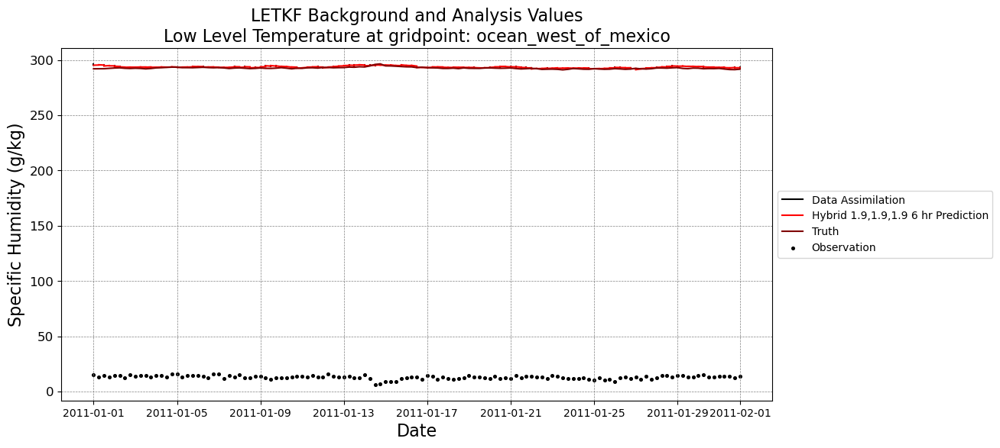

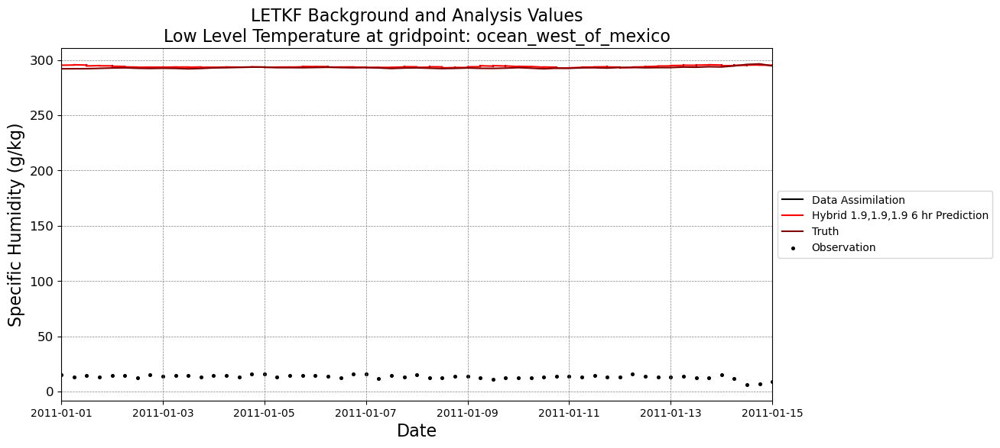

Temperature
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = Temperature
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

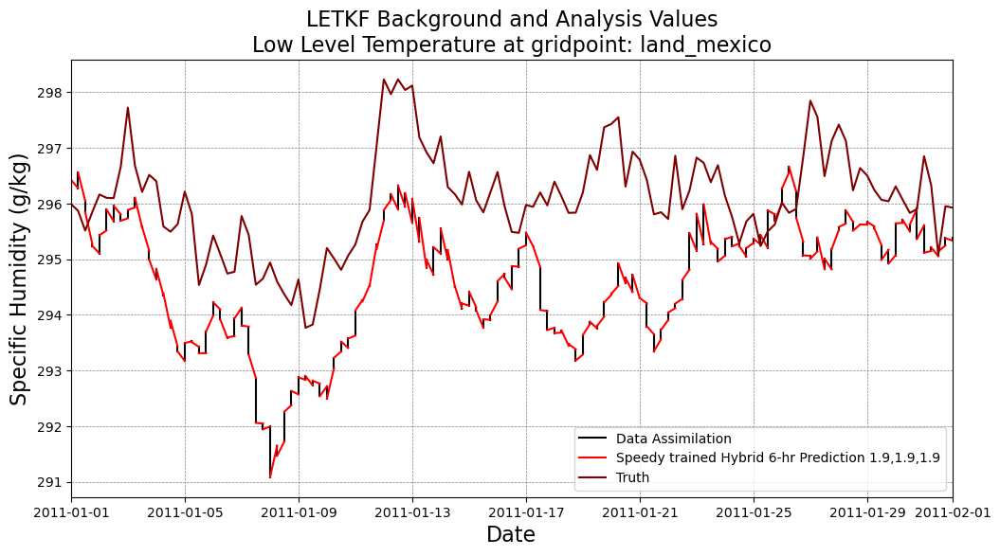

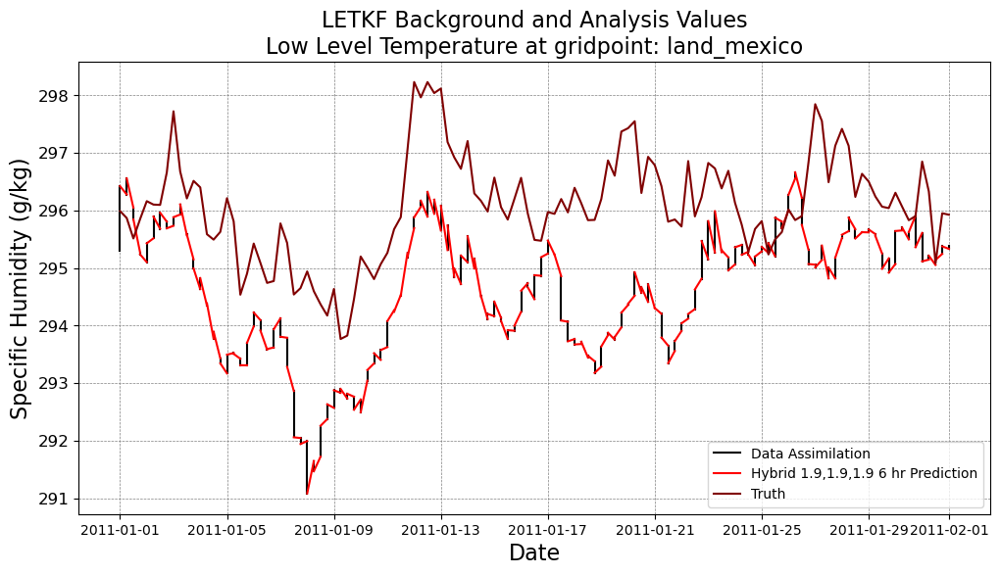

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

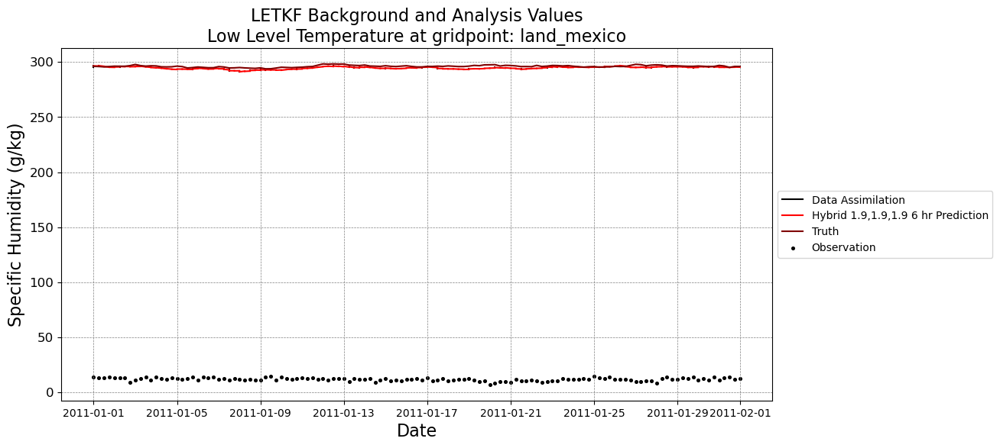

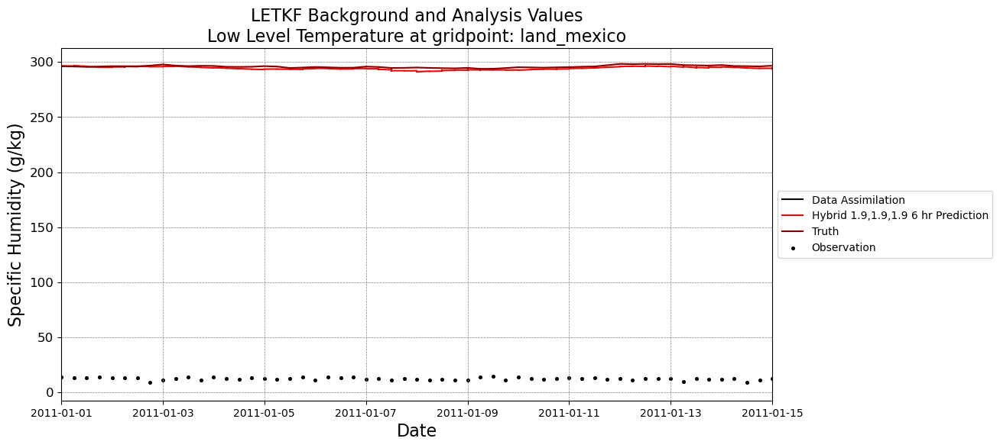

Temperature
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = Temperature
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

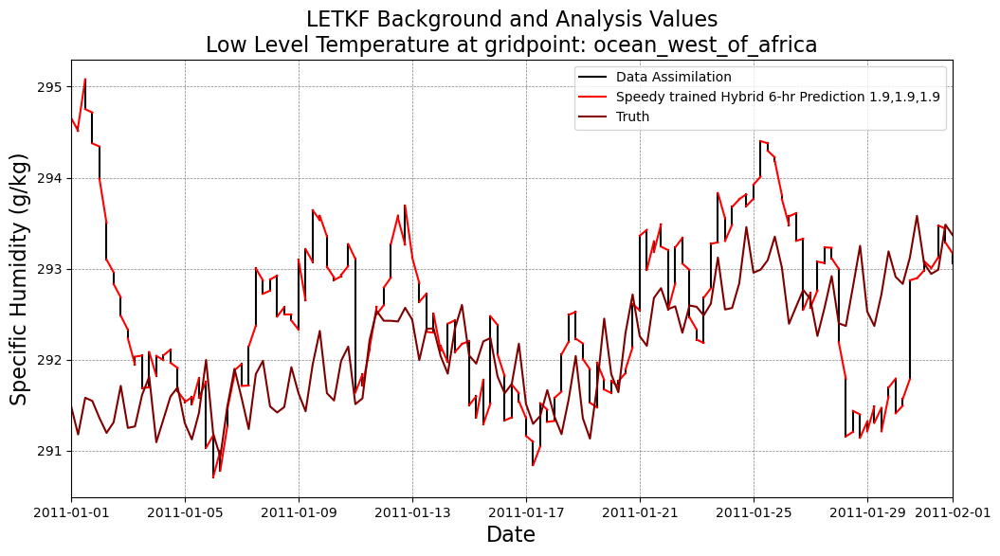

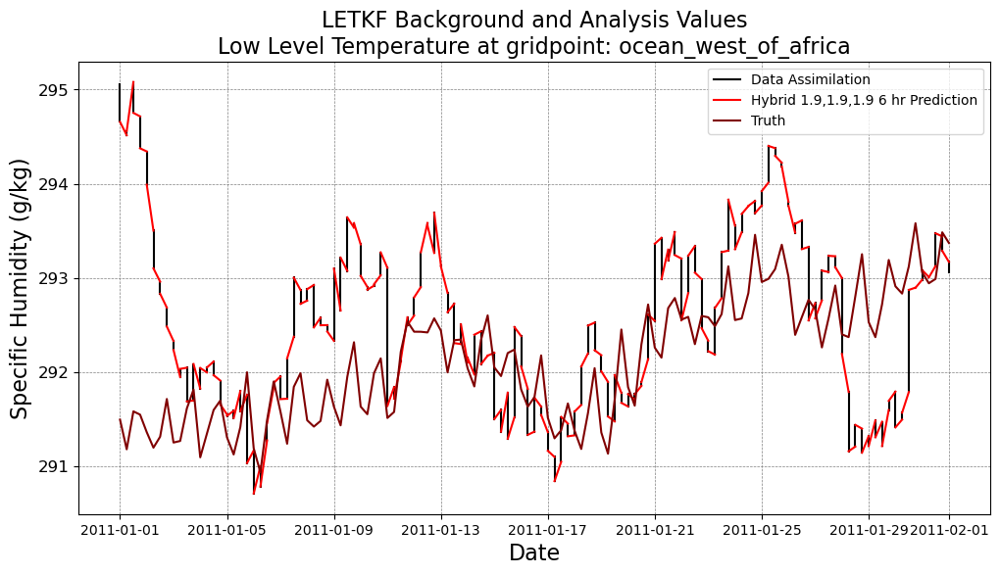

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

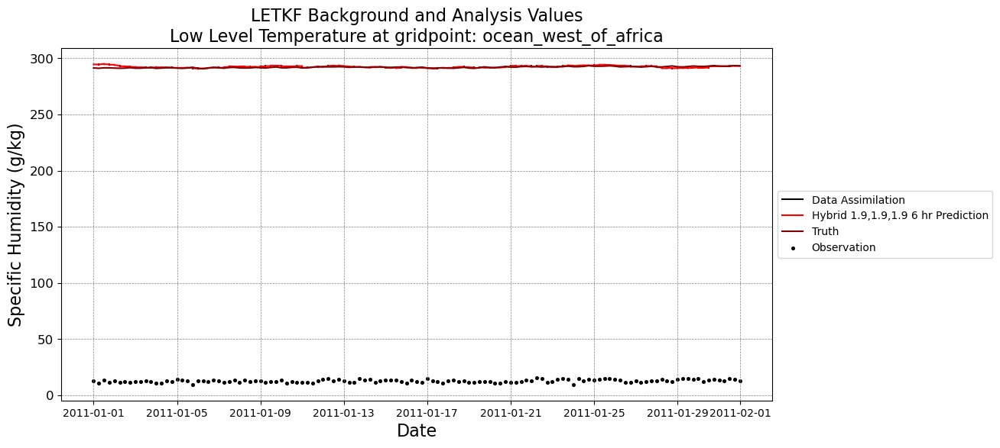

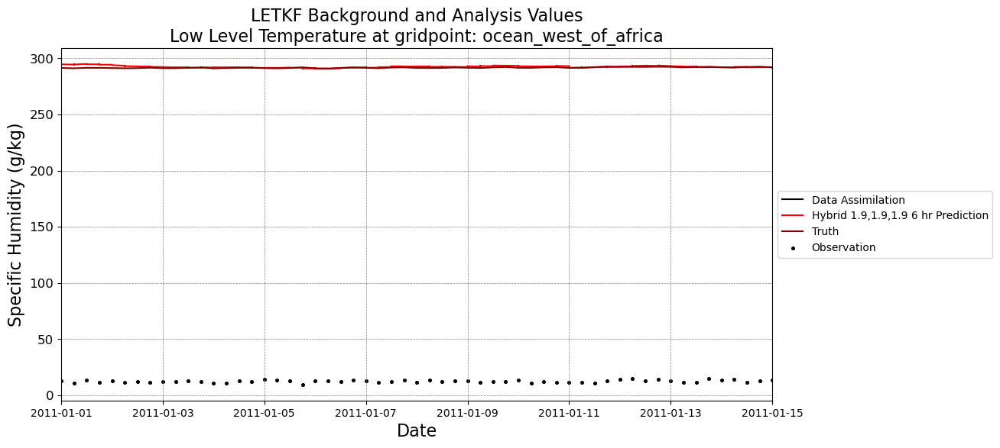

Temperature
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = Temperature
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

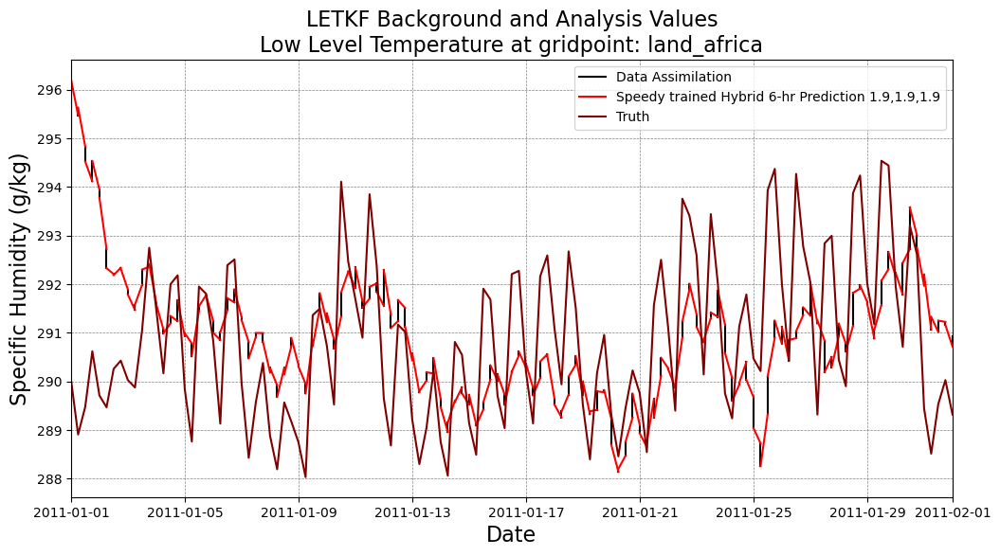

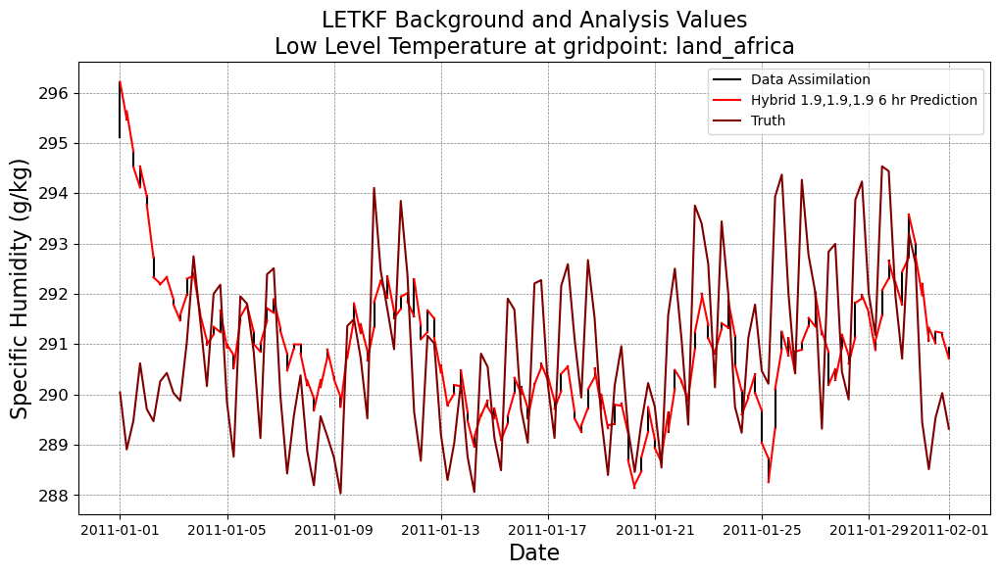

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

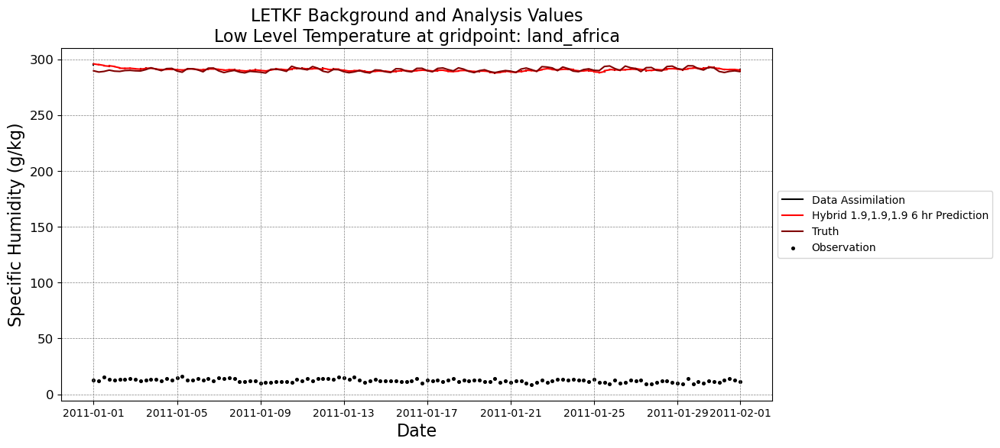

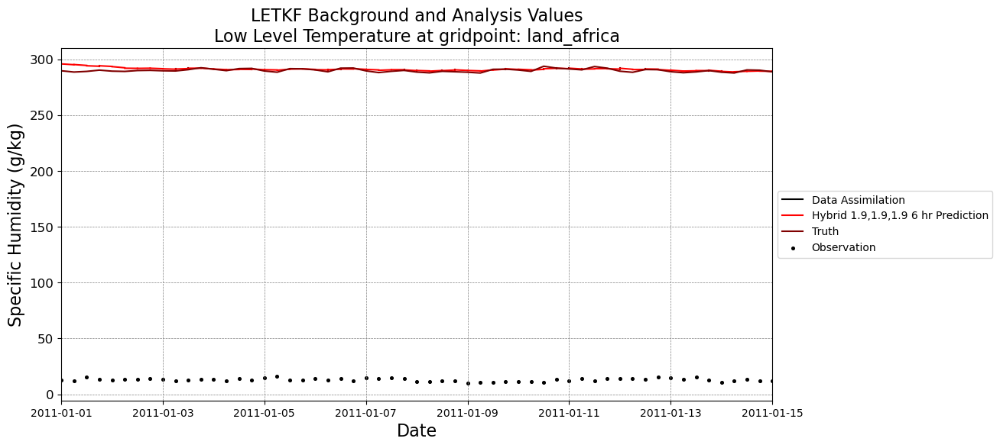

Temperature
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = Temperature
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

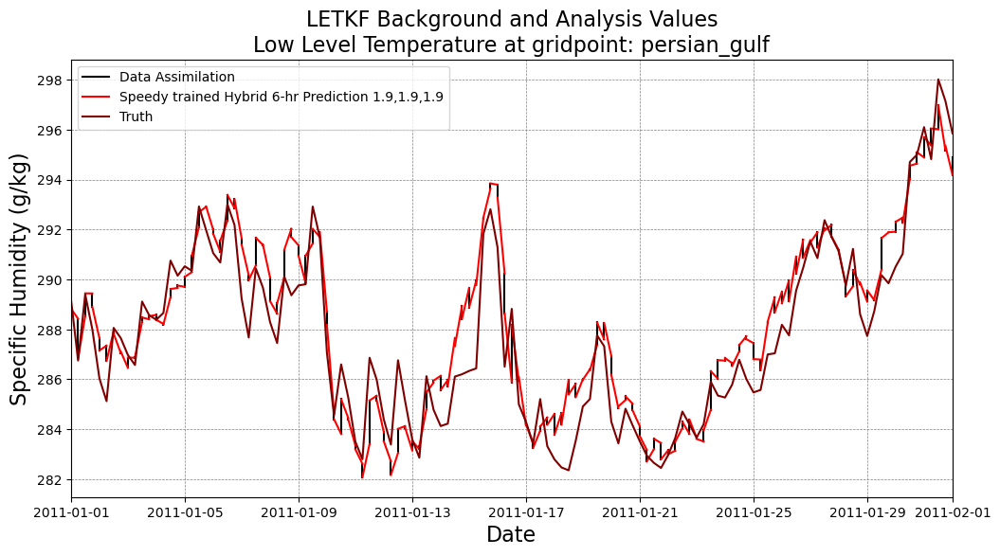

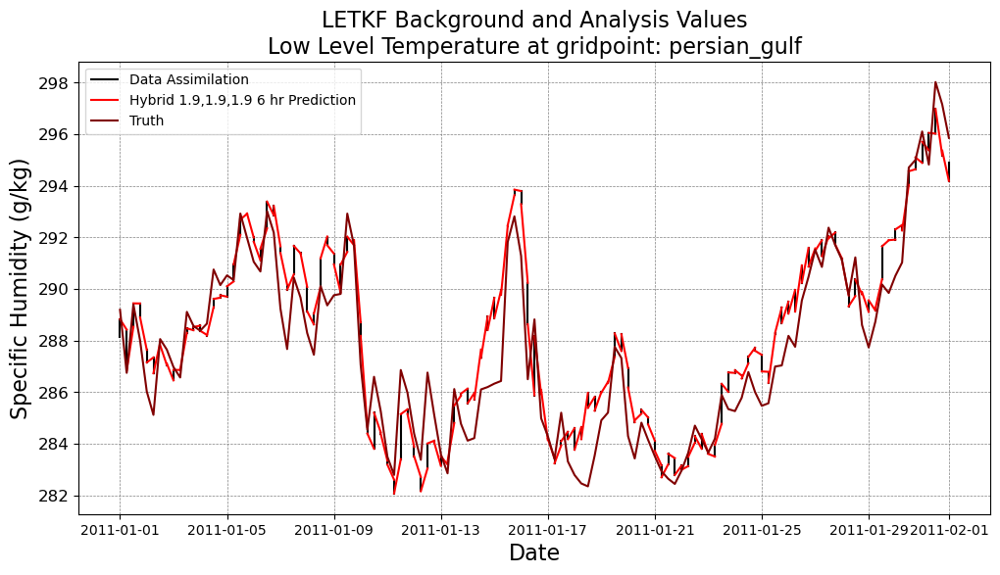

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

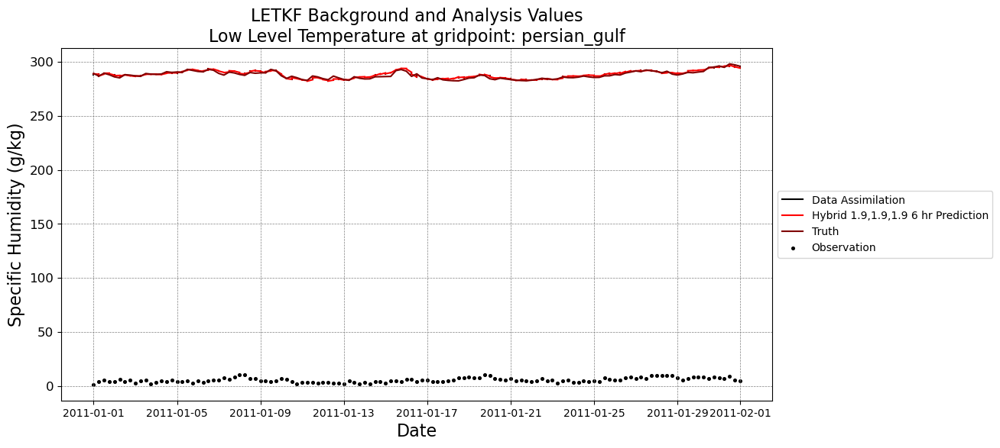

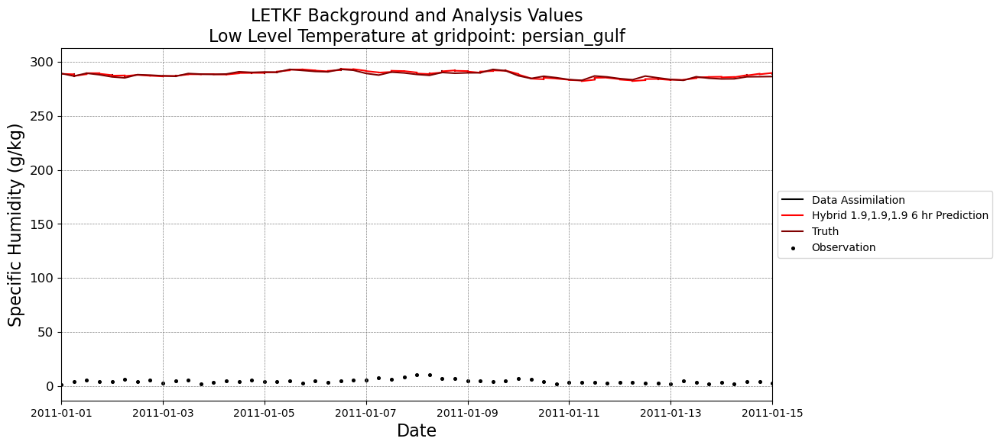

V-wind
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = V-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

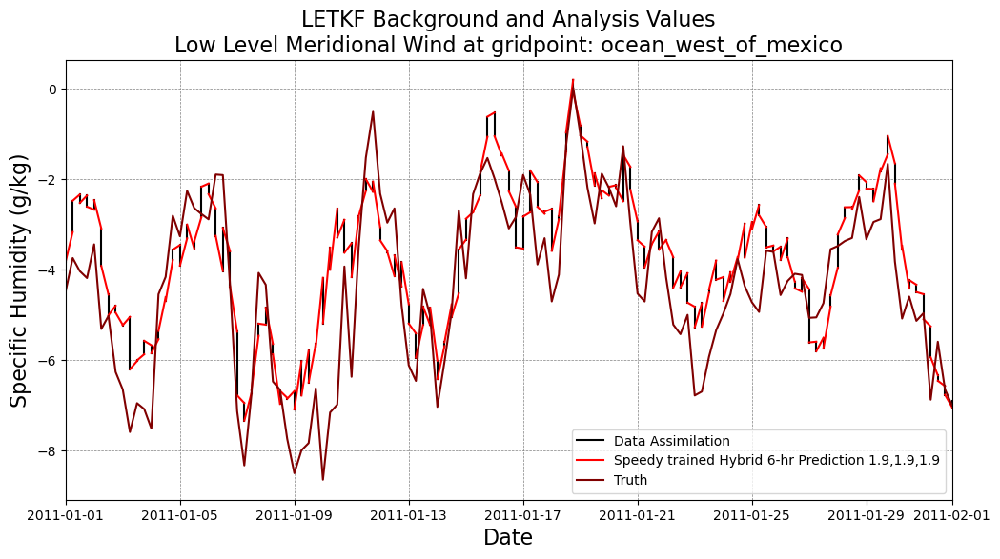

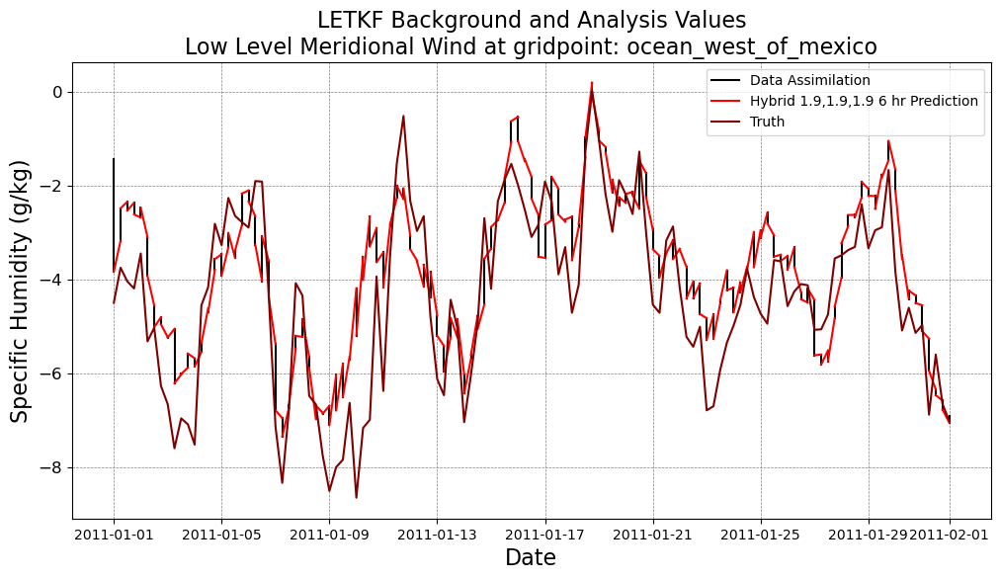

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

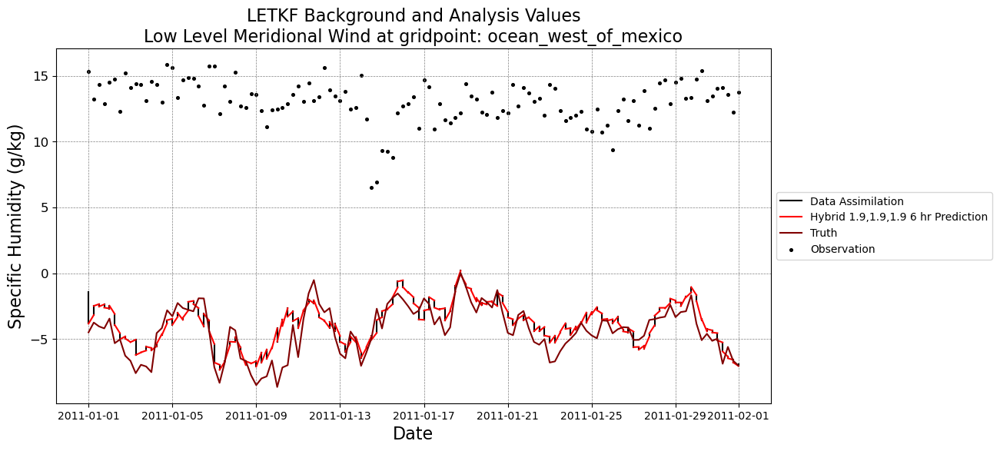

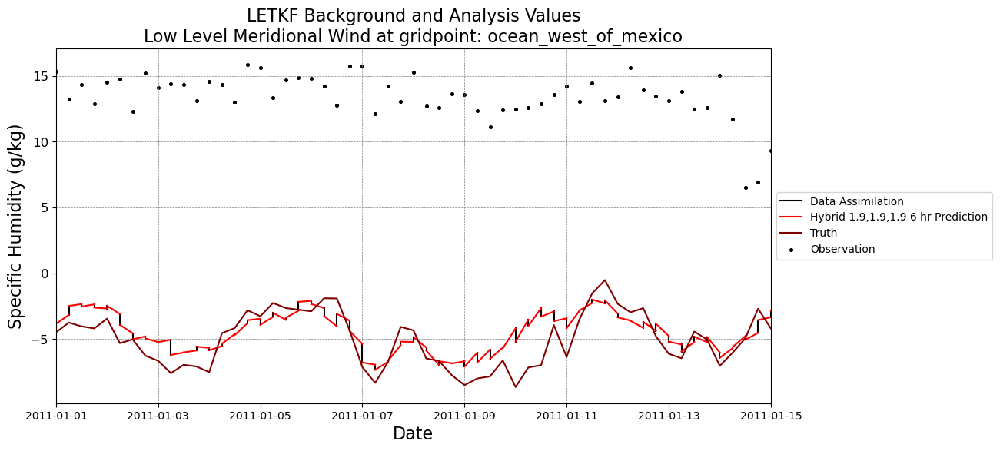

V-wind
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = V-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

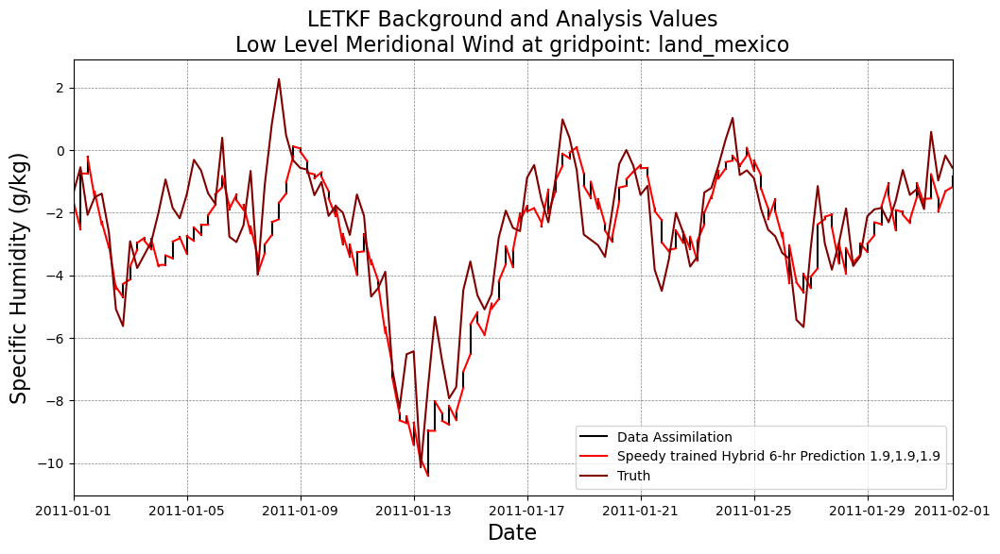

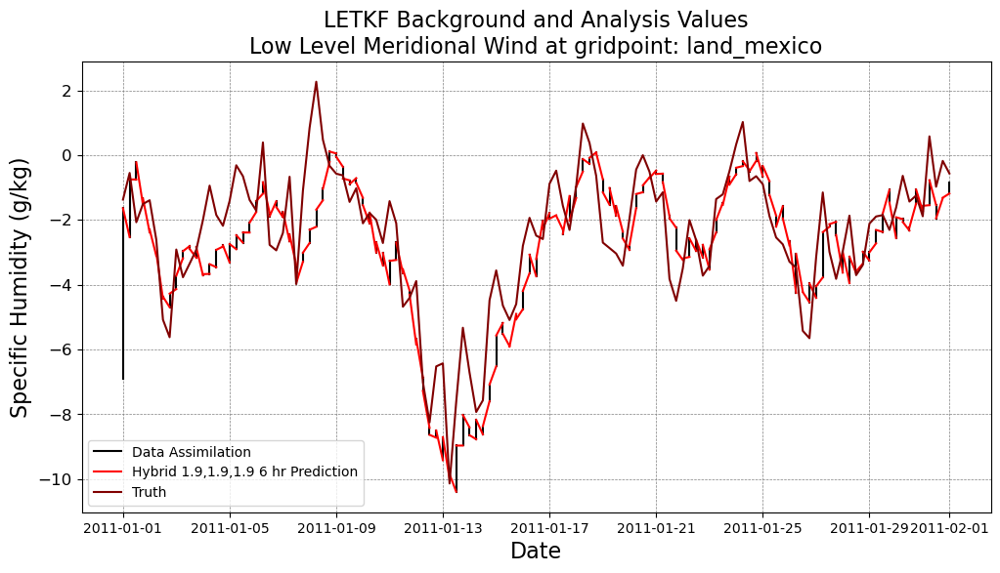

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

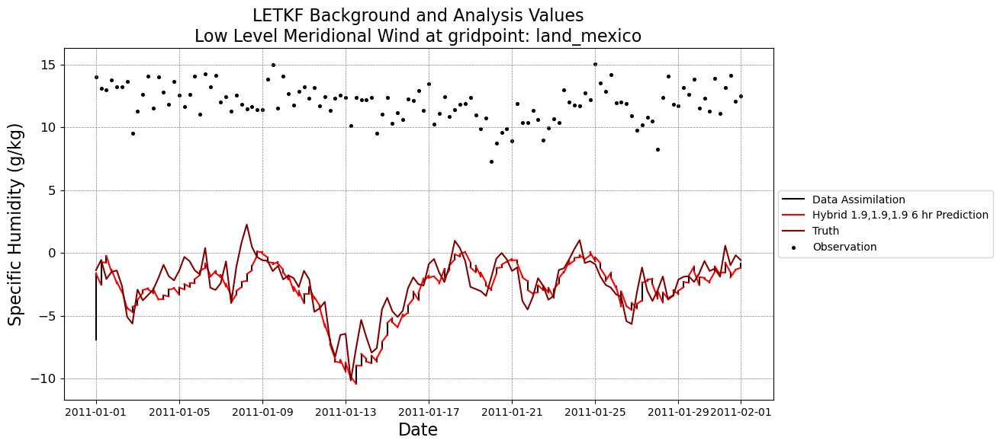

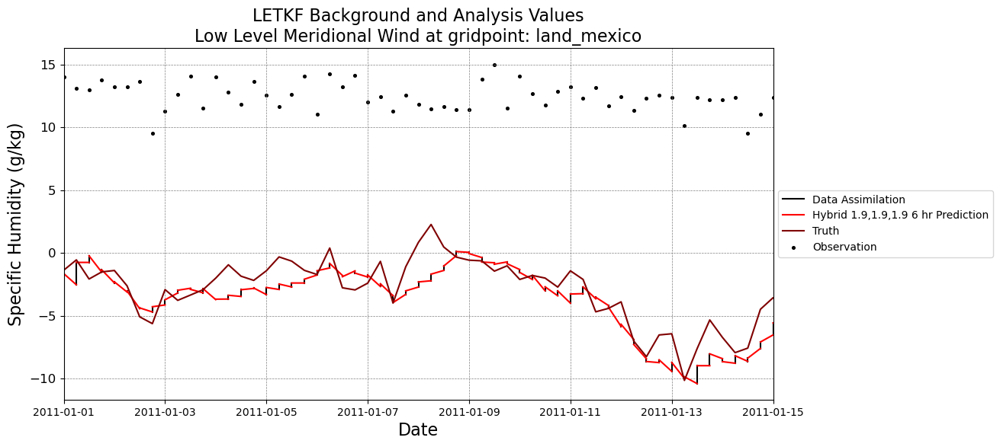

V-wind
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = V-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

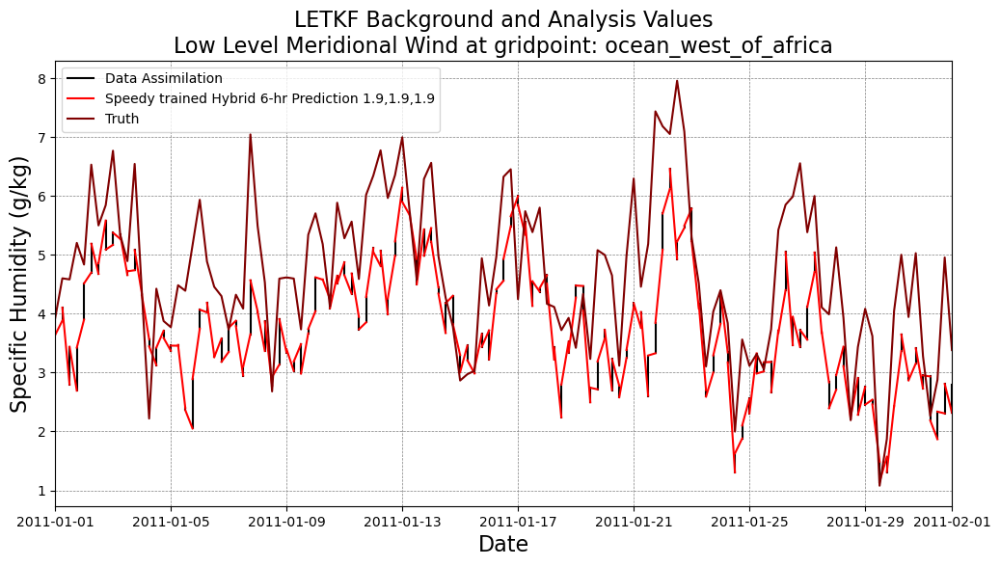

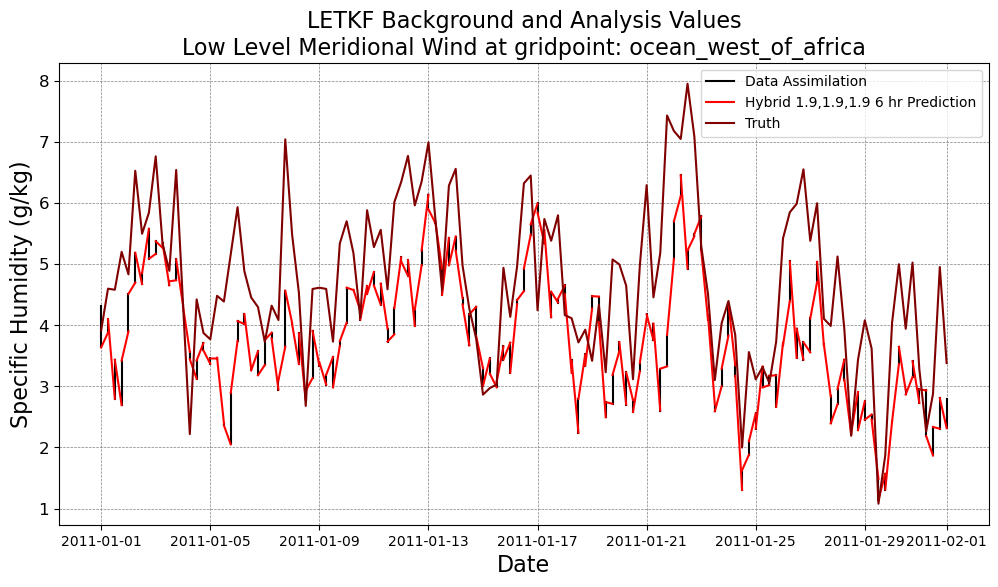

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

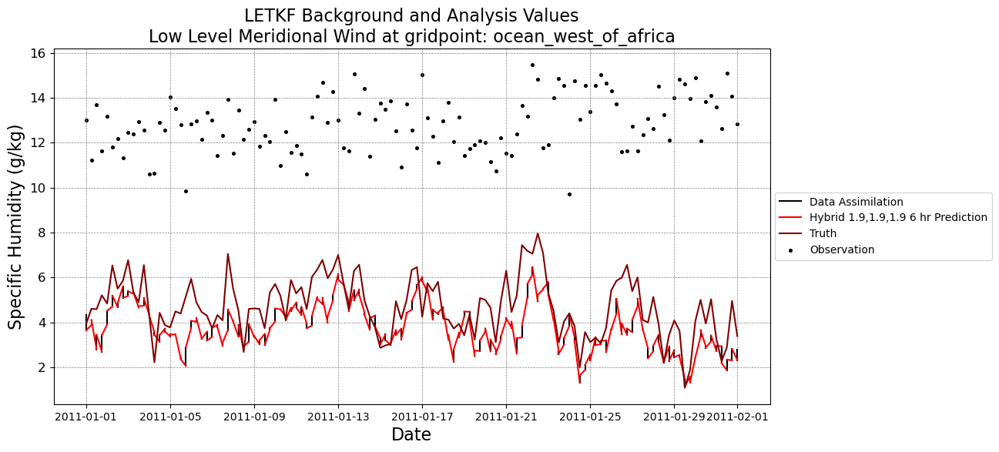

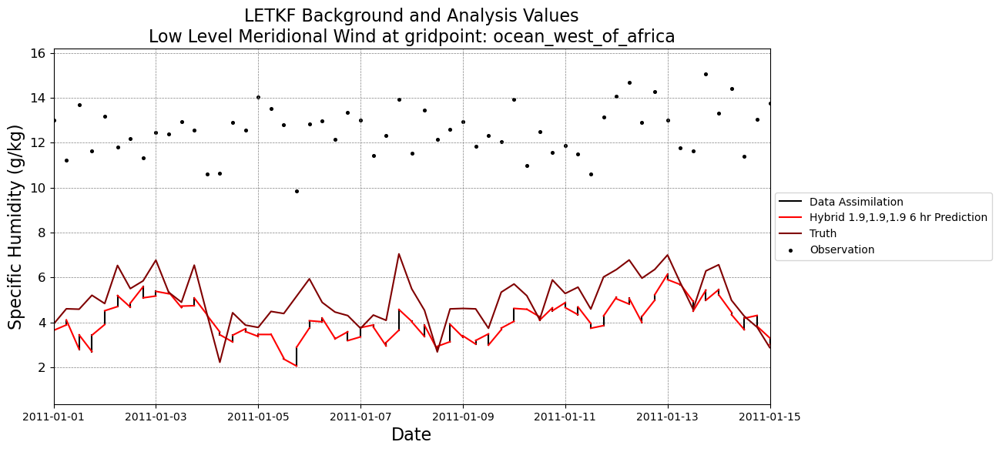

V-wind
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = V-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

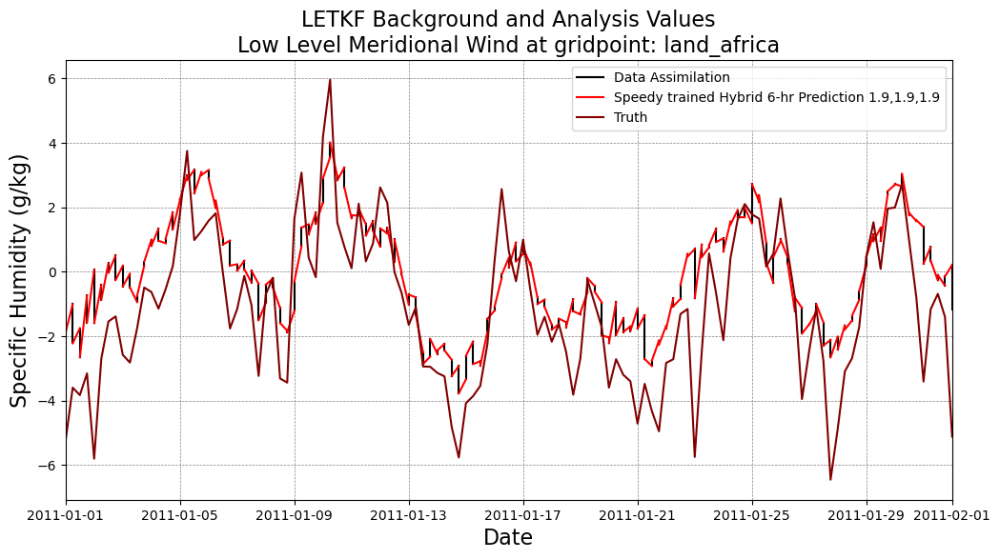

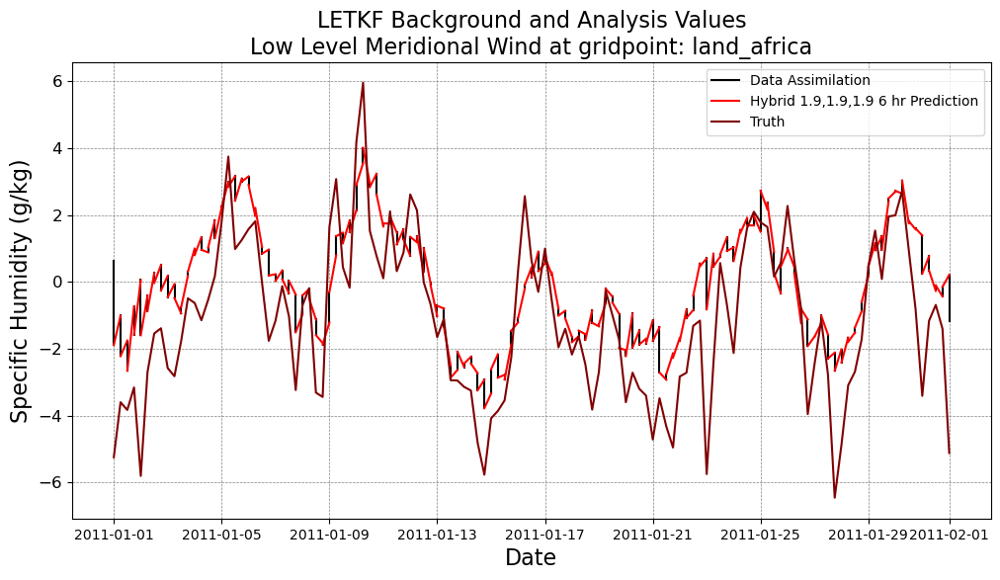

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

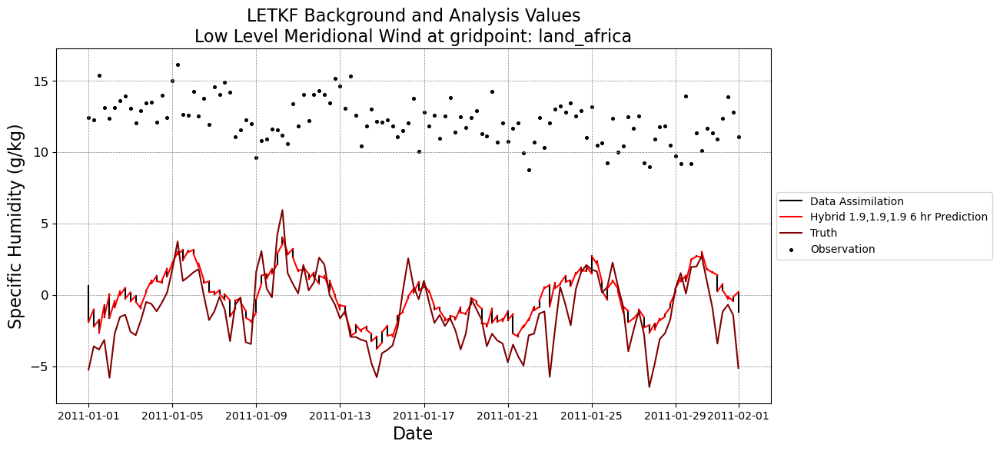

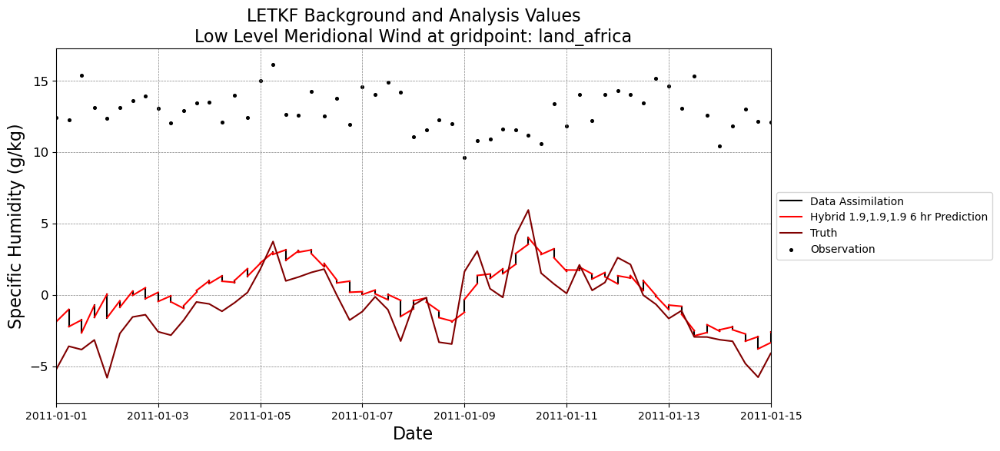

V-wind
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = V-wind
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

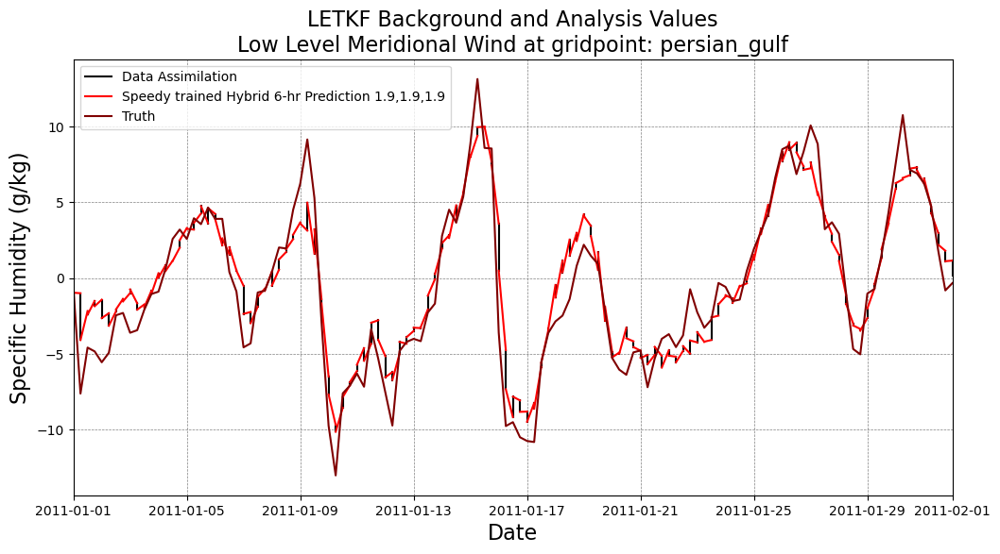

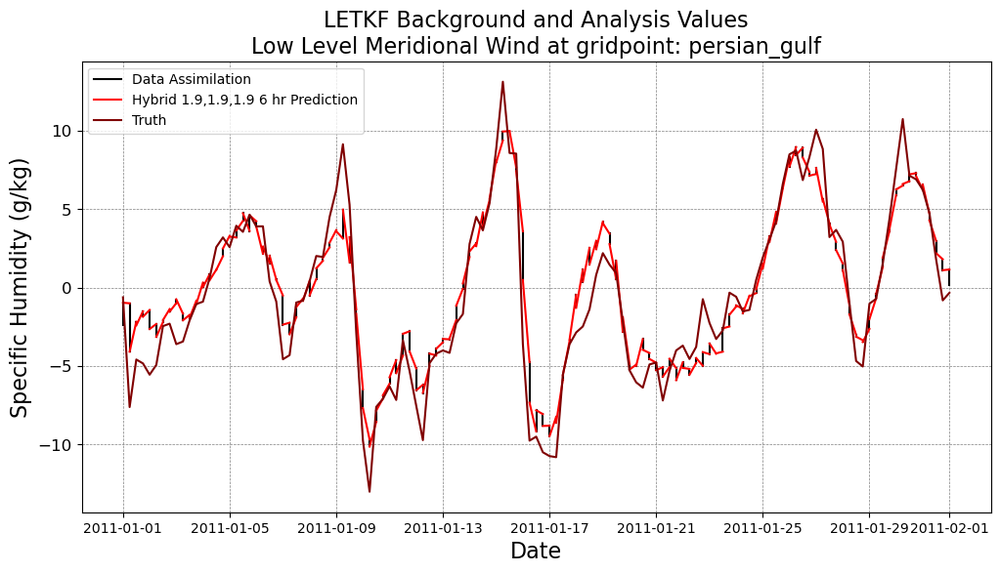

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

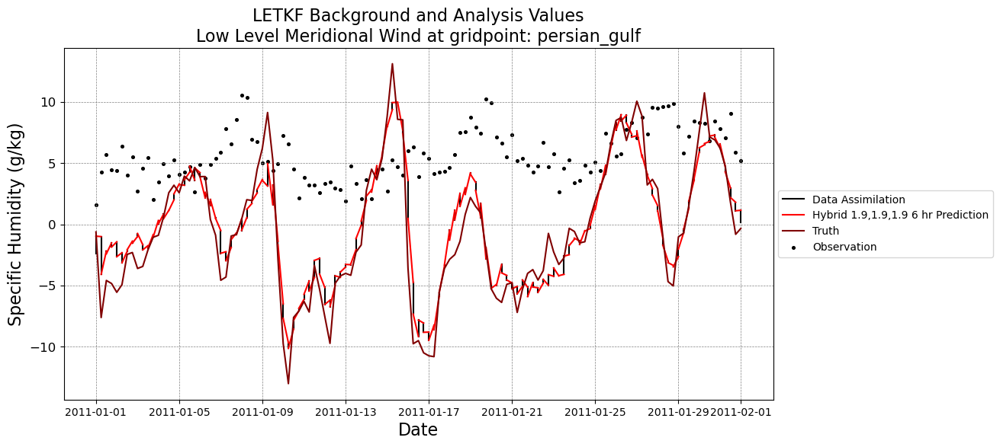

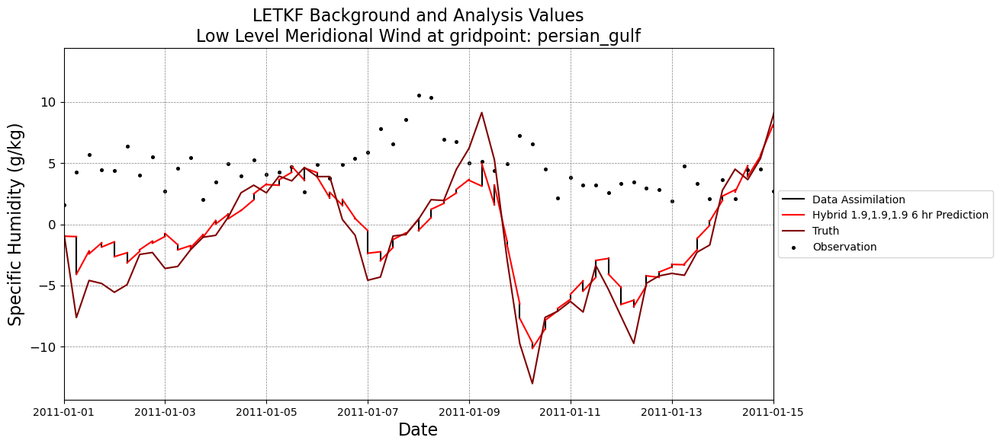

Specific_Humidity
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

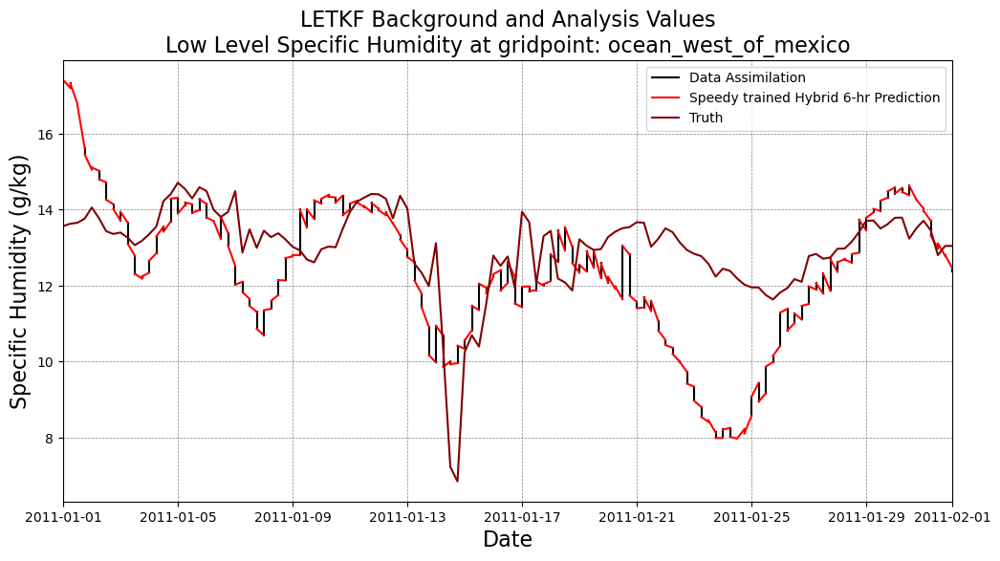

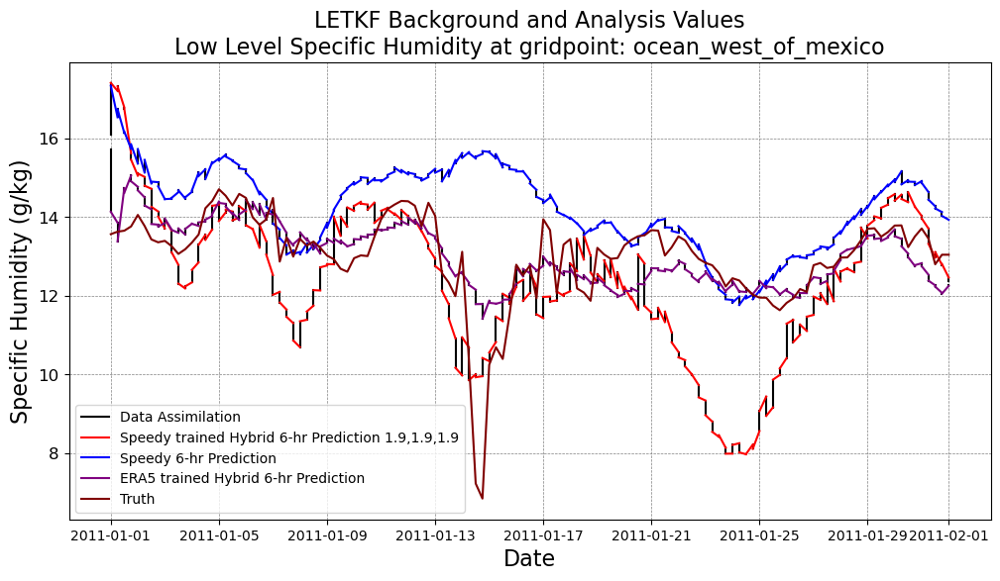

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

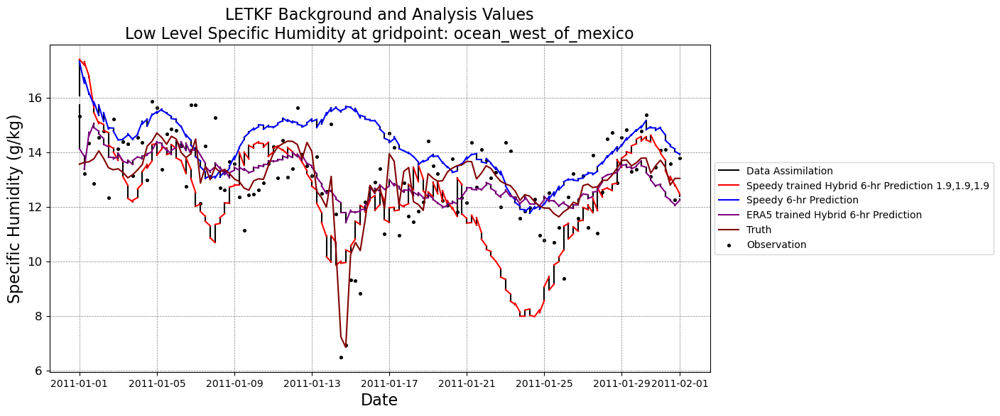

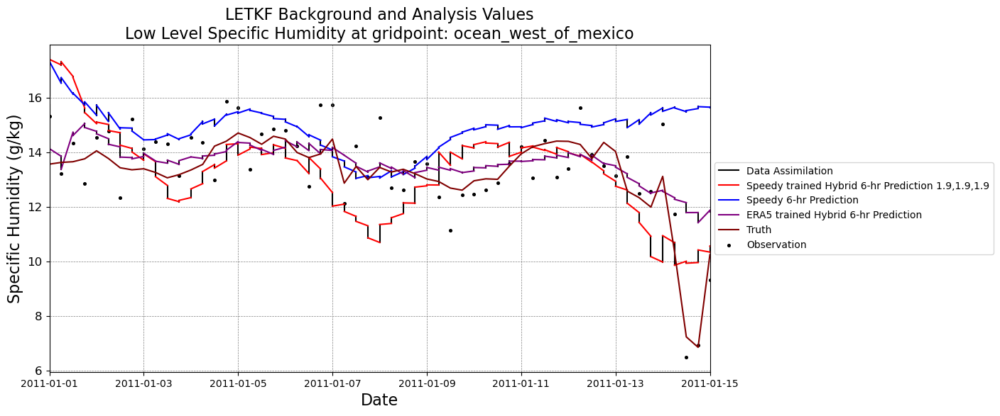

Specific_Humidity
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

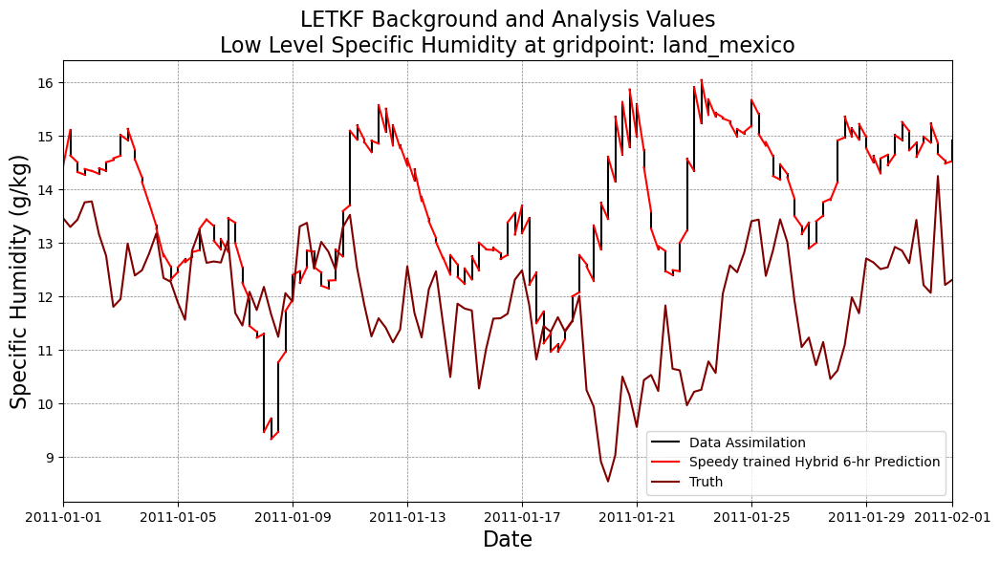

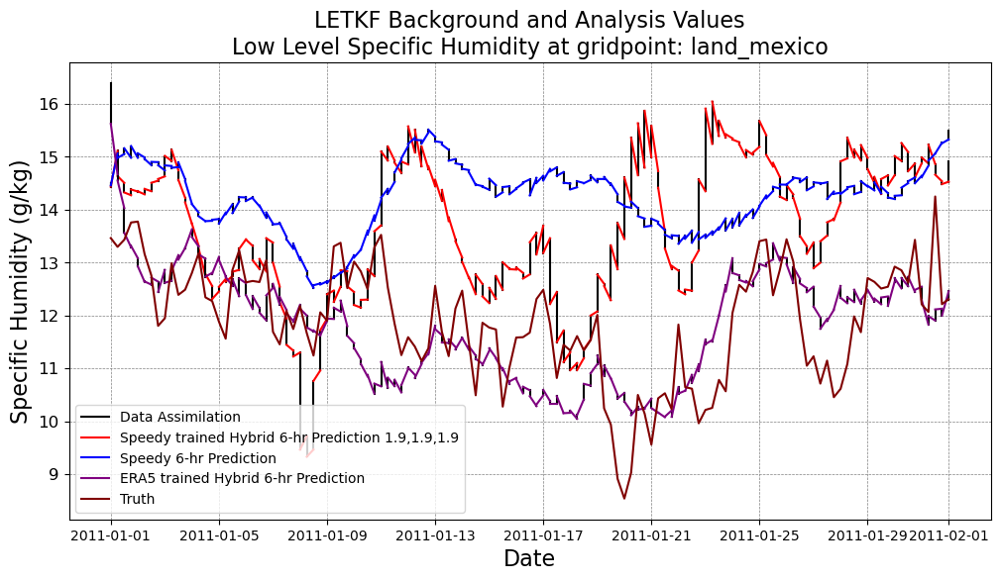

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

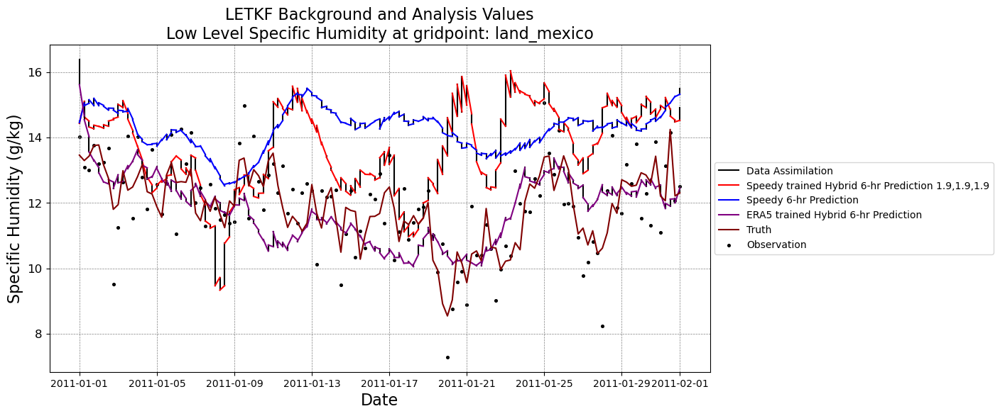

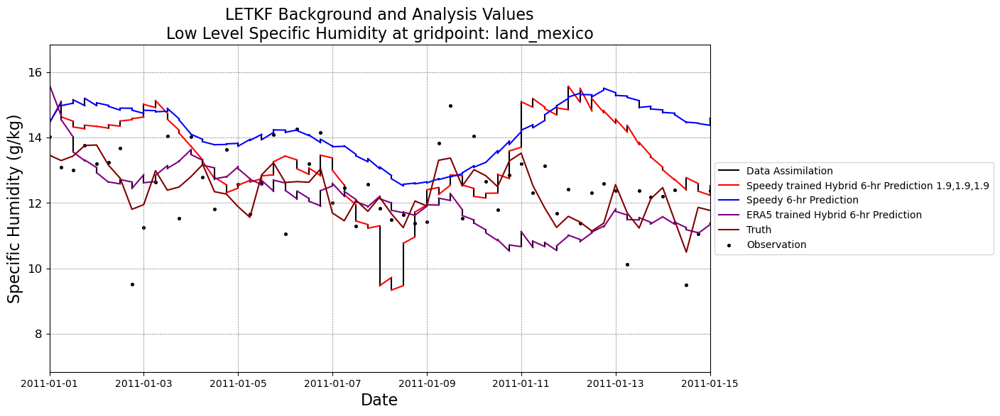

Specific_Humidity
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

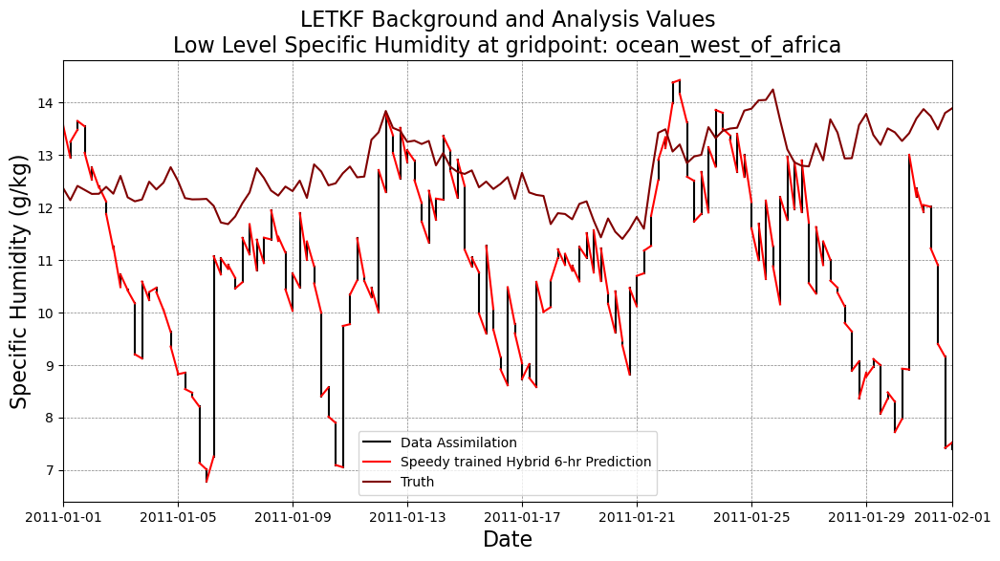

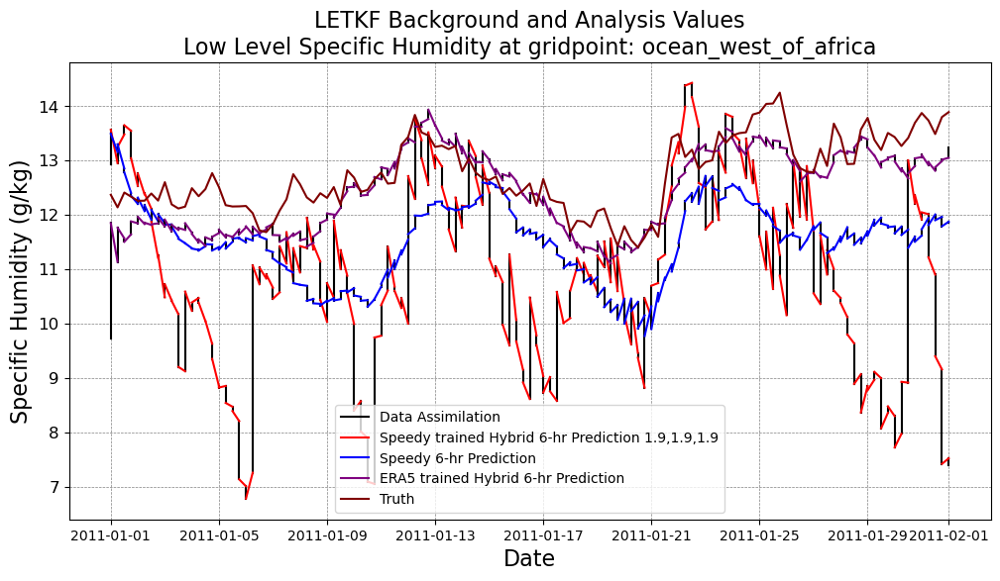

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

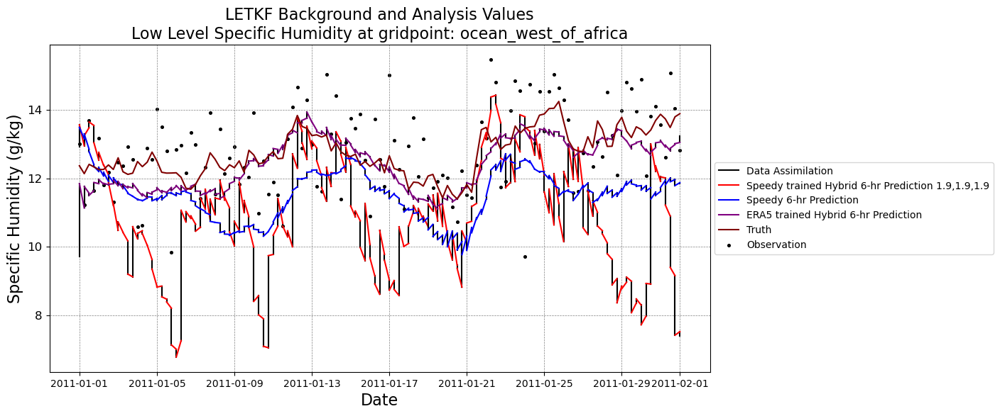

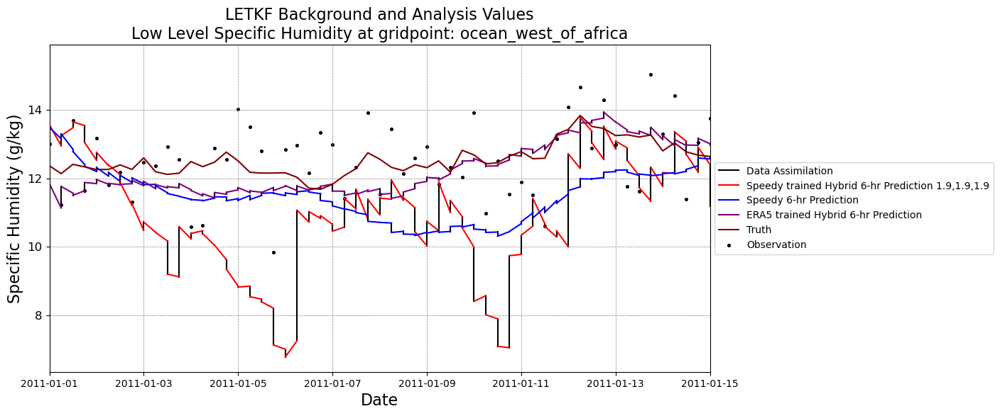

Specific_Humidity
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

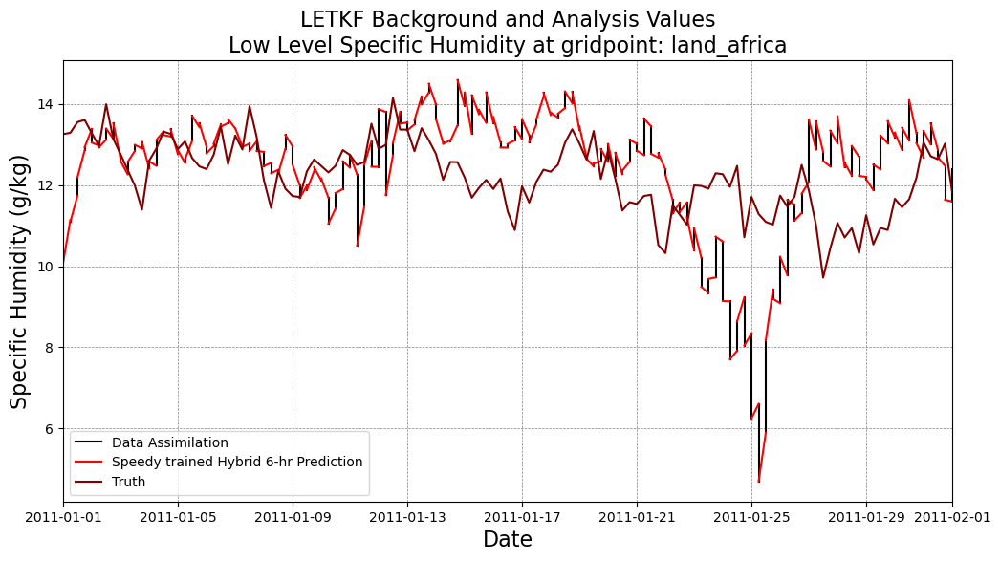

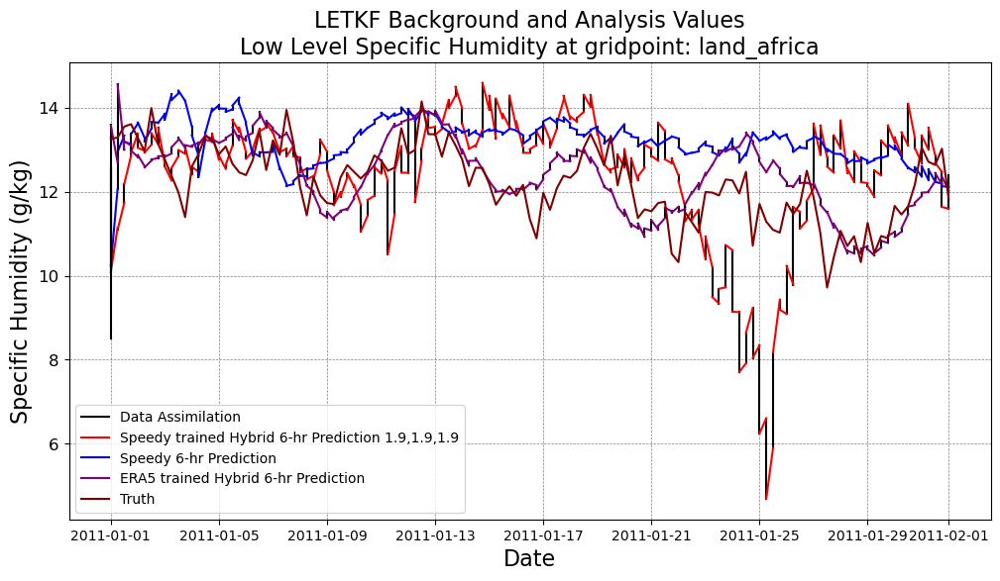

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

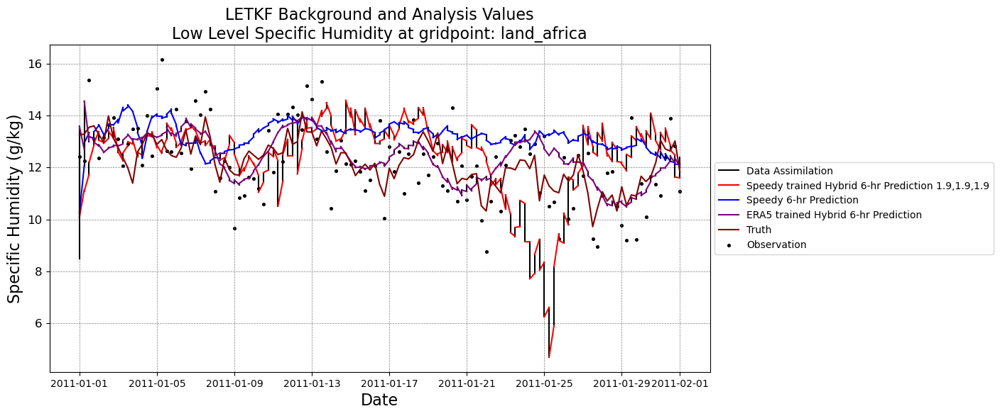

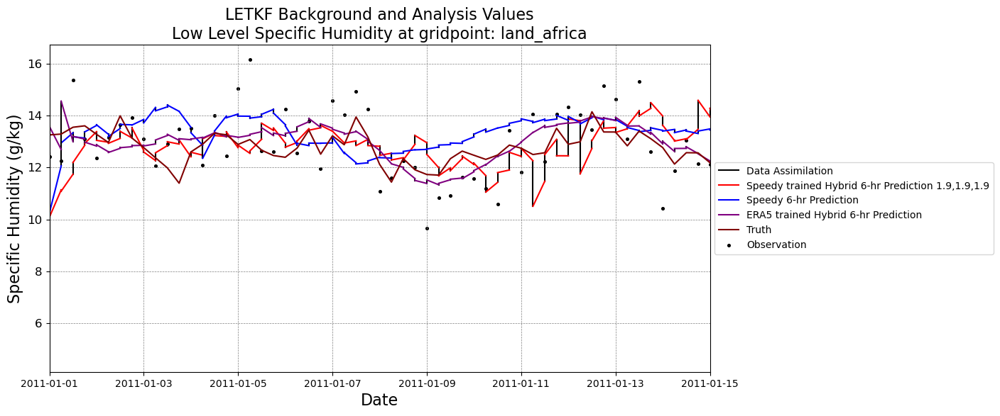

Specific_Humidity
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = Specific_Humidity
at level = 0.95
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.95
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

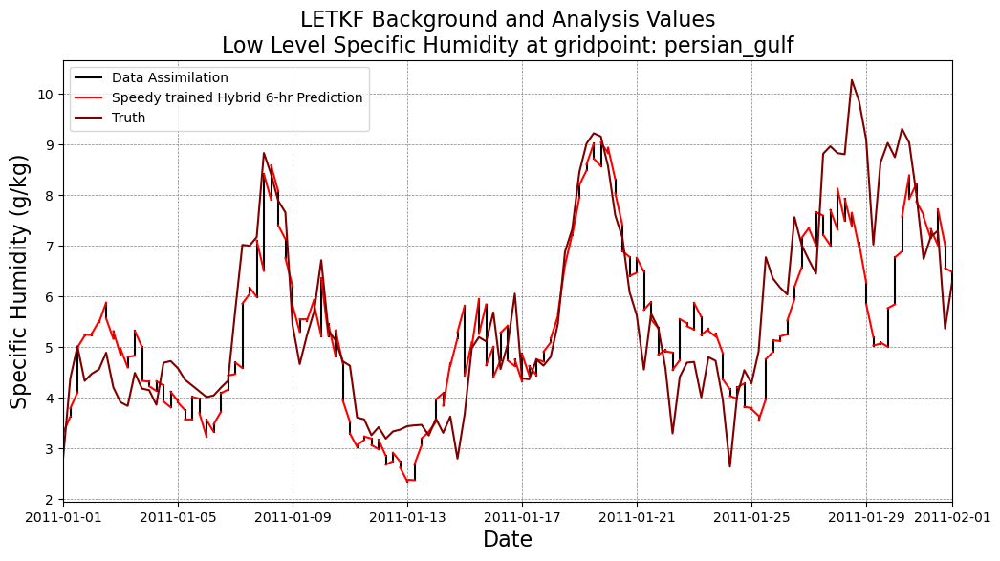

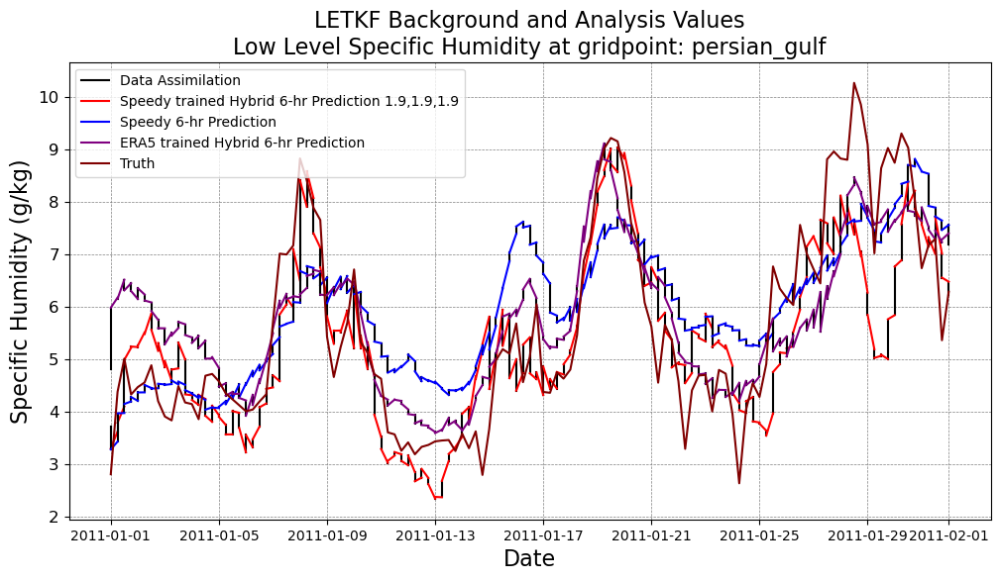

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

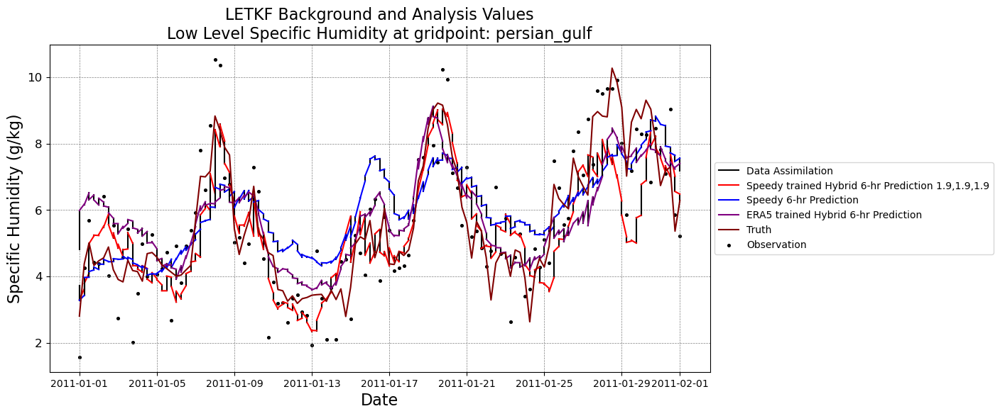

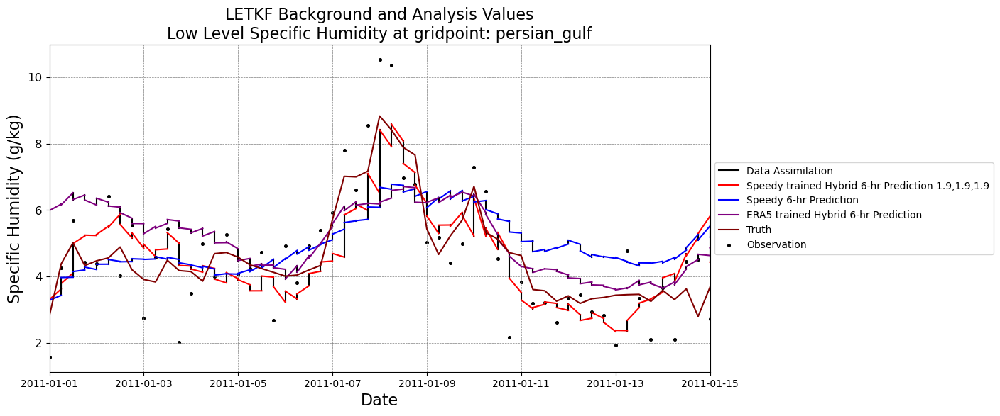

U-wind
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = U-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

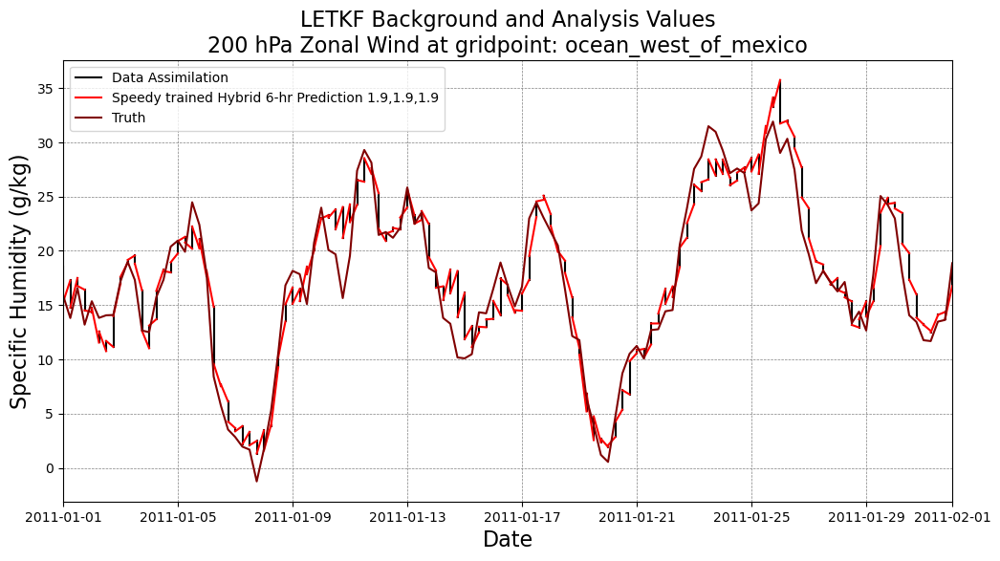

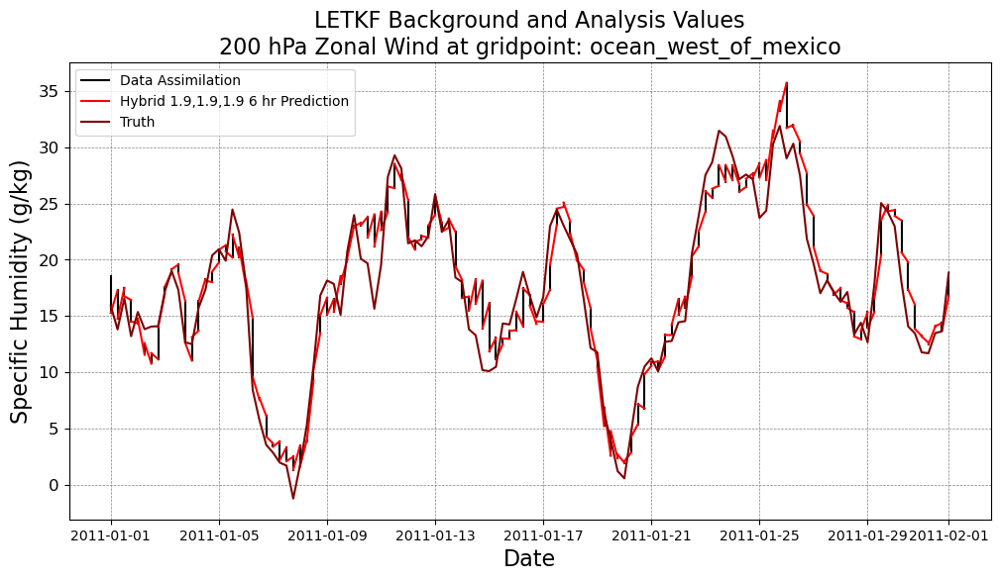

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

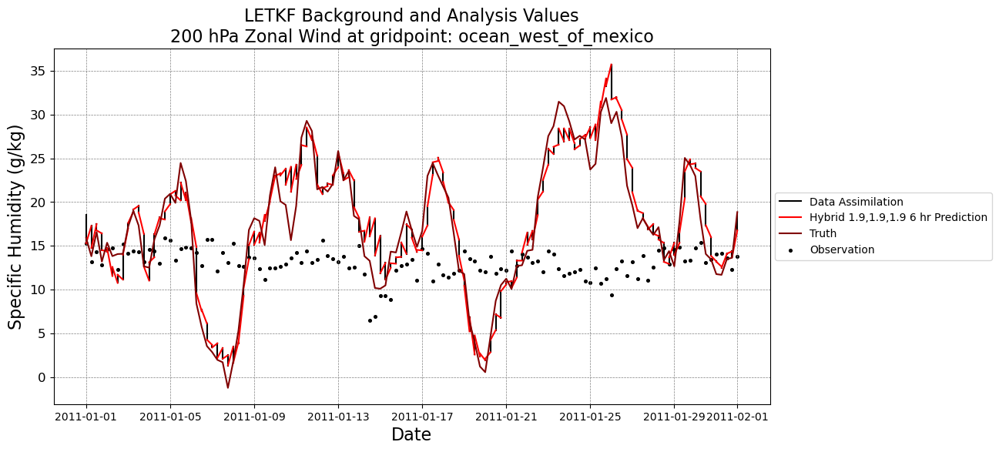

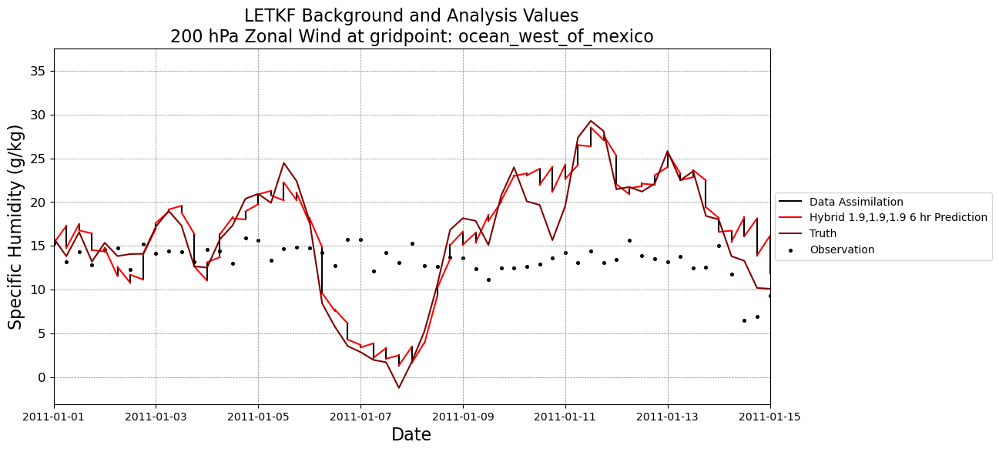

U-wind
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = U-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

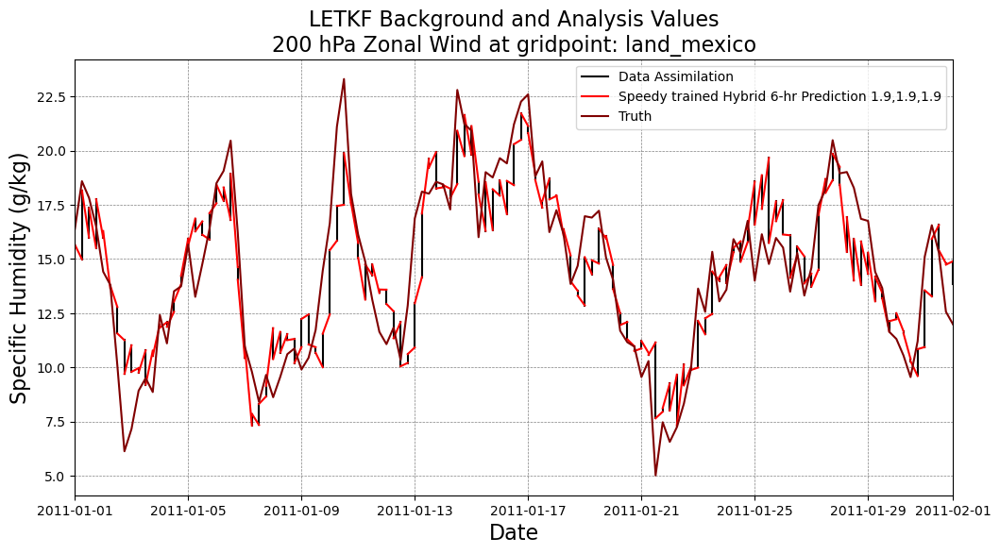

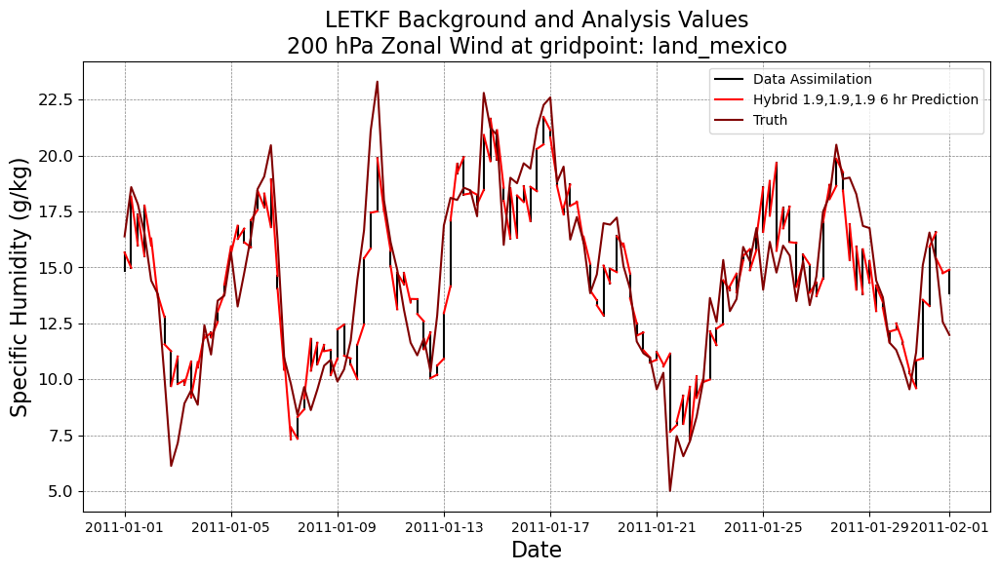

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

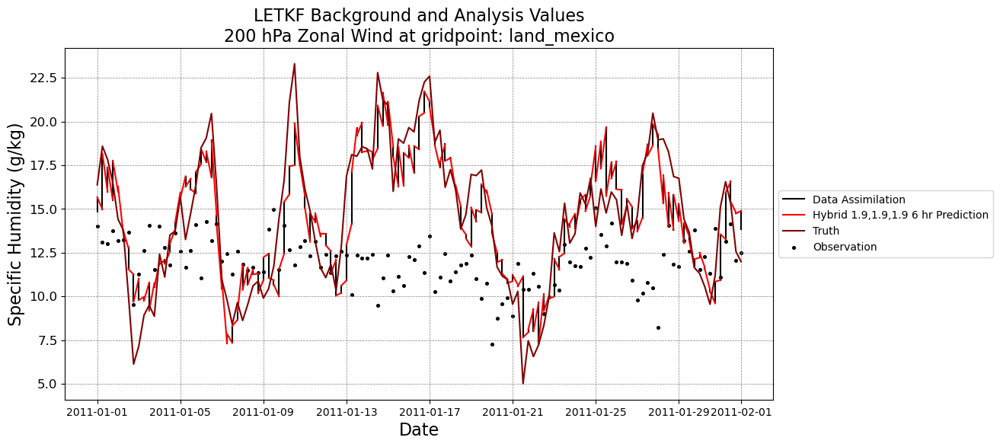

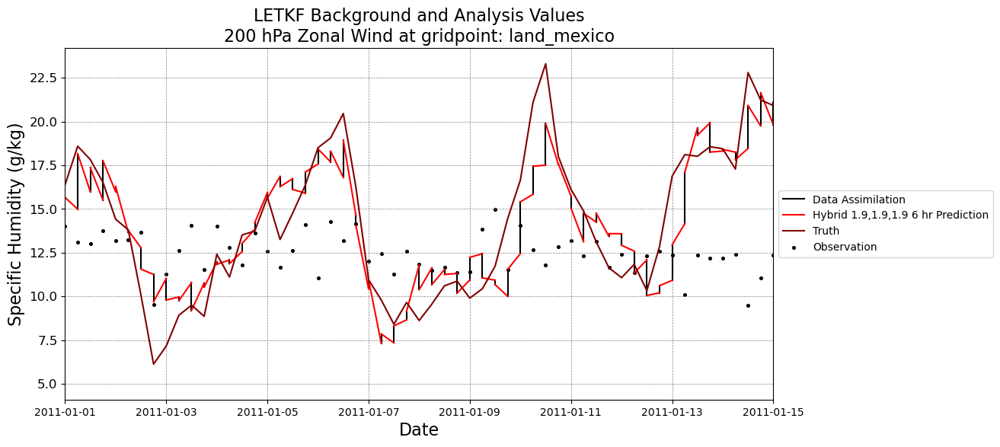

U-wind
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = U-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

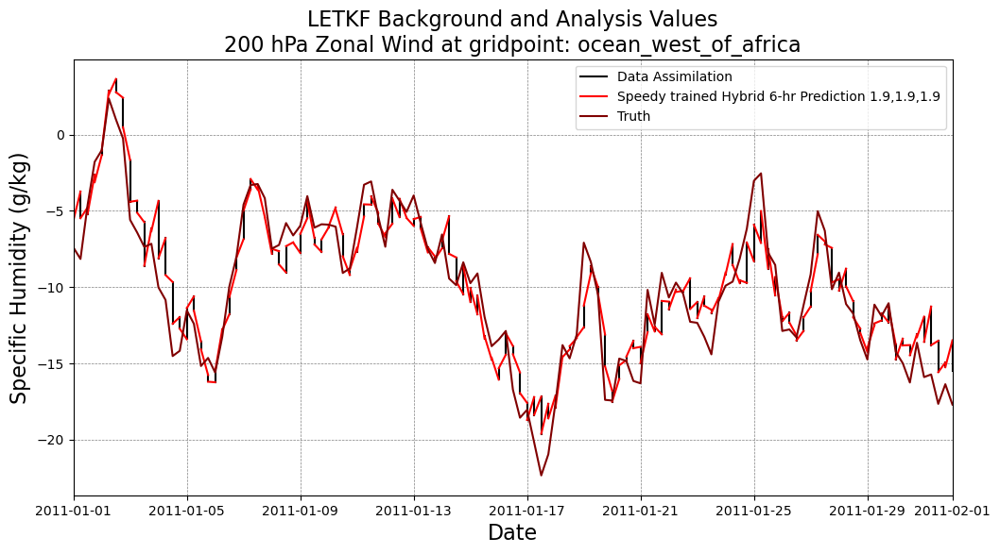

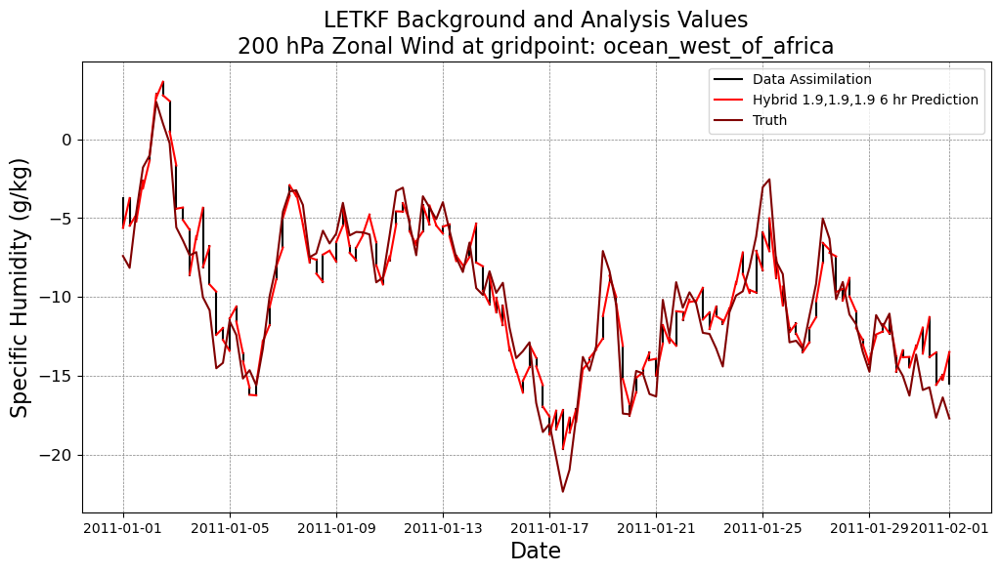

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

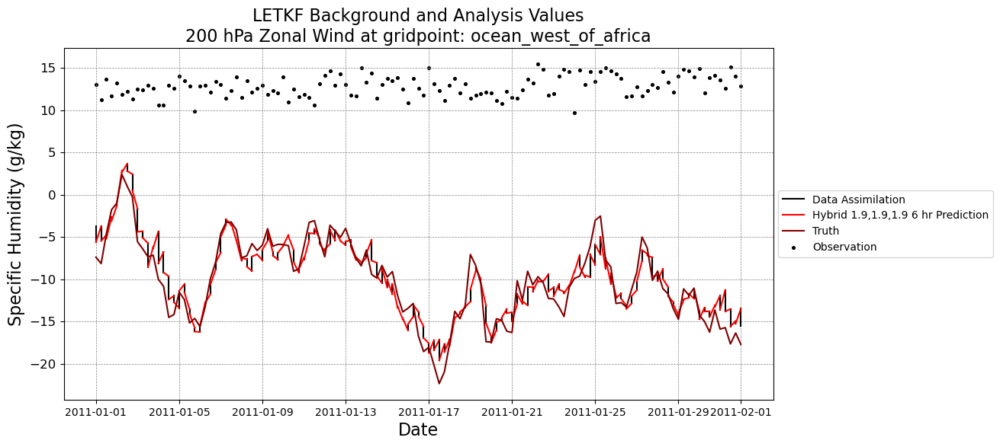

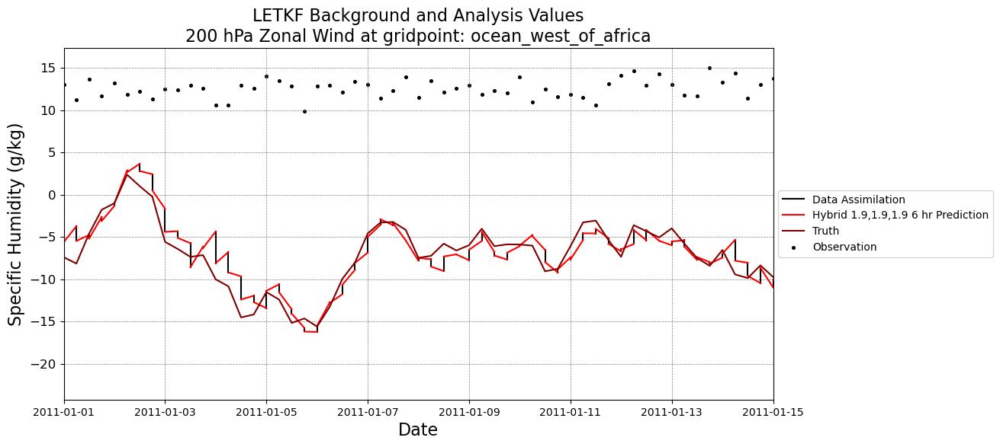

U-wind
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = U-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

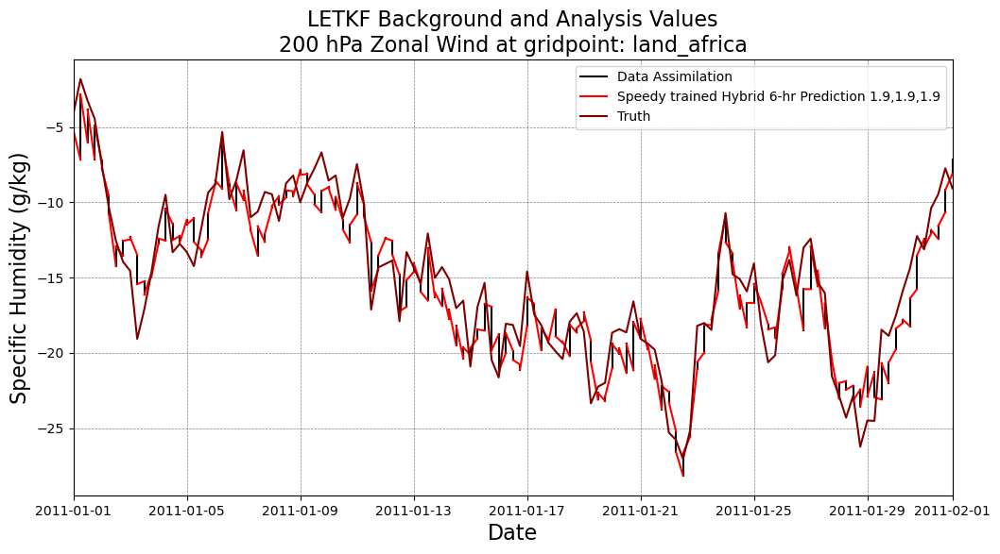

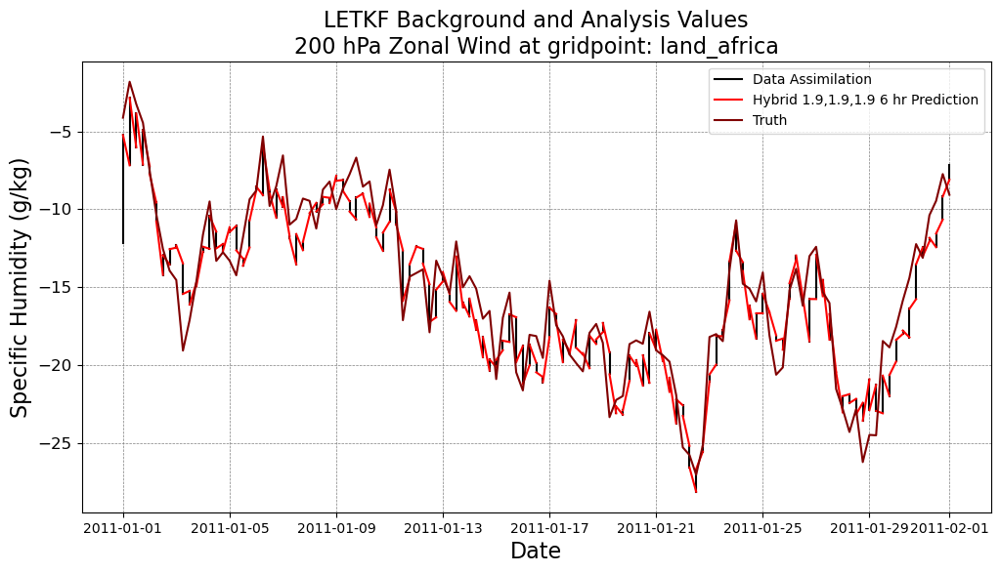

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

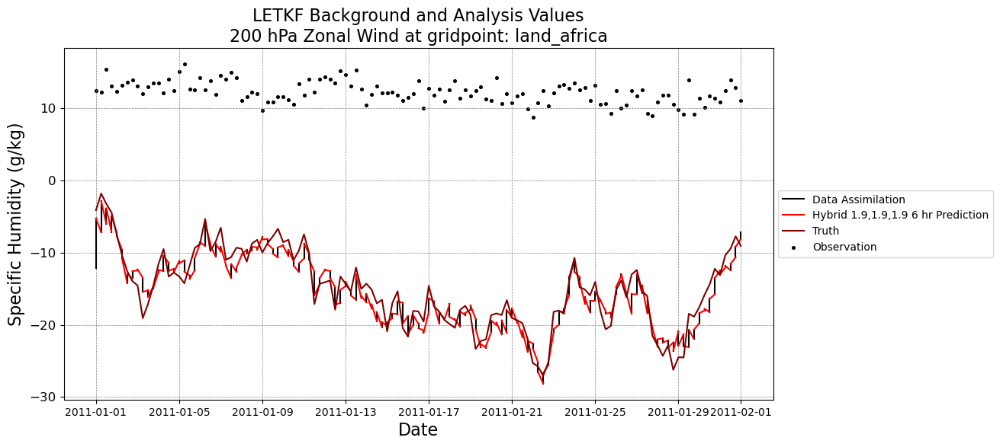

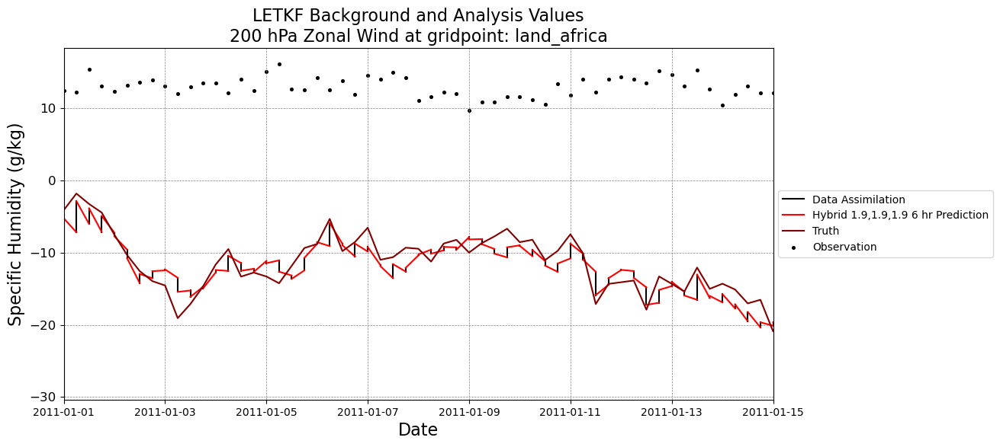

U-wind
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = U-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = U-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Zonal Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

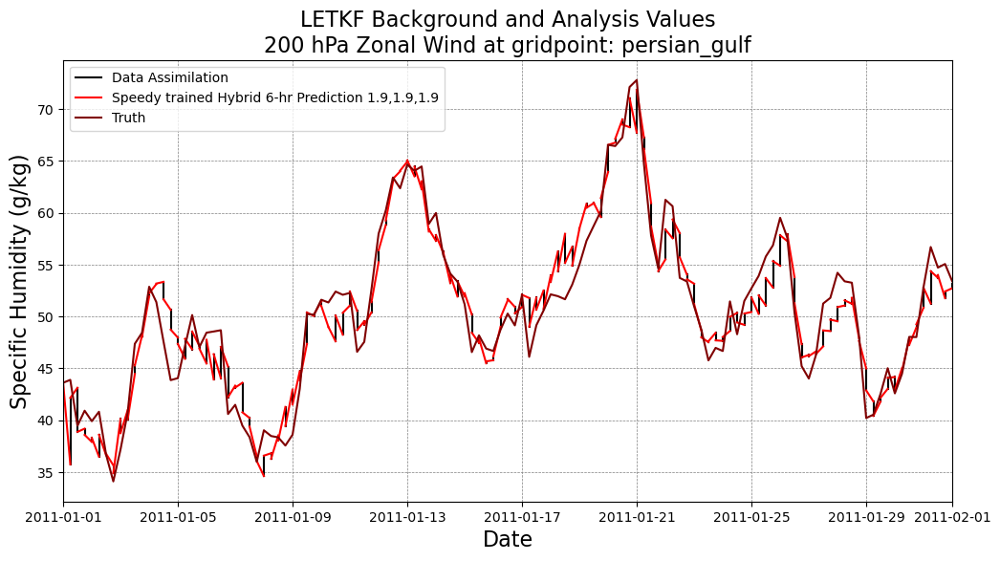

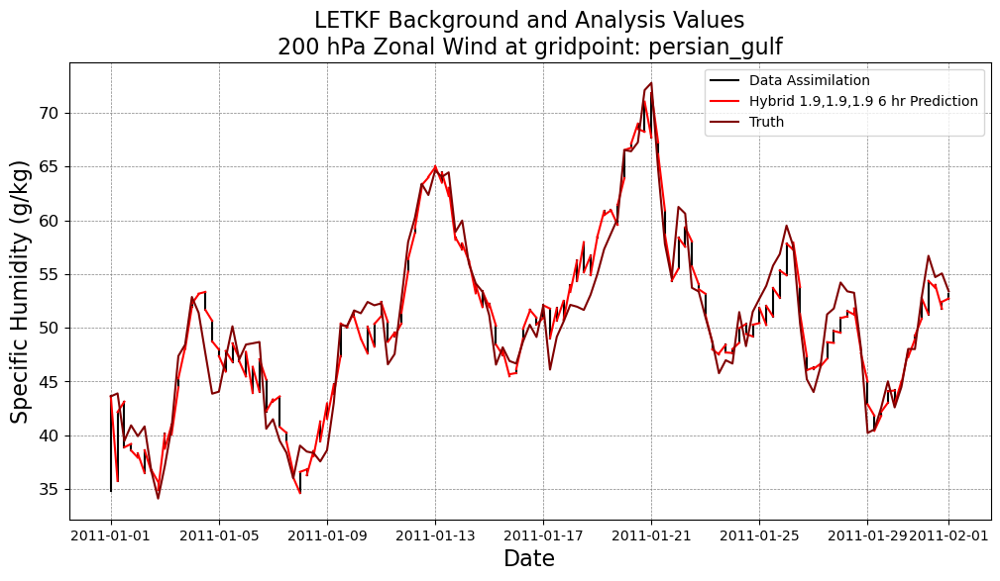

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

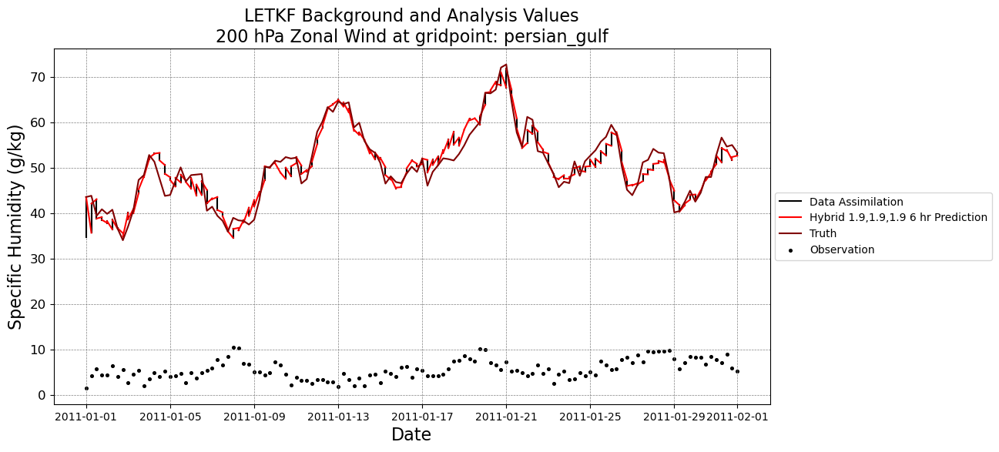

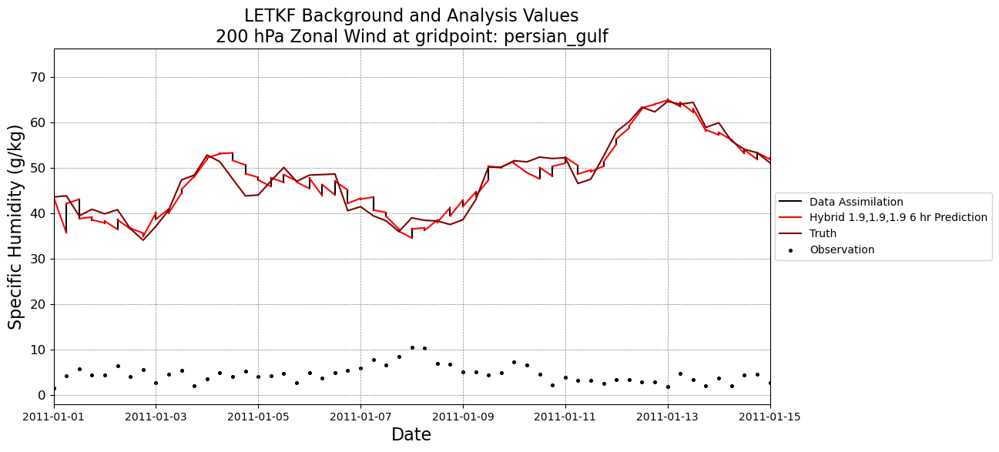

Temperature
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = Temperature
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

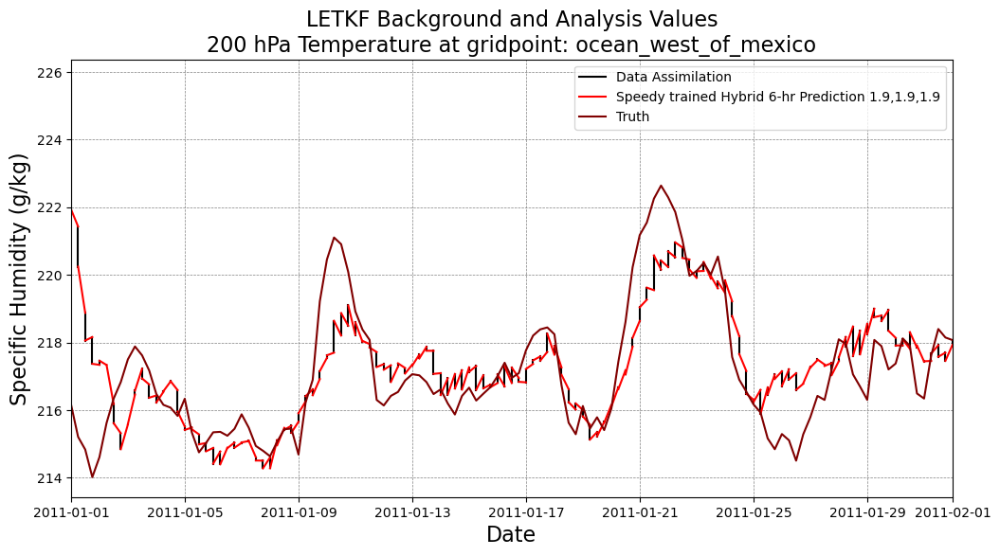

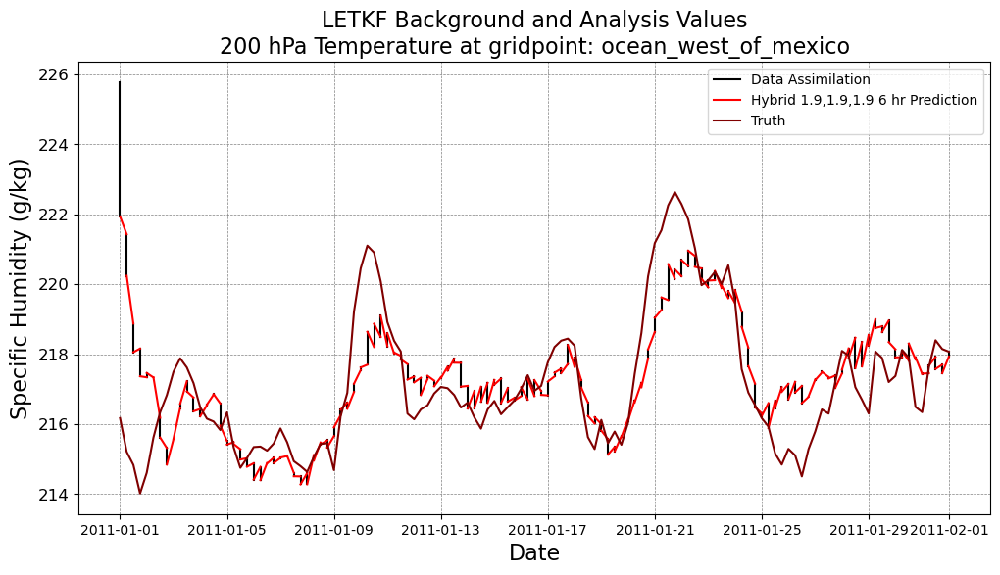

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

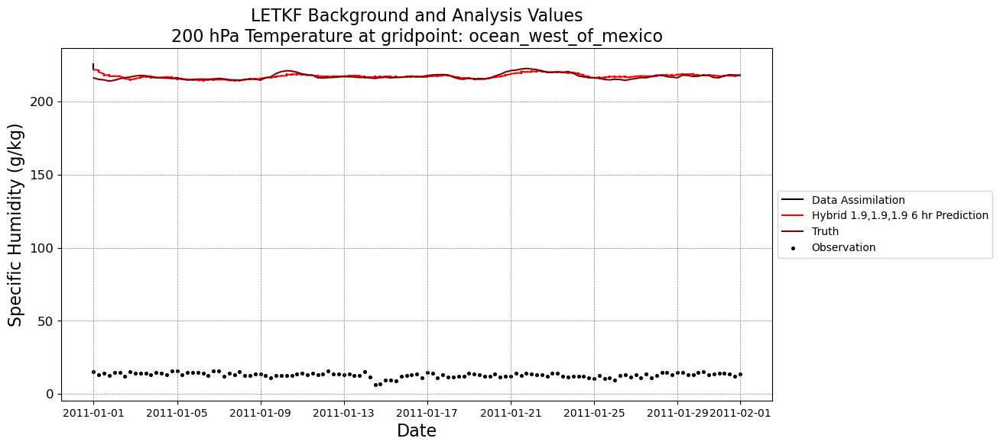

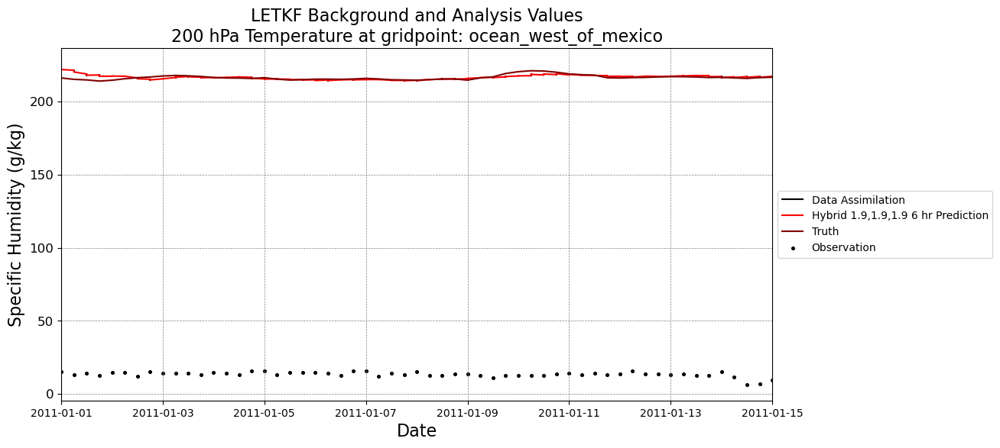

Temperature
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = Temperature
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

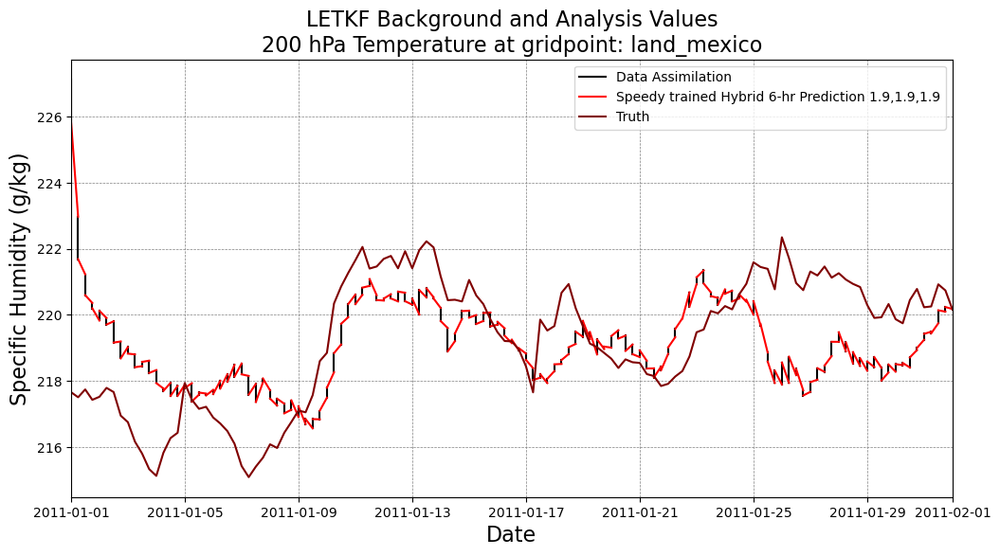

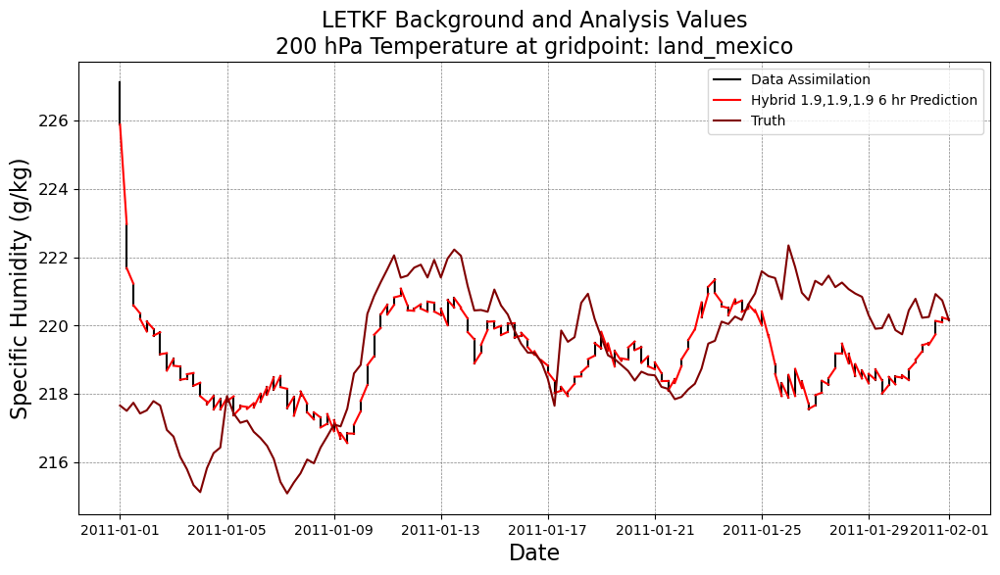

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

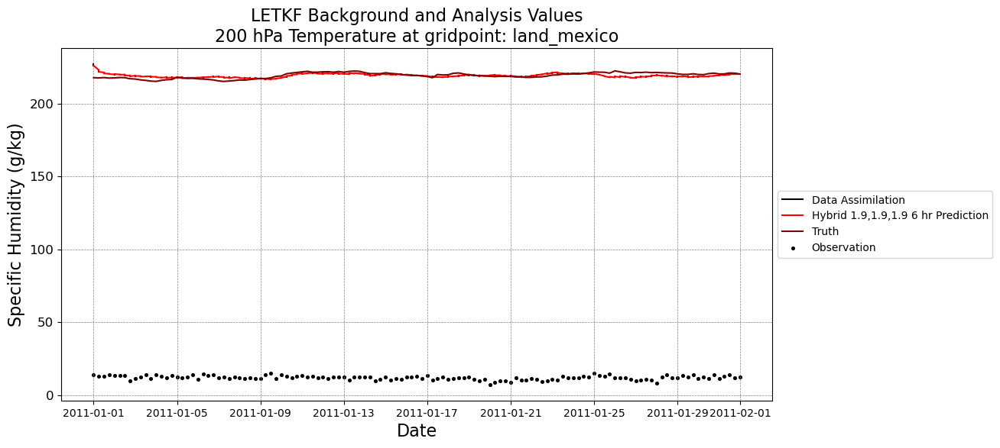

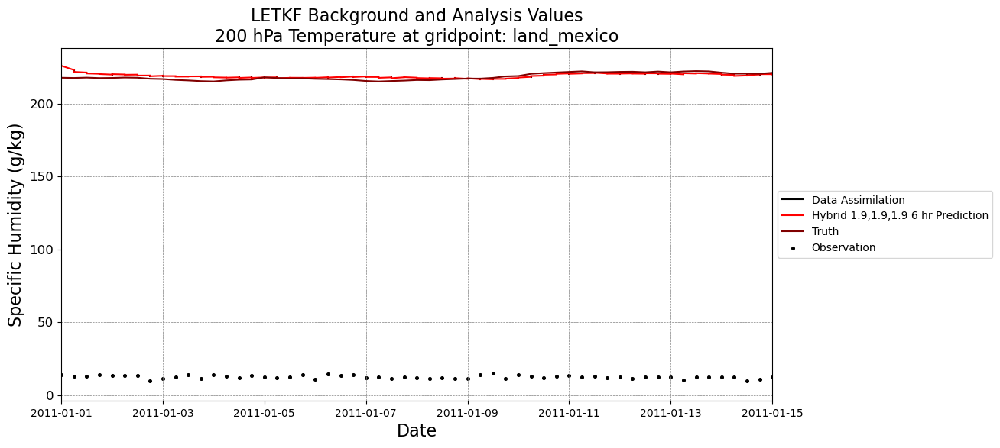

Temperature
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = Temperature
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

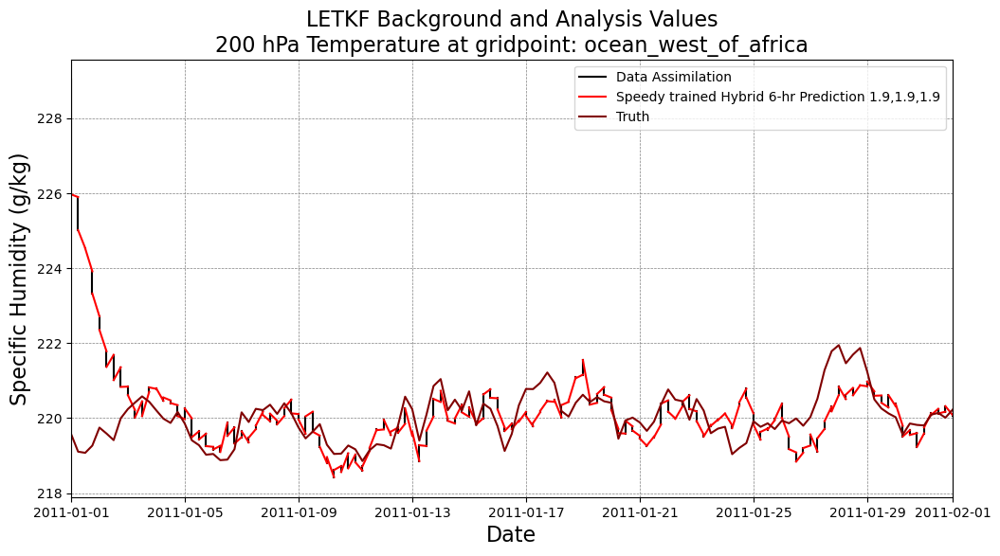

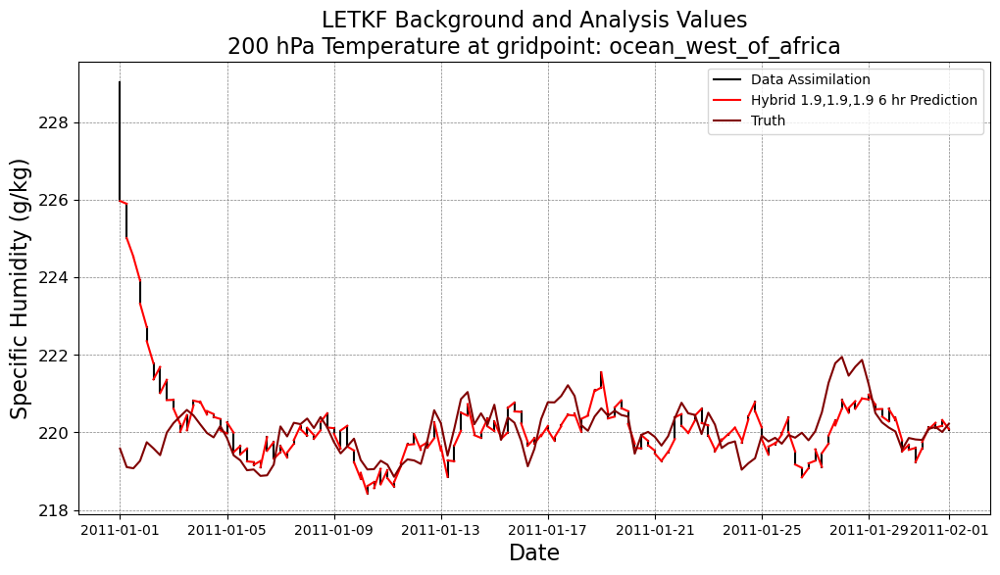

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012206.dat
Processing 86 of 1460 timesteps
/skydata2/

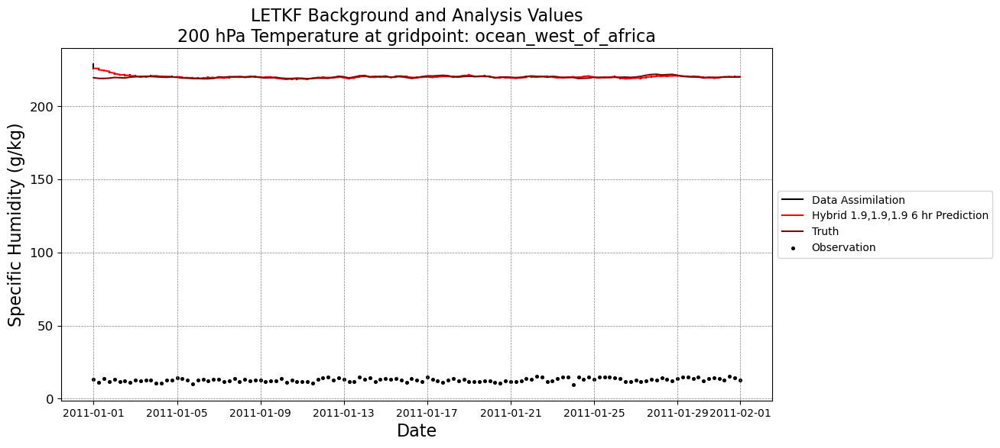

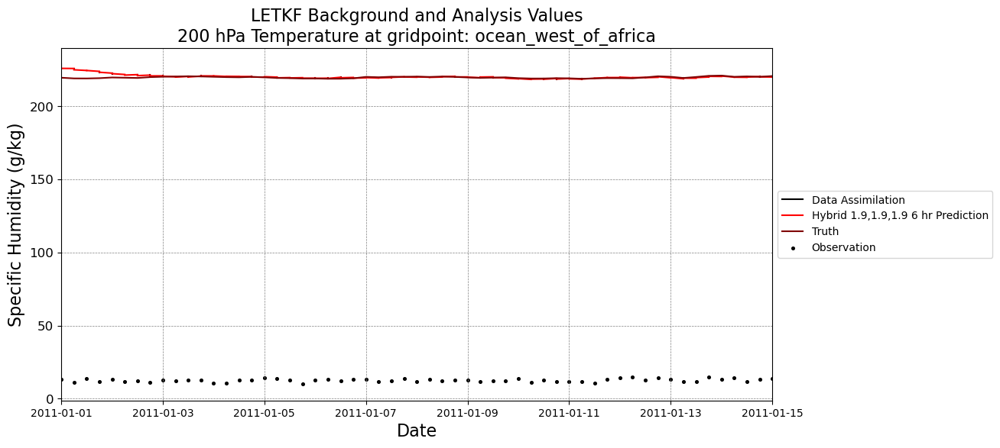

Temperature
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = Temperature
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

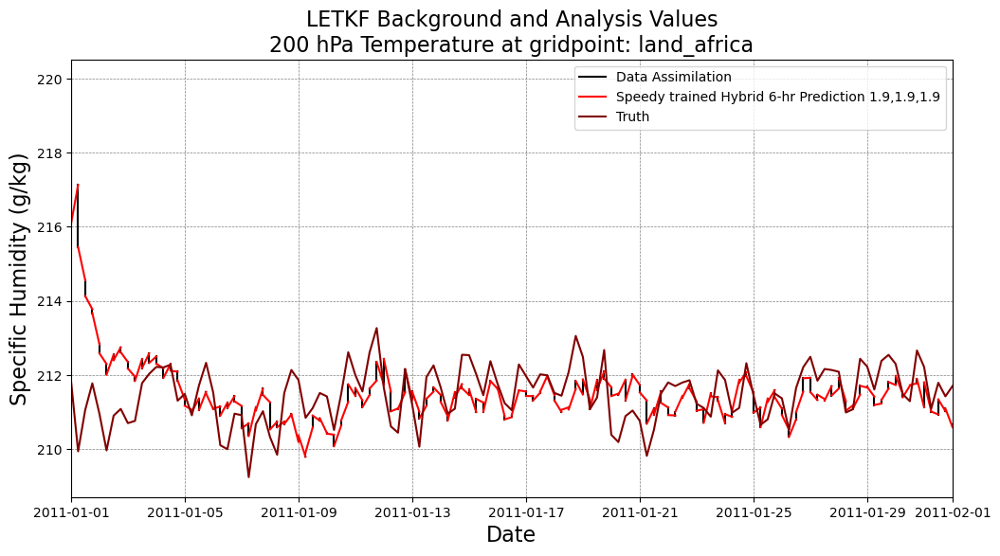

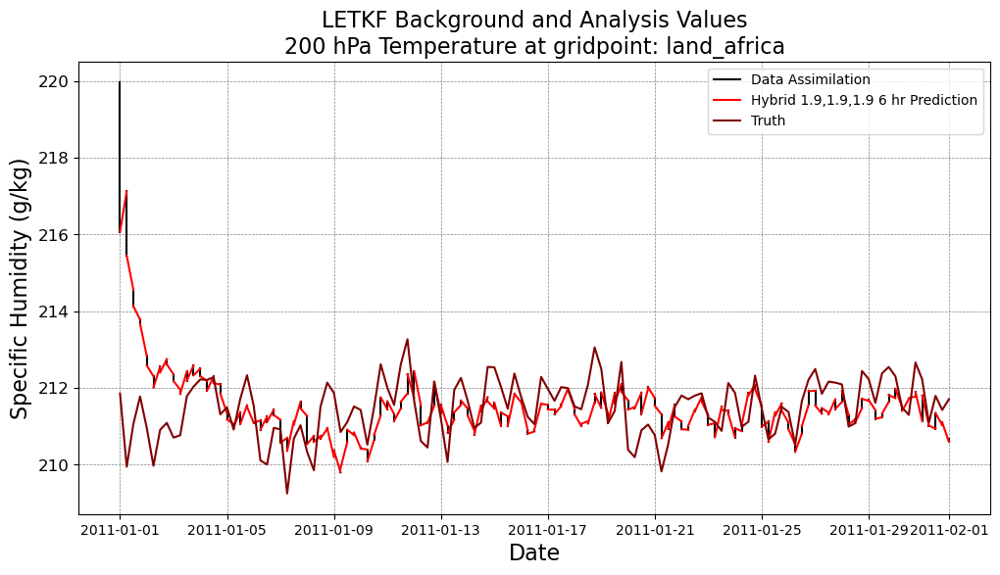

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

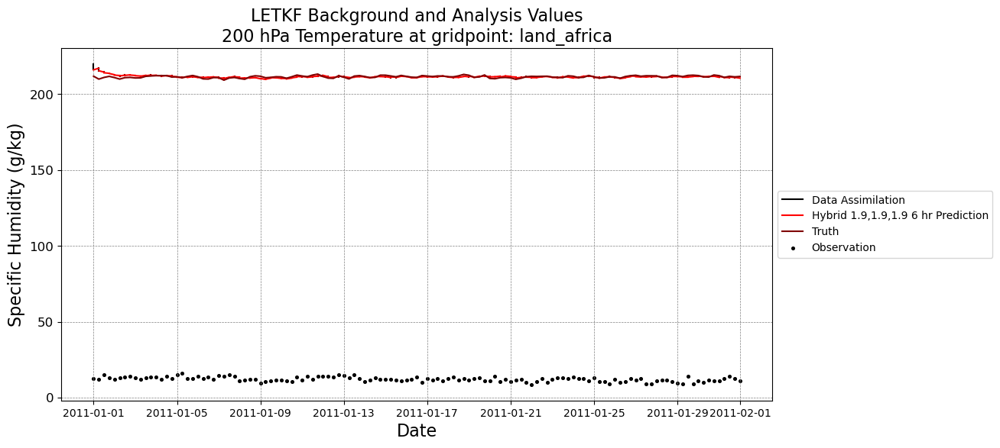

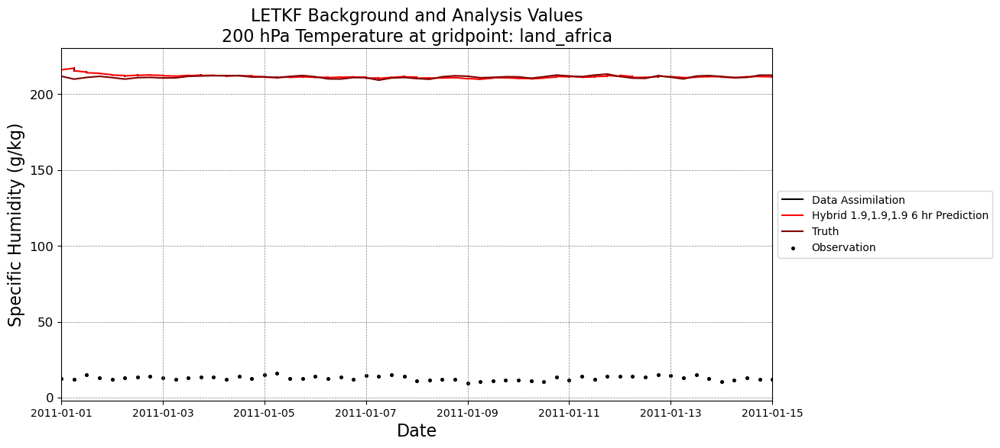

Temperature
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = Temperature
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Temperature
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(K)
Temperature
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

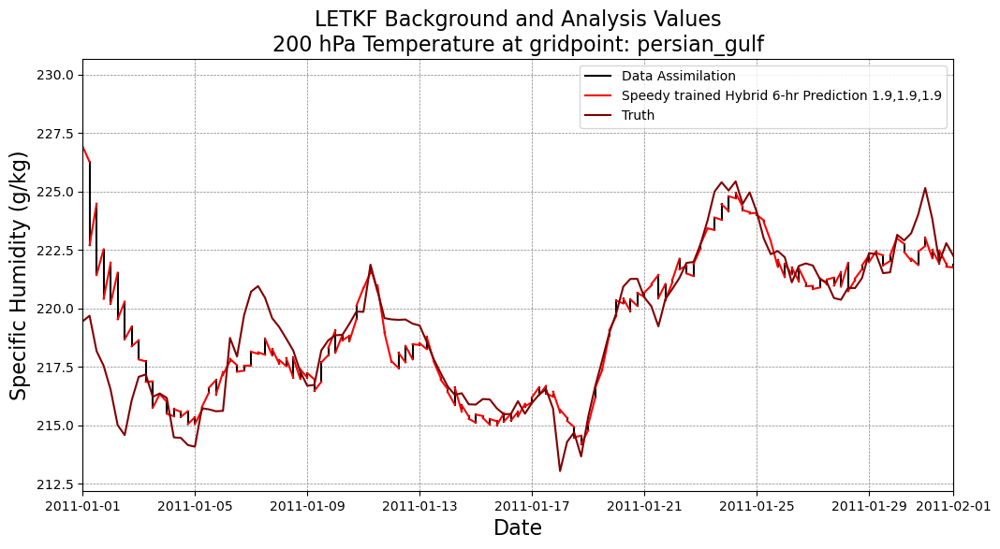

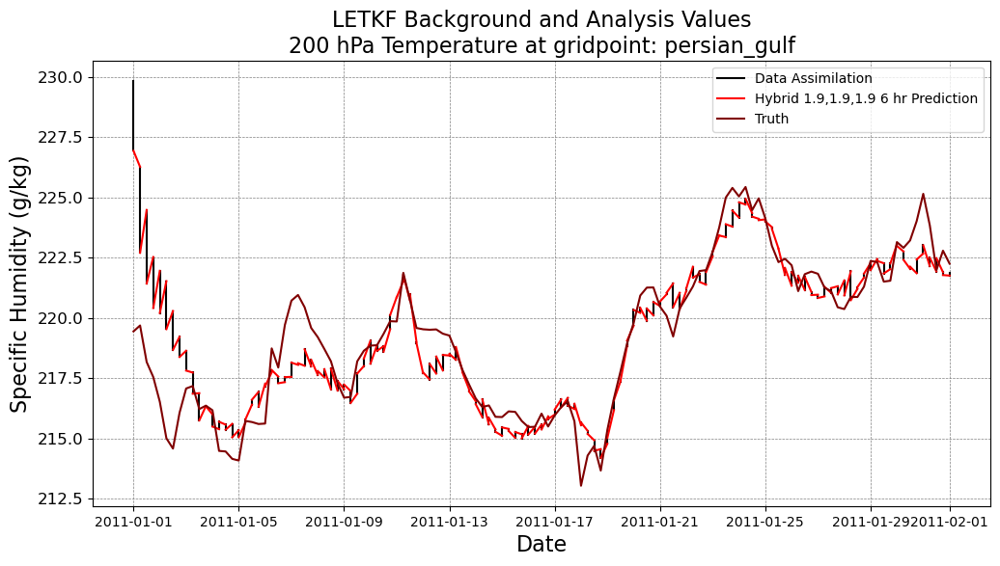

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

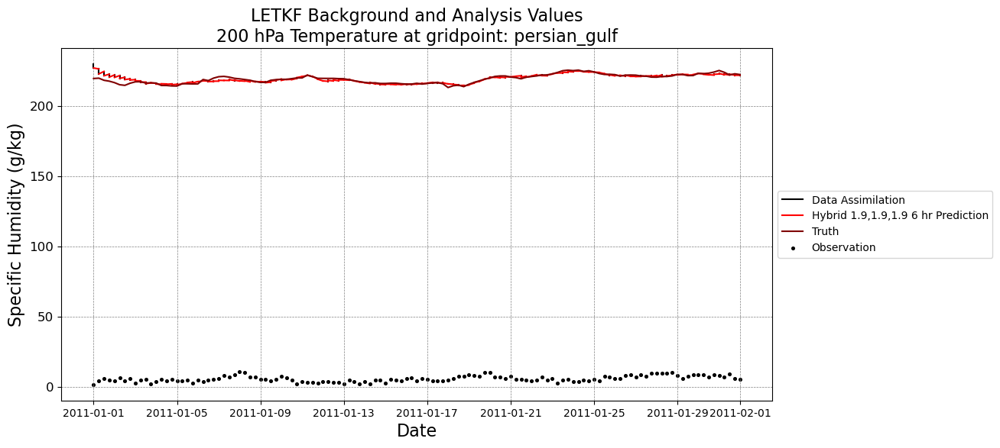

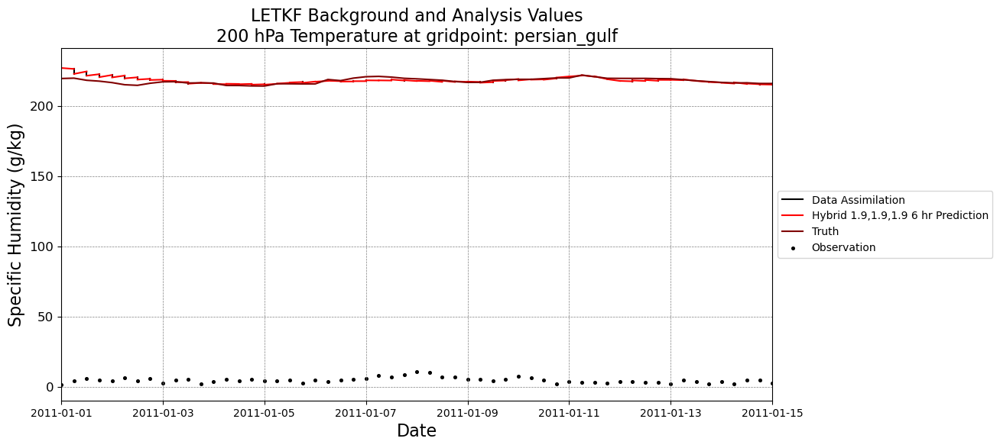

V-wind
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = V-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

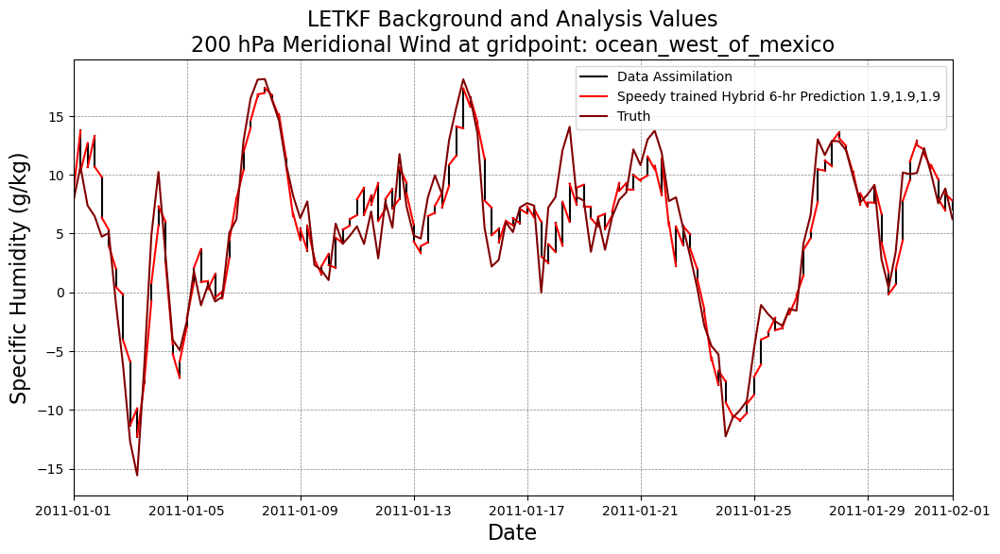

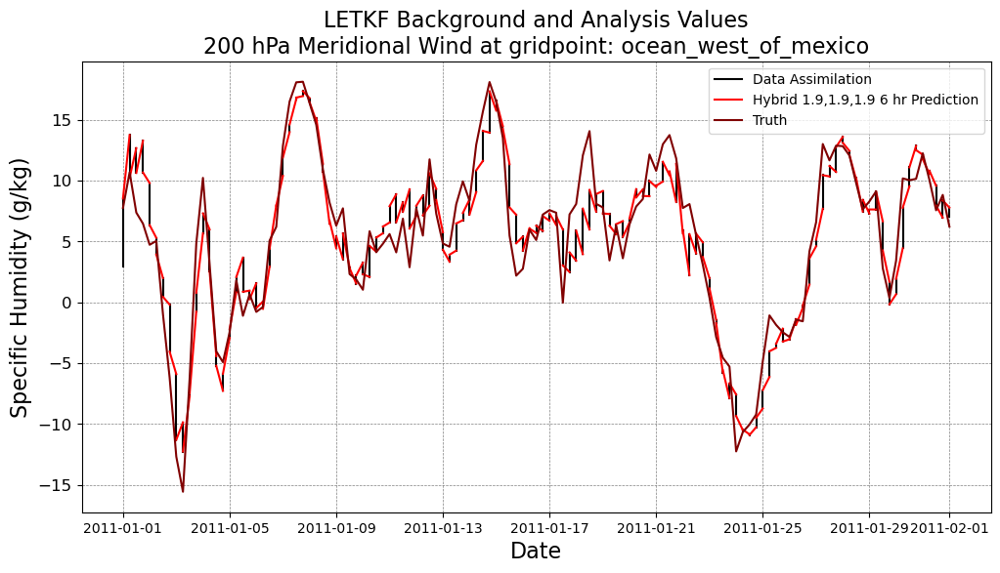

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

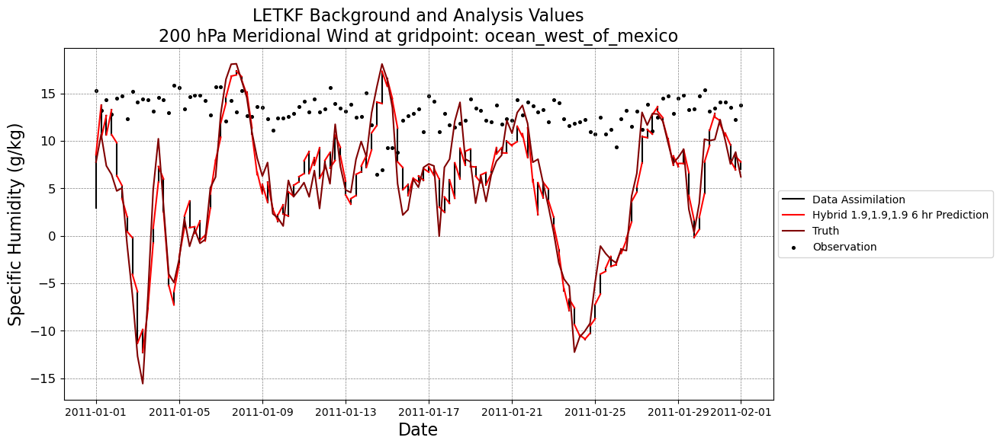

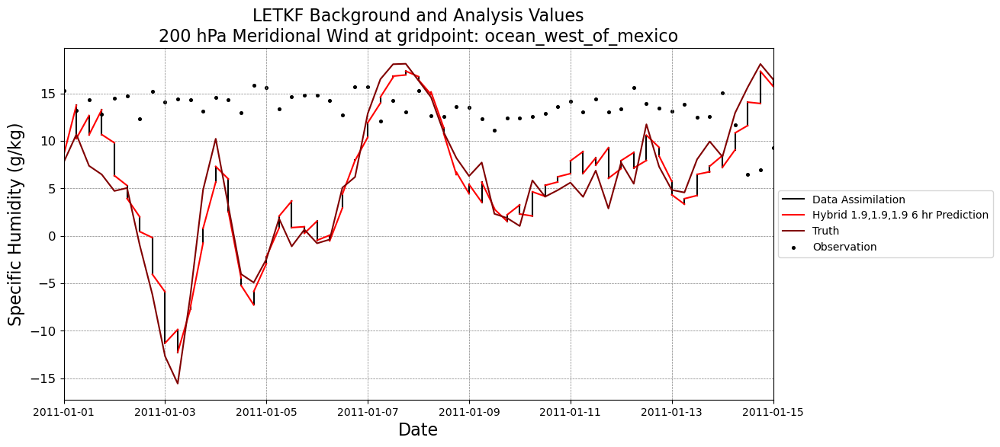

V-wind
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = V-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

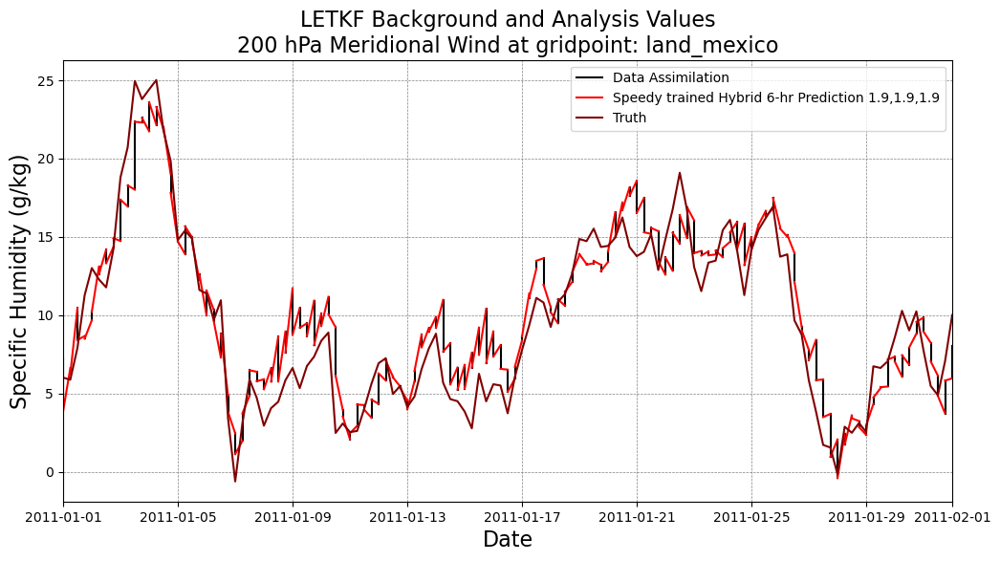

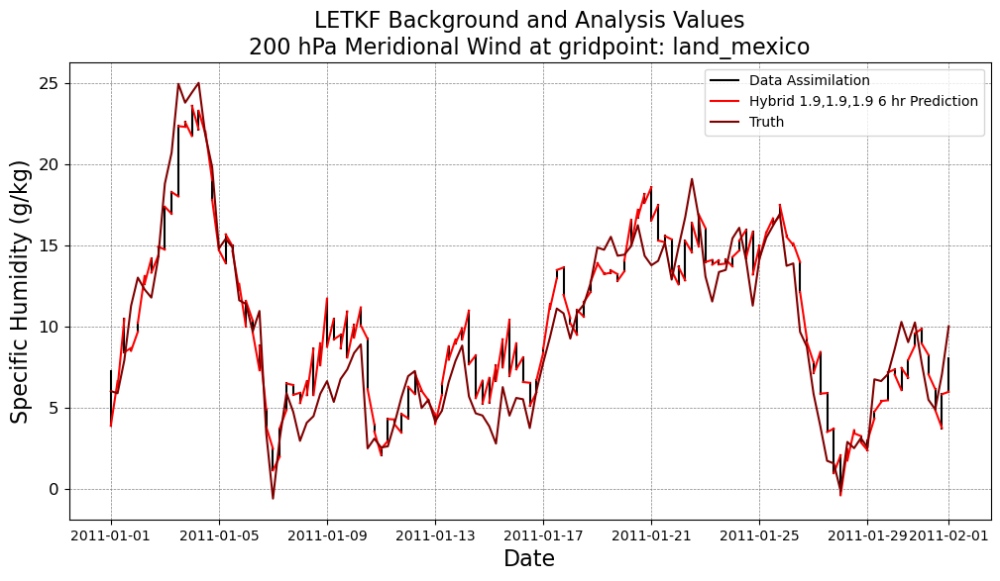

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

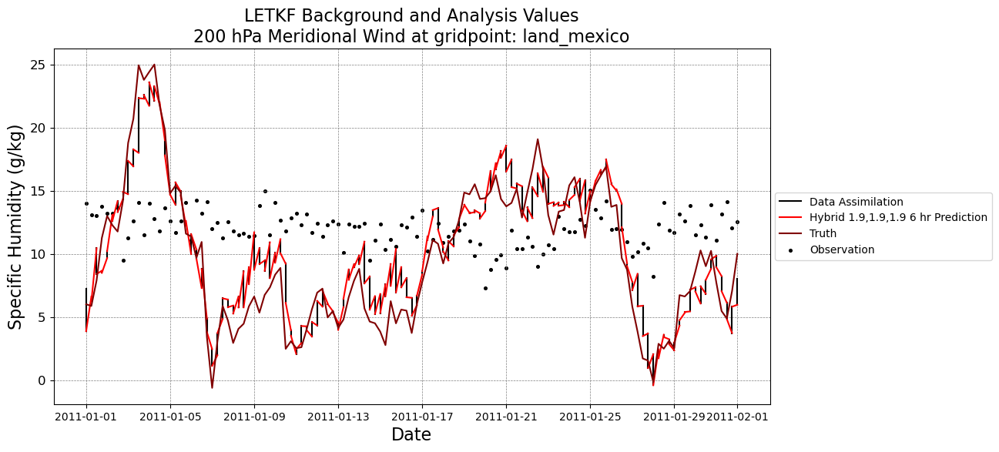

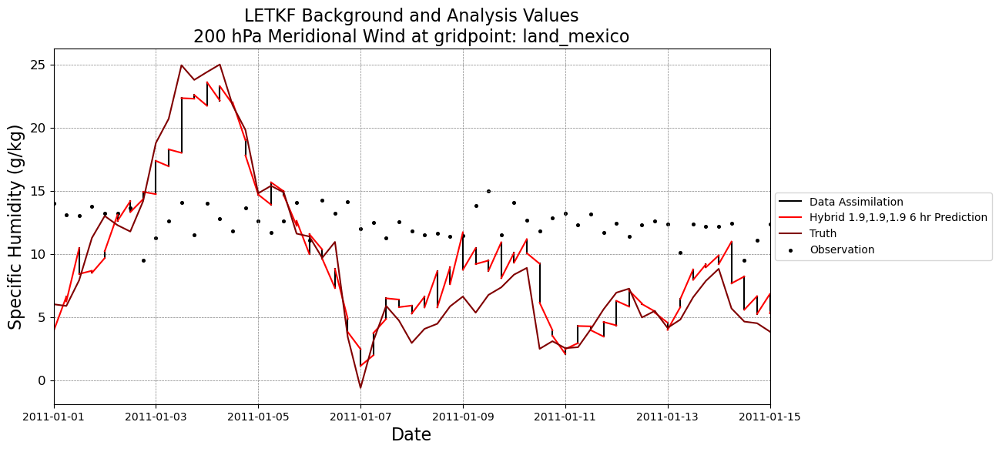

V-wind
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = V-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

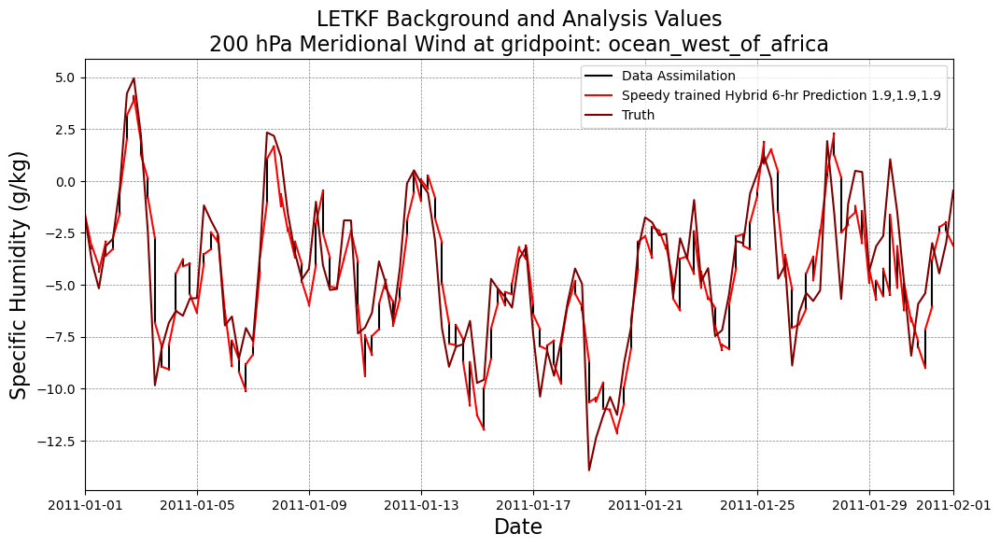

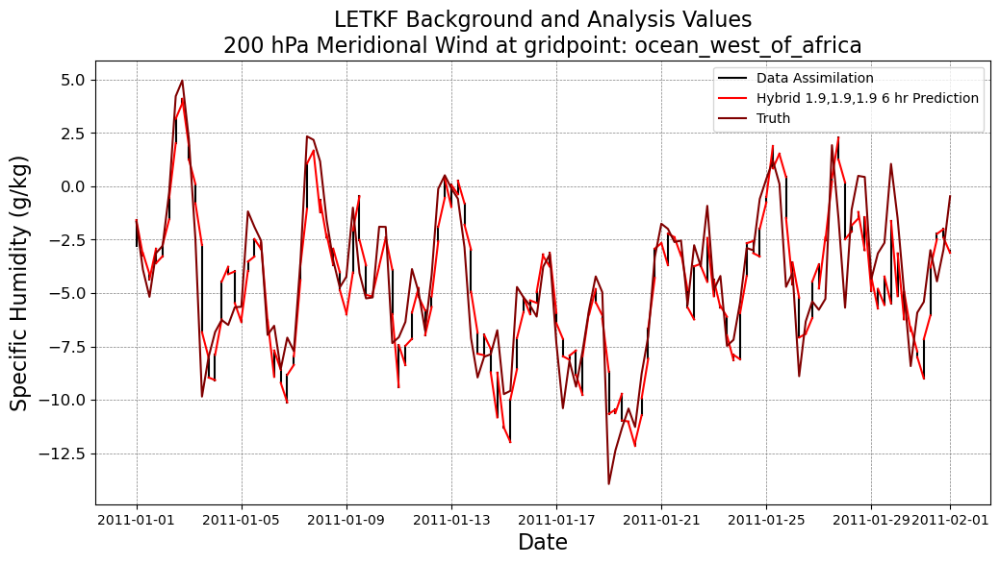

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

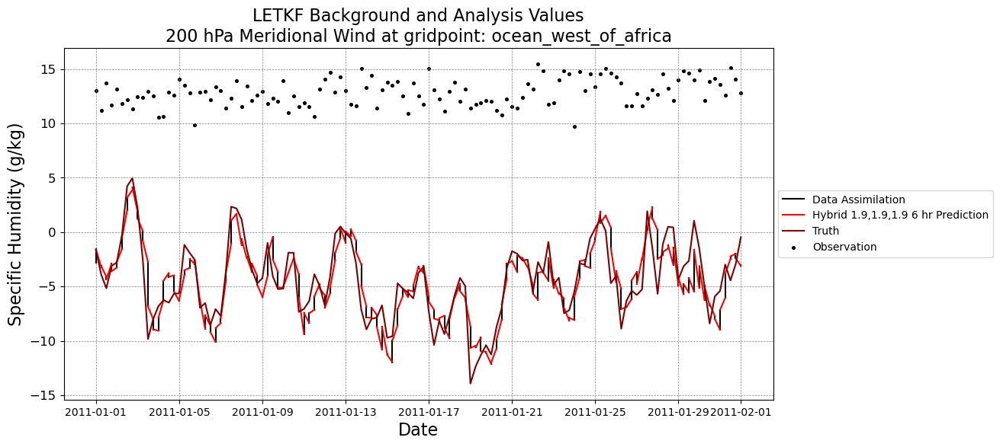

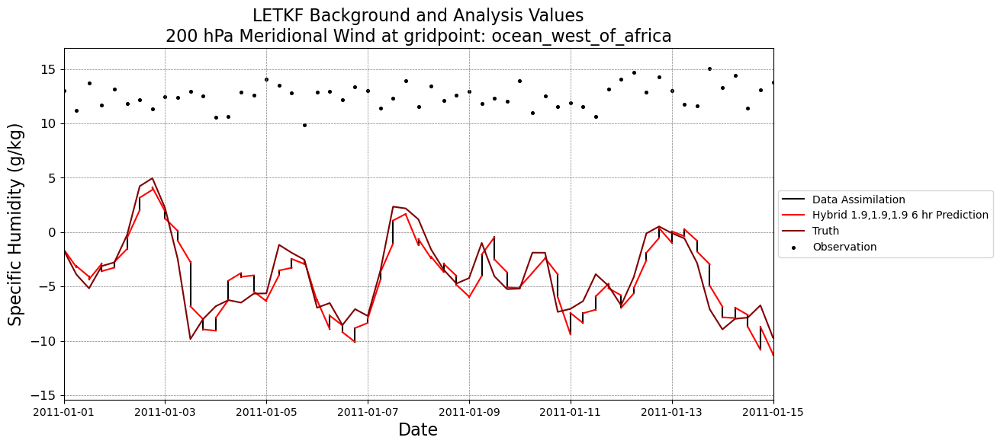

V-wind
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = V-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

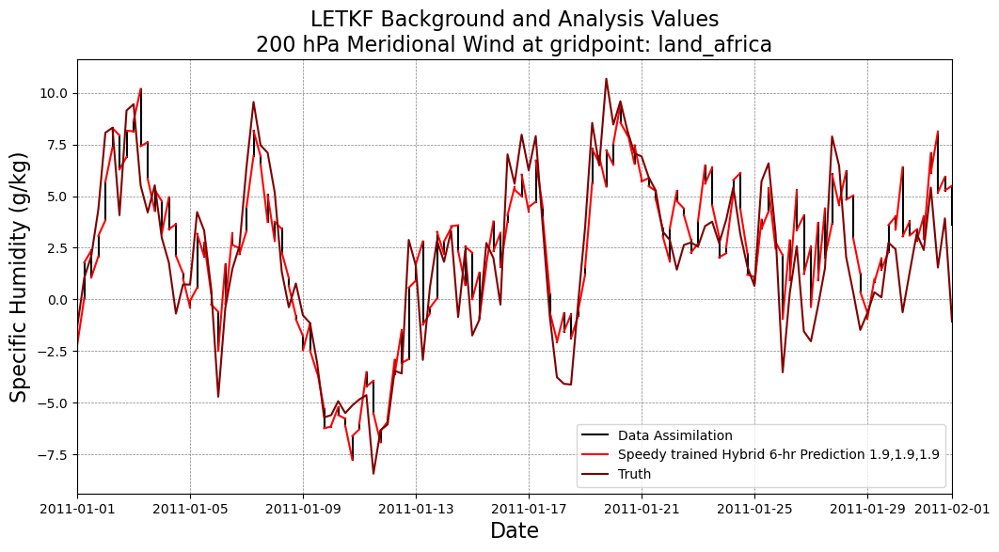

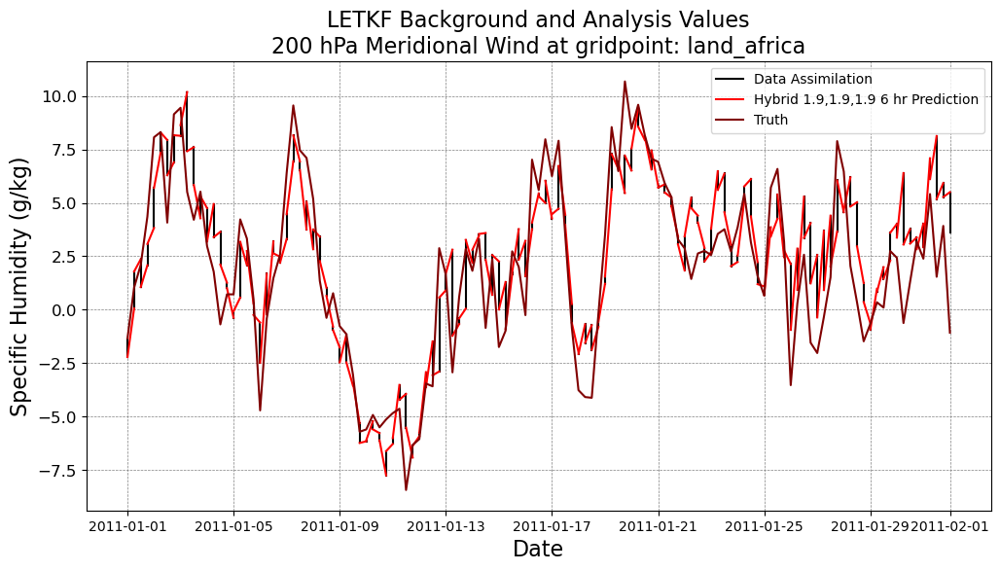

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

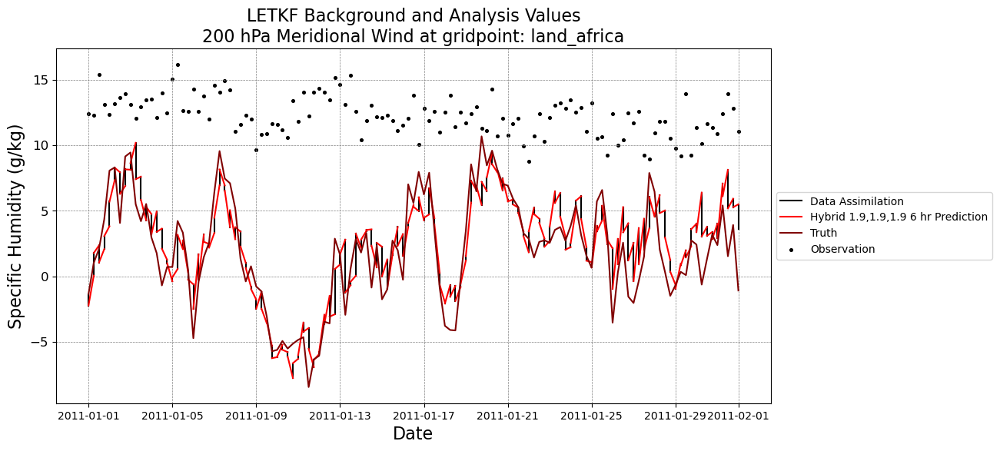

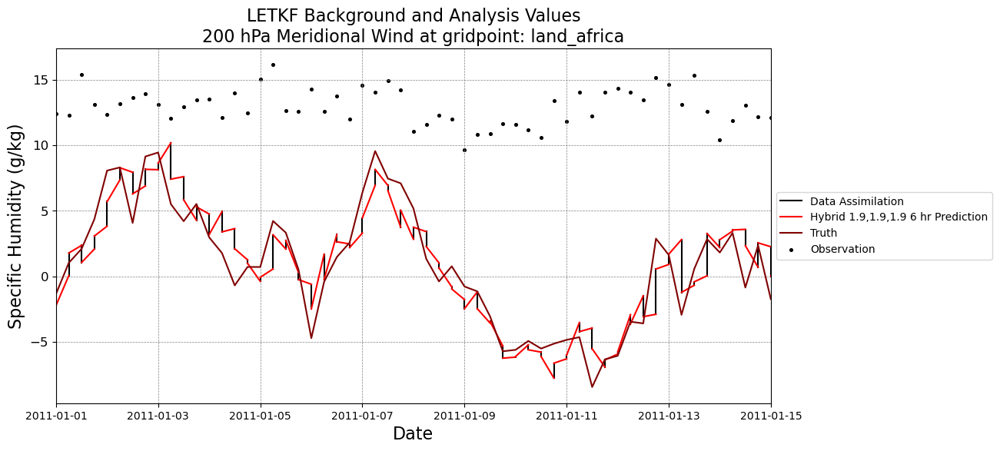

V-wind
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = V-wind
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = V-wind
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(m/s)
Meridional Wind
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

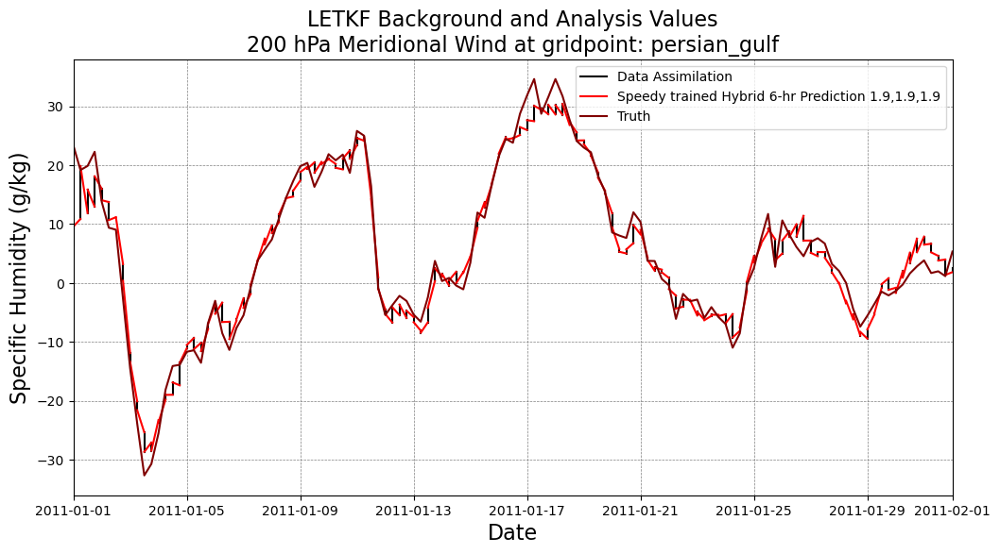

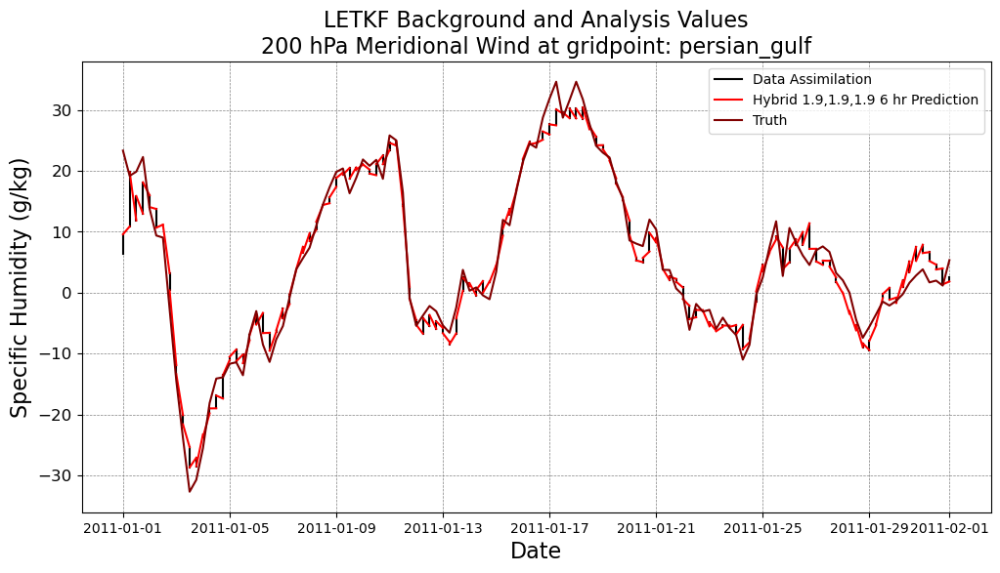

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011011918.dat
Processing 76 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/

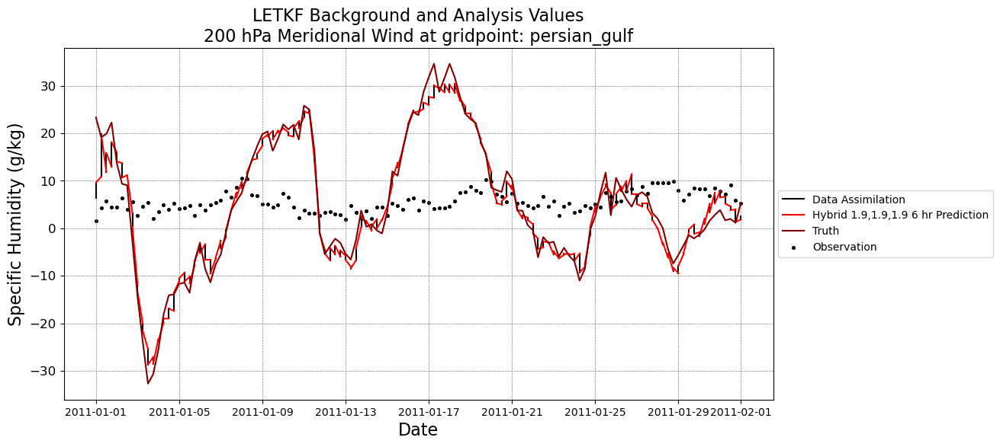

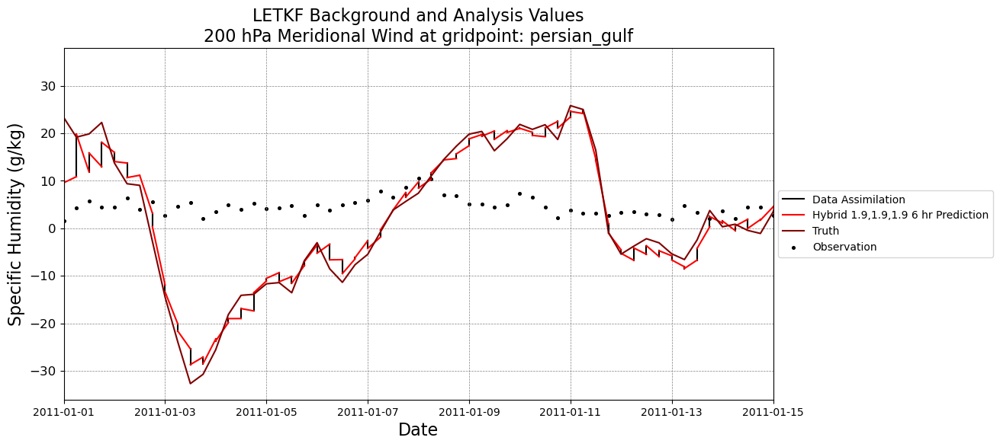

Specific_Humidity
point selected was:  ocean_west_of_mexico
Coordinates: 66 27
you selected for variable = Specific_Humidity
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

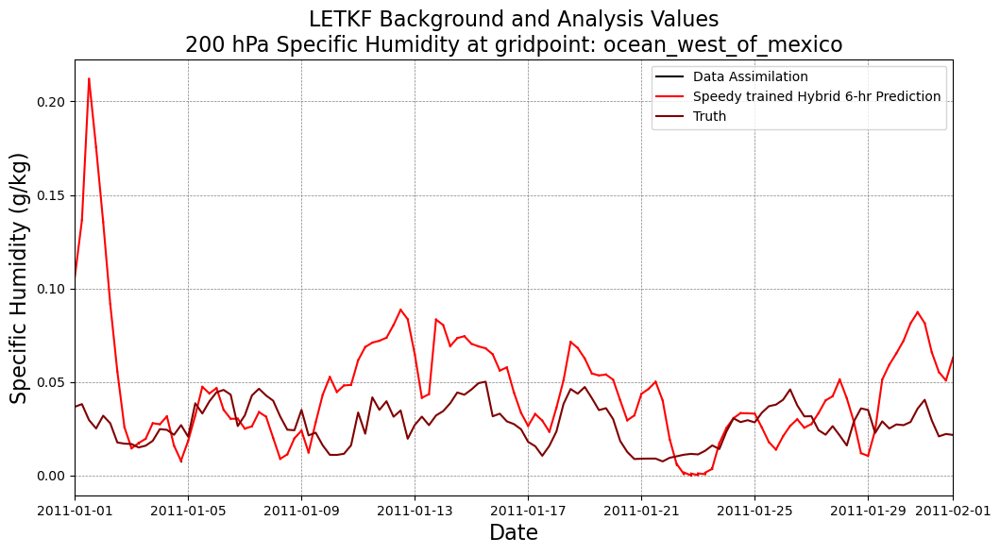

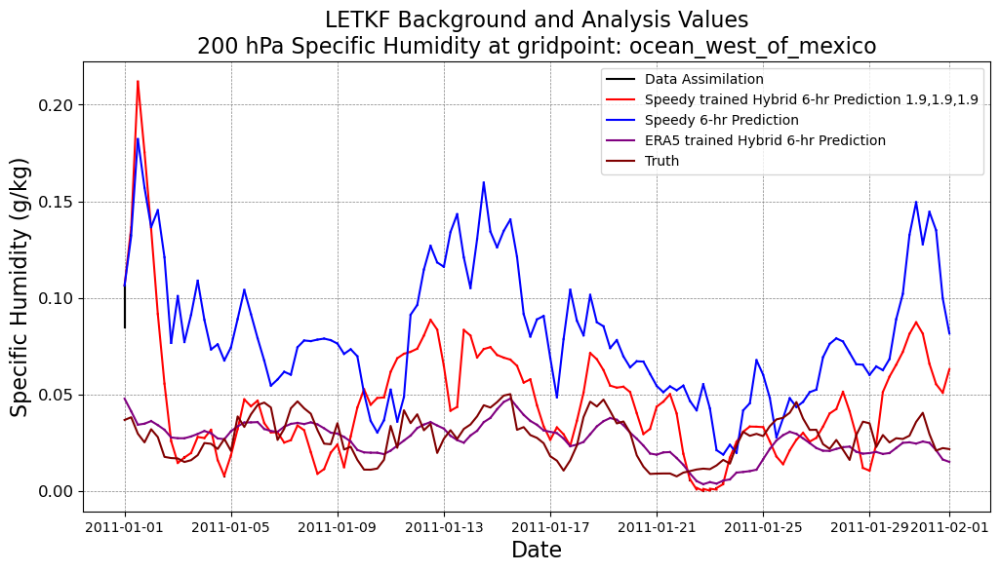

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012206.dat
Processing 86 of 1460 timesteps
/skydata2/

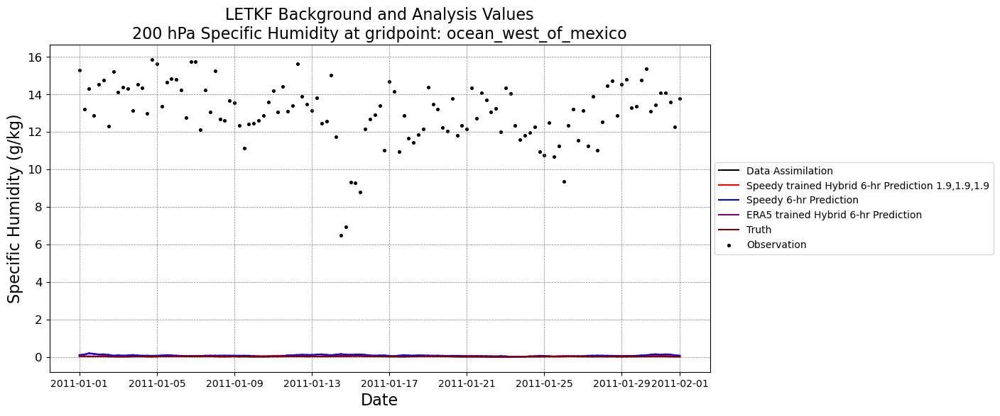

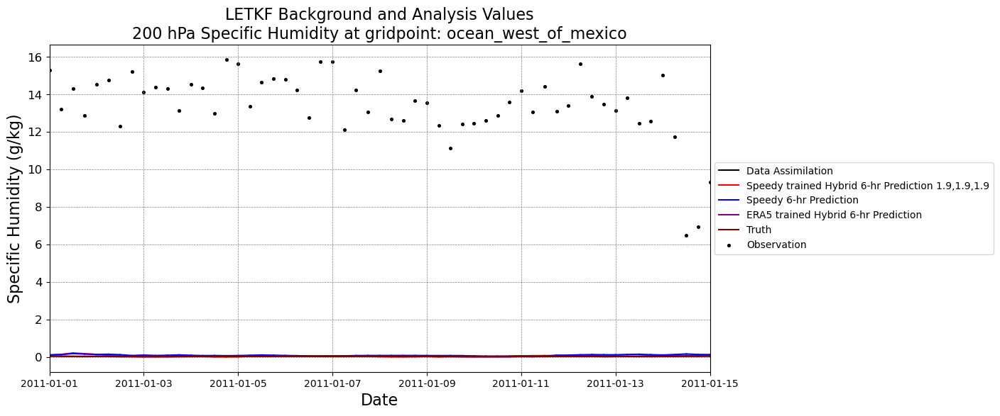

Specific_Humidity
point selected was:  land_mexico
Coordinates: 71 27
you selected for variable = Specific_Humidity
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

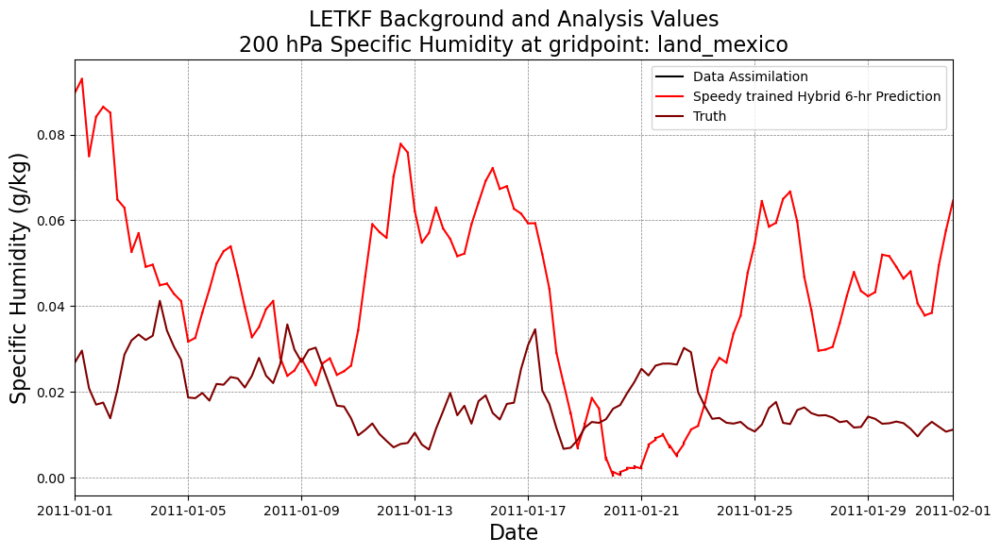

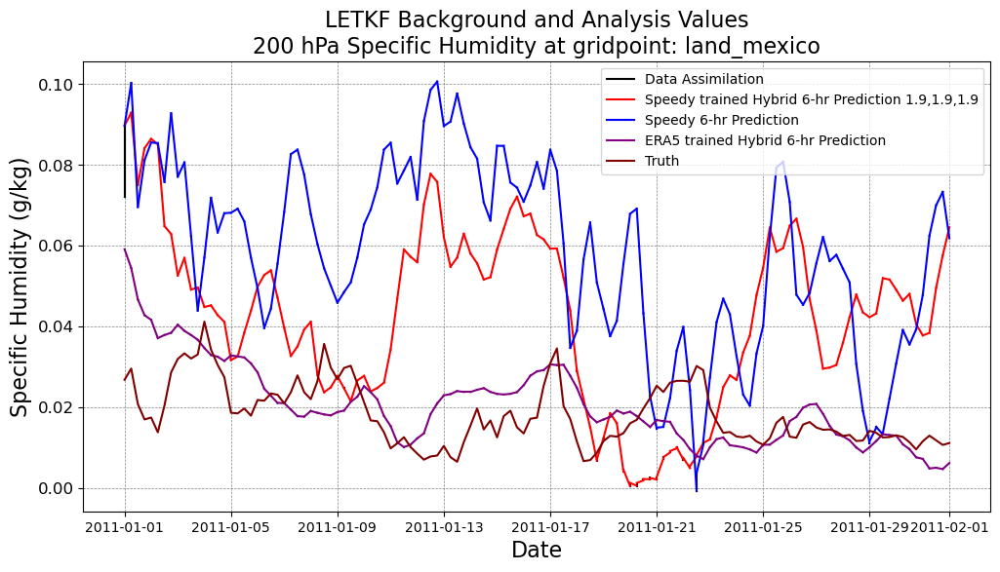

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

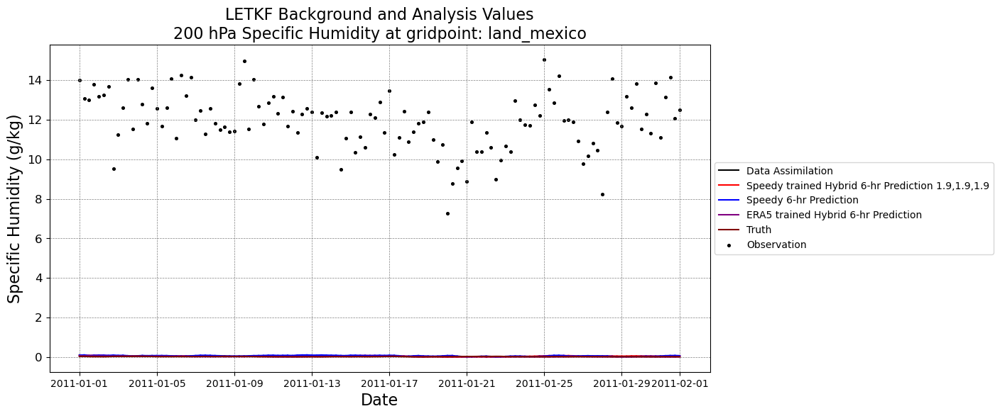

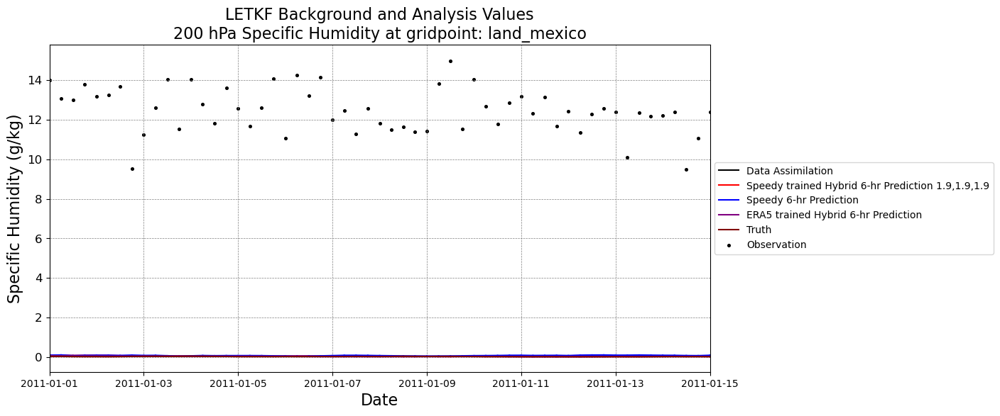

Specific_Humidity
point selected was:  ocean_west_of_africa
Coordinates: 0 20
you selected for variable = Specific_Humidity
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

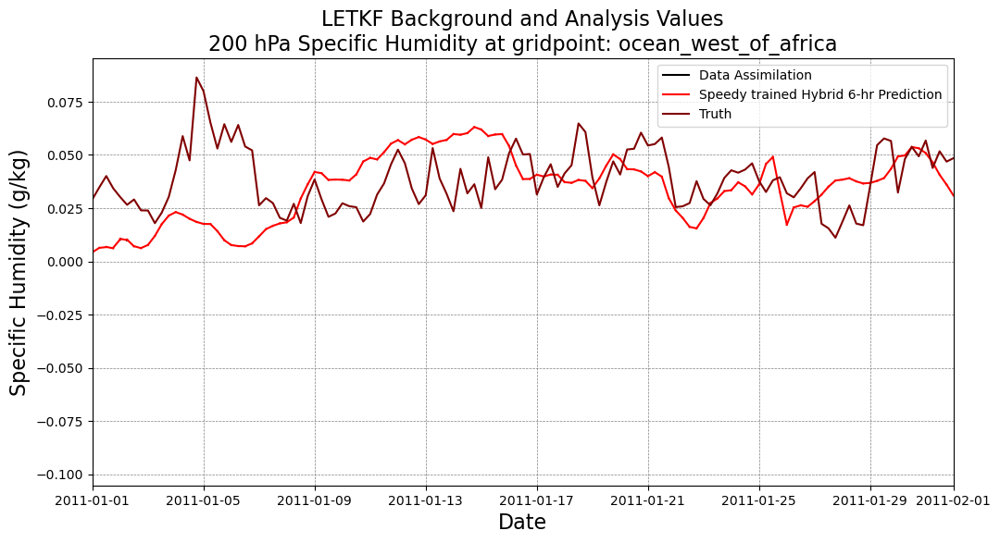

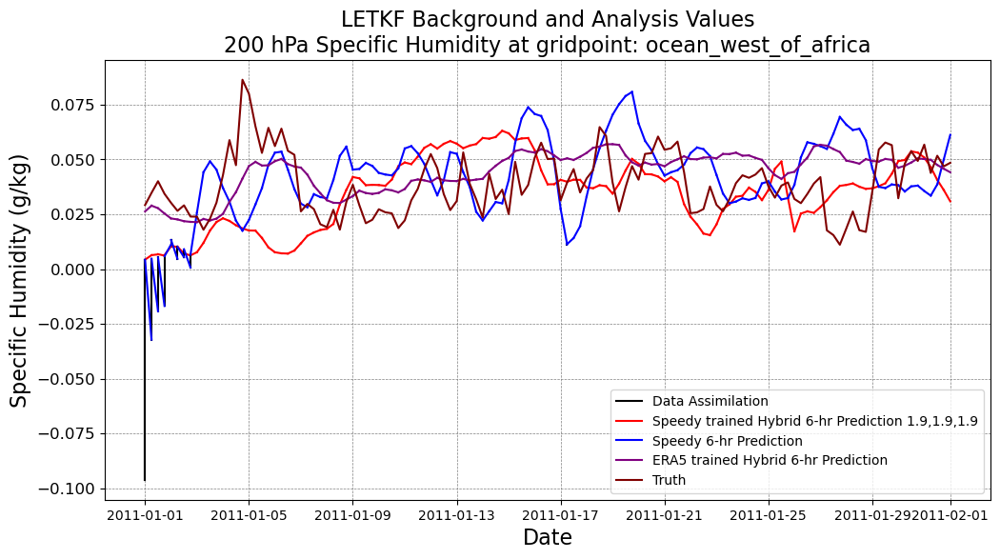

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

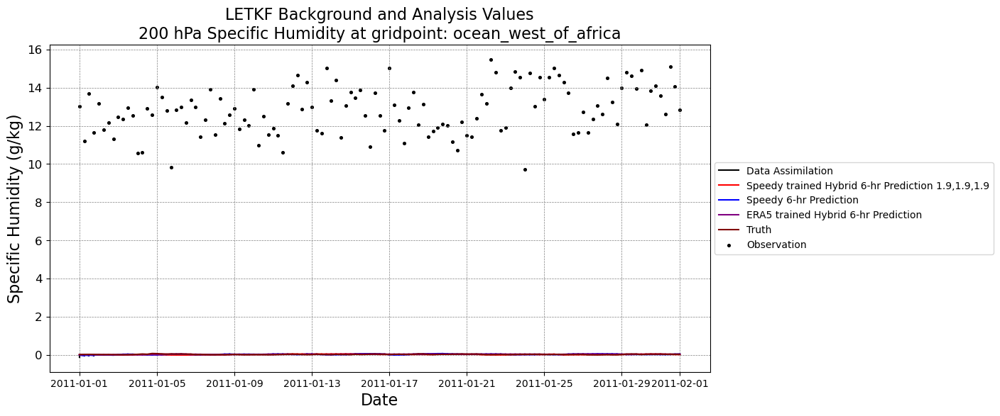

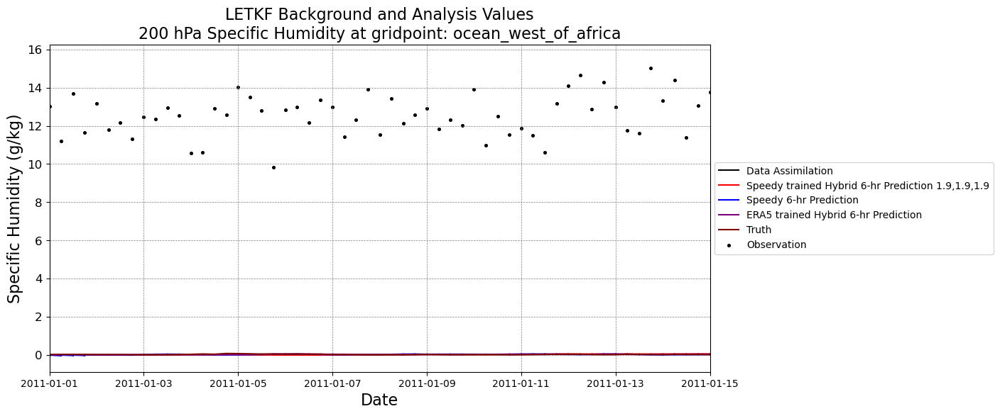

Specific_Humidity
point selected was:  land_africa
Coordinates: 5 20
you selected for variable = Specific_Humidity
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

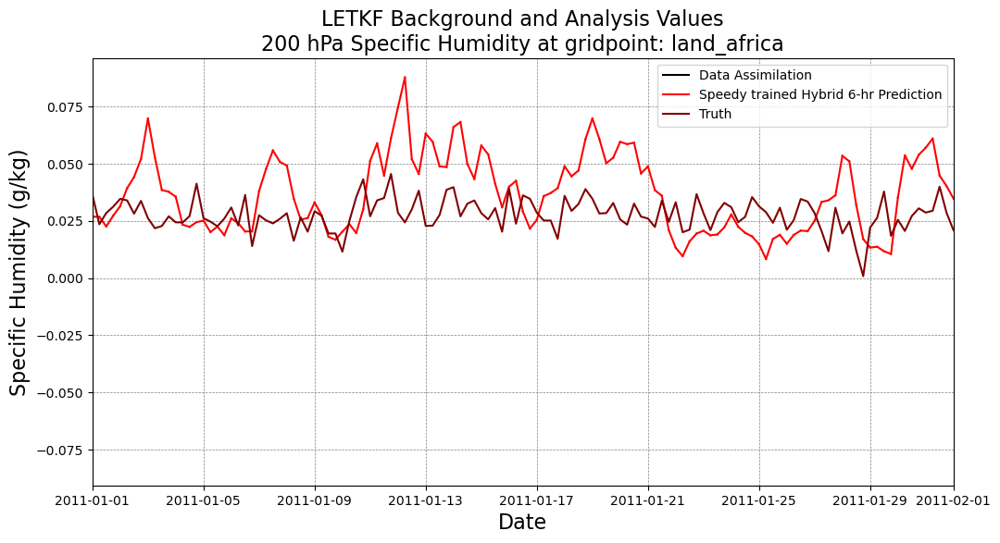

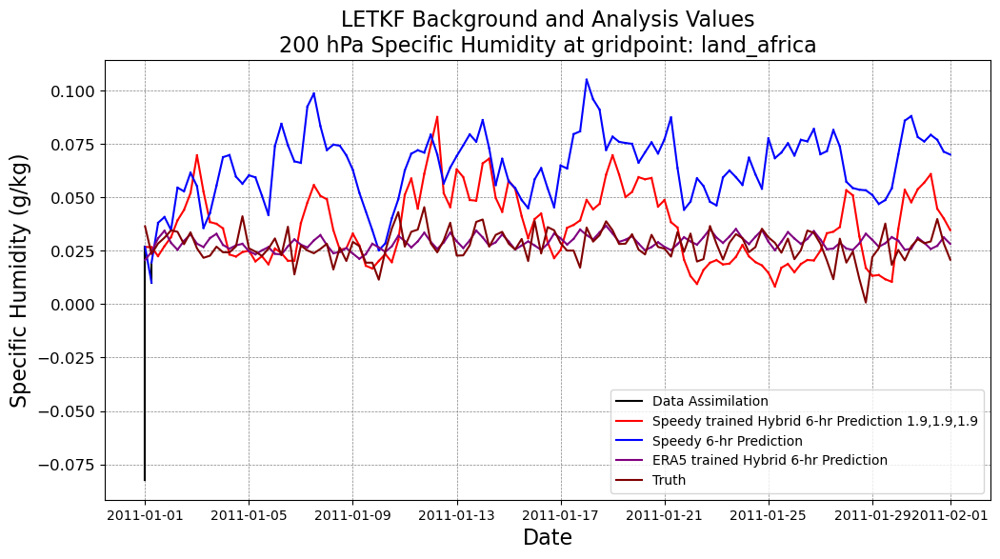

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

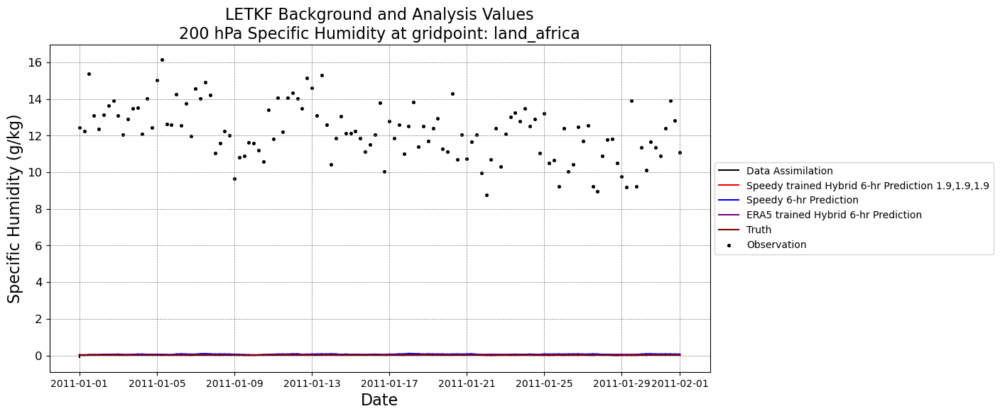

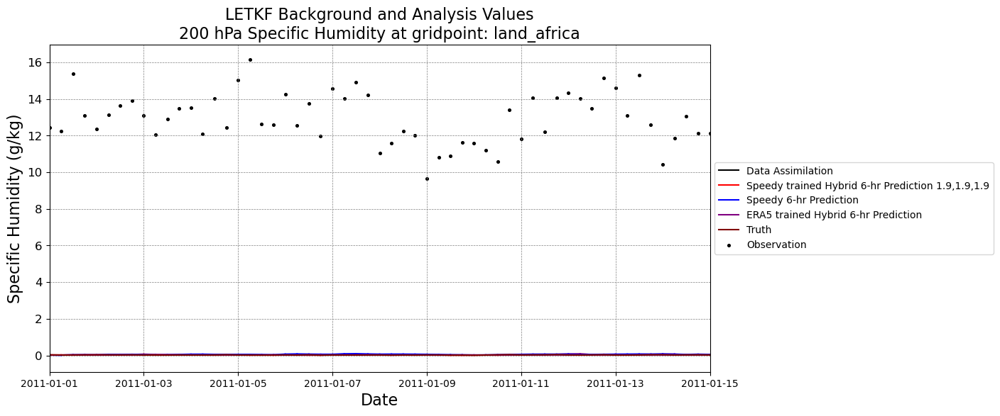

Specific_Humidity
point selected was:  persian_gulf
Coordinates: 13 30
you selected for variable = Specific_Humidity
at level = 0.2
number of timesteps i found..  125
made it to the for loop...
LOADING DATA...
Now its concatinating them all together...
Done concat and sortby Timestep...
era5 shape =  (125, 48, 96)
speedy shape =  (125, 48, 96)
hybrid shape =  (125, 48, 96)
speedy_index  125
nature_index  125
hybrid_index  125
the smallest length is 125
(125, 48, 96)
(125, 48, 96)
Now its calculating analysis RMSE...
DONE CALCULATING ERROR AT EVERY GRIDPOINT AT EVERY TIMESTEP..
you selected for variable = Specific_Humidity
at level = 0.2
MAKING zeros arrays..
Done with ensemble analysis (if any).
(g/kg)
Specific Humidity
looping through hybrid 1.3,1.3 ..


<Figure size 1200x600 with 0 Axes>

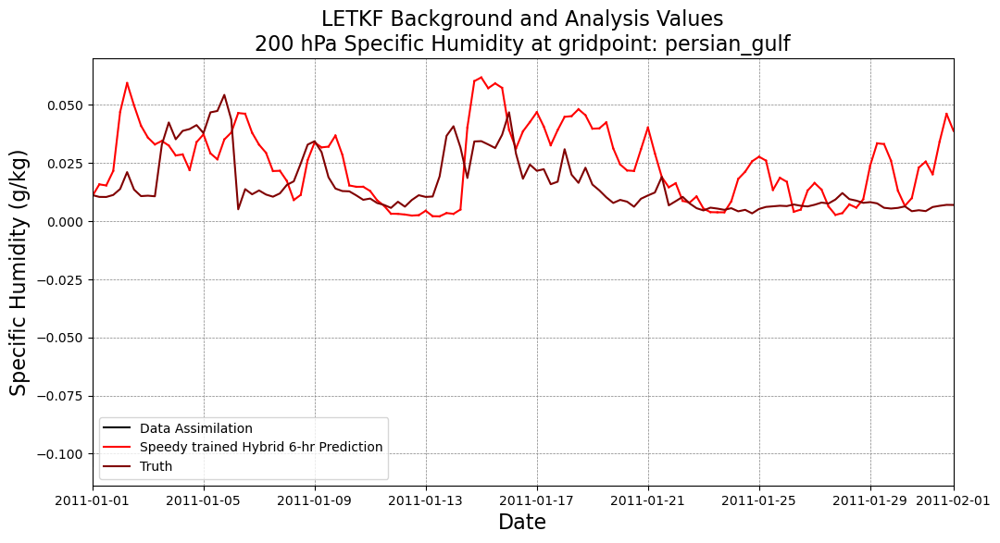

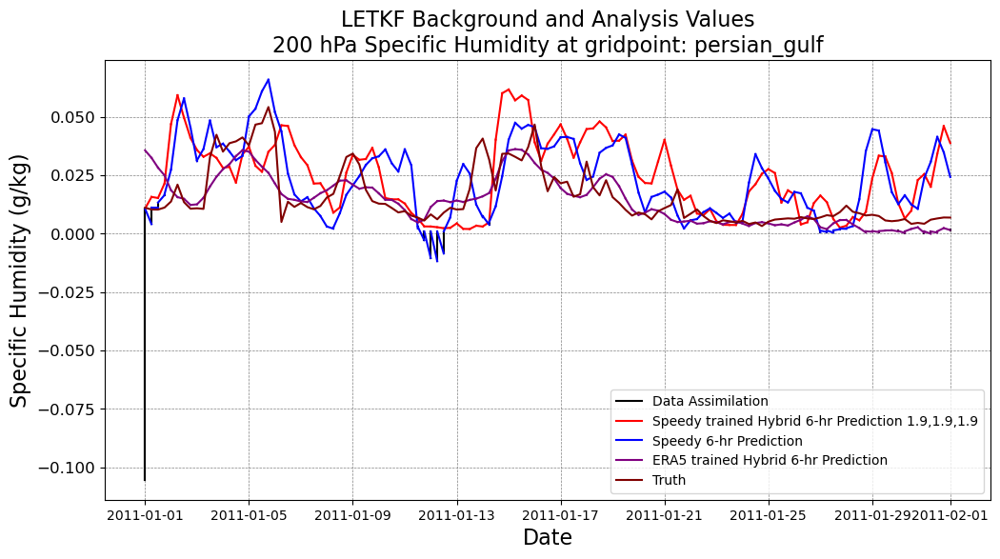

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010100.dat
Processing 1 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010106.dat
Processing 2 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010112.dat
Processing 3 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010118.dat
Processing 4 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010200.dat
Processing 5 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010206.dat
Processing 6 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010212.dat
Processing 7 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010218.dat
Processing 8 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011010300.dat
Processing 9 of 1460 timesteps
/skydata2/dylanelli

/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012000.dat
Processing 77 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012006.dat
Processing 78 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012012.dat
Processing 79 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012018.dat
Processing 80 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012100.dat
Processing 81 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012106.dat
Processing 82 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012112.dat
Processing 83 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012118.dat
Processing 84 of 1460 timesteps
/skydata2/dylanelliott/letkf-hybrid-speedy/DATA/obs_netcdftest/2011012200.dat
Processing 85 of 1460 timesteps
/skydata2/

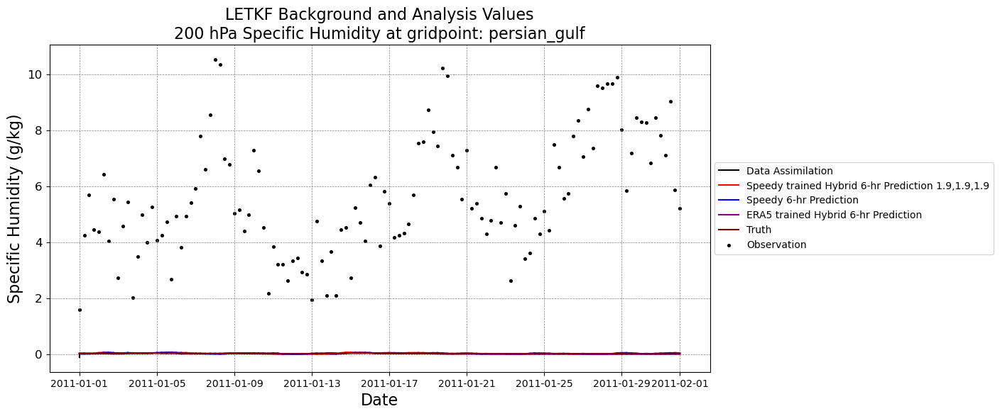

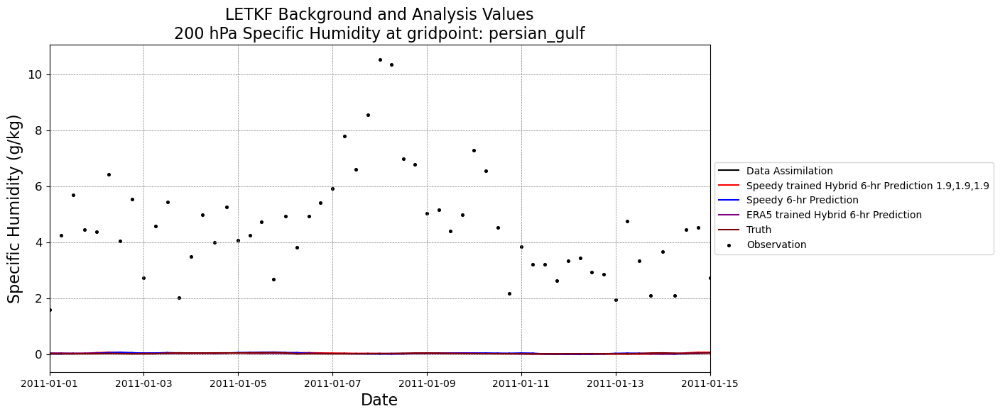

In [11]:
## works!
## need to change file and dates in function above before running this cell


## LOOP THROUGH FUNCTION

# FUNCTION INPUTS

level_list_speedy = [.95,.2]
variable_list_speedy = ['u','t','v','q']

points = ['ocean_west_of_mexico','land_mexico','ocean_west_of_africa','land_africa','persian_gulf']

for level in level_list_speedy:
    for variable in variable_list_speedy:
        for point in points:
            rmse_time_series_plot_and_maps(level,variable,point)

